# Tải dữ liệu

In [1]:
!gdown 1rIkQWBMmaW-kqH9xM7ZciTUSG6P28wTY
!unzip /content/signals.zip

Downloading...
From: https://drive.google.com/uc?id=1rIkQWBMmaW-kqH9xM7ZciTUSG6P28wTY
To: /content/signals.zip
100% 6.74M/6.74M [00:00<00:00, 178MB/s]
Archive:  /content/signals.zip
   creating: signals/
   creating: signals/NguyenAmHuanLuyen-16k/
   creating: signals/NguyenAmHuanLuyen-16k/23MTL/
  inflating: signals/NguyenAmHuanLuyen-16k/23MTL/a.wav  
  inflating: signals/NguyenAmHuanLuyen-16k/23MTL/e.wav  
  inflating: signals/NguyenAmHuanLuyen-16k/23MTL/i.wav  
  inflating: signals/NguyenAmHuanLuyen-16k/23MTL/o.wav  
  inflating: signals/NguyenAmHuanLuyen-16k/23MTL/u.wav  
   creating: signals/NguyenAmHuanLuyen-16k/24FTL/
  inflating: signals/NguyenAmHuanLuyen-16k/24FTL/a.wav  
  inflating: signals/NguyenAmHuanLuyen-16k/24FTL/e.wav  
  inflating: signals/NguyenAmHuanLuyen-16k/24FTL/i.wav  
  inflating: signals/NguyenAmHuanLuyen-16k/24FTL/o.wav  
  inflating: signals/NguyenAmHuanLuyen-16k/24FTL/u.wav  
   creating: signals/NguyenAmHuanLuyen-16k/25MLM/
  inflating: signals/NguyenAmHua

# Bài 1 - Vẽ ảnh phổ

In [2]:
config = {
  "train_path":"signals/NguyenAmHuanLuyen-16k",
  "valid_path":"signals/NguyenAmKiemThu-16k",
}


In [3]:
import os
import glob
import scipy
import numpy as np
import librosa

class SignalDataset():
  def __init__(self, data_directory):
    self.audio_paths = self.load(data_directory)

  def __getitem__(self, idx):
    audio_path = self.audio_paths[idx]

    # ==== get label =====================
    filename = os.path.basename(audio_path)
    label = filename.split(".")[0]
    # ====================================

    # ==== read data =====================
    y, fs = librosa.load(audio_path, sr = None)
    # ====================================

    # === get human say ==================
    human = self.audio_paths[idx].split("/")[-2]
    # ====================================

    return (fs, y, y.shape[0] / fs), human , label

  def __len__(self):
    return len(self.audio_paths)

  def load(self, data_directory):
    audio_paths = []
    for audio_path in glob.glob(data_directory+"/**/*.wav"):
        audio_paths.append(audio_path)
    return audio_paths

In [4]:
import os
print(os.listdir(config["train_path"]))

['45MDV', '34MQP', '32MTP', '23MTL', '44MTT', '28MVN', '38MDS', '35MMQ', '39MTS', '29MHN', '24FTL', '40MHS', '41MVS', '33MHP', '25MLM', '36MAQ', '27MCM', '30FTN', '37MDS', '42FQT', '43MNT']


In [5]:
train_data = SignalDataset(config["train_path"])
valid_data = SignalDataset(config["valid_path"])

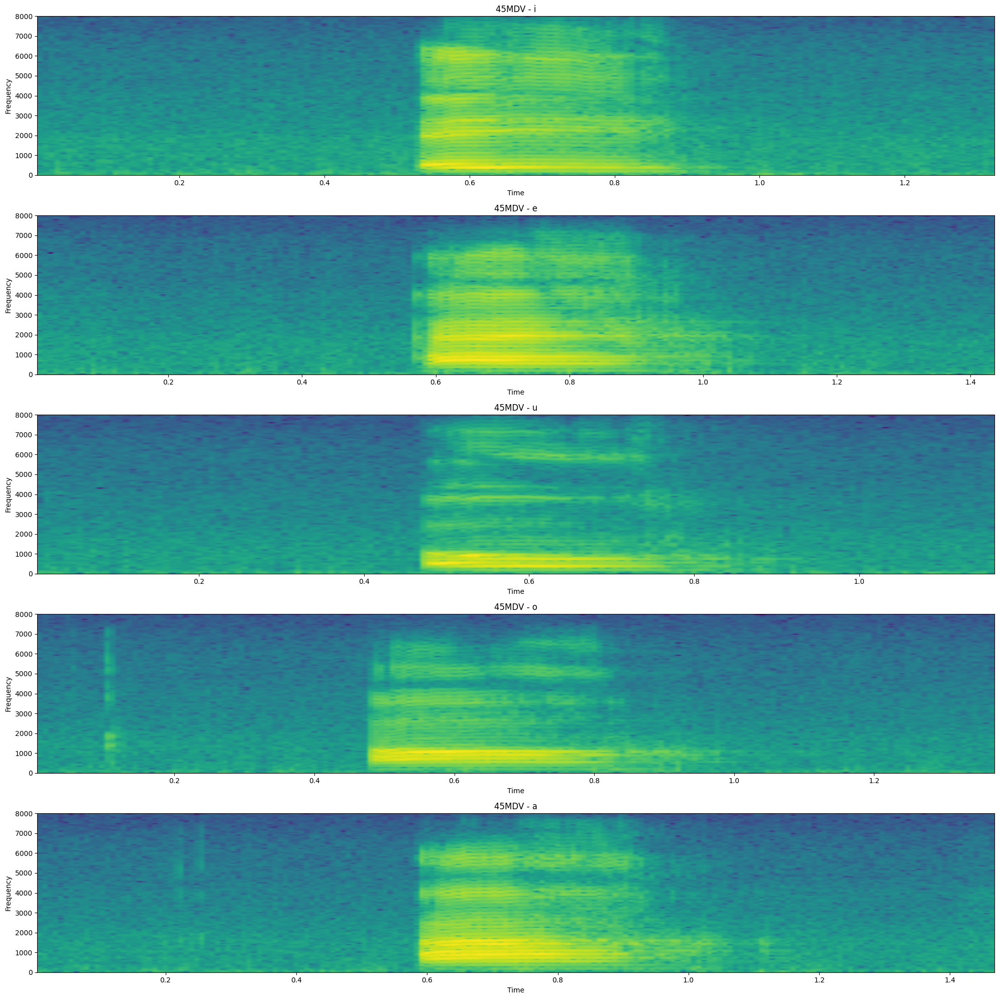

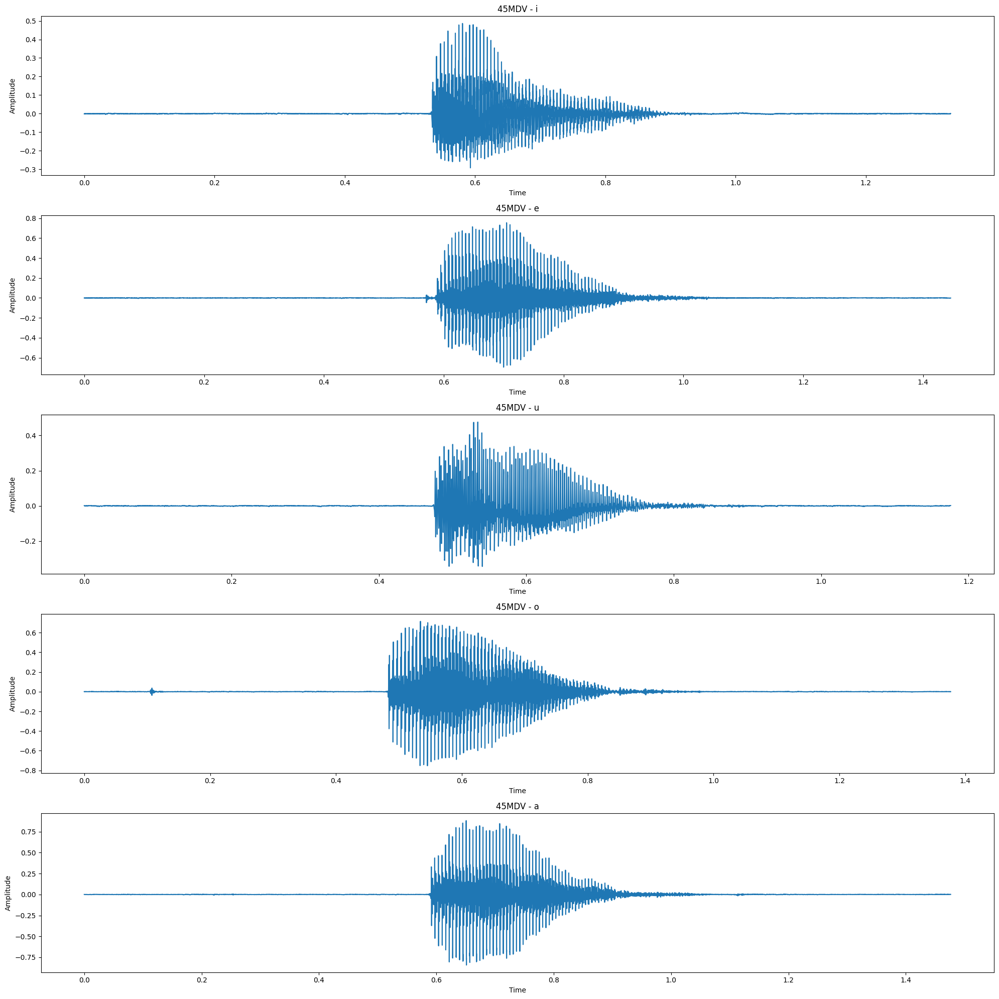

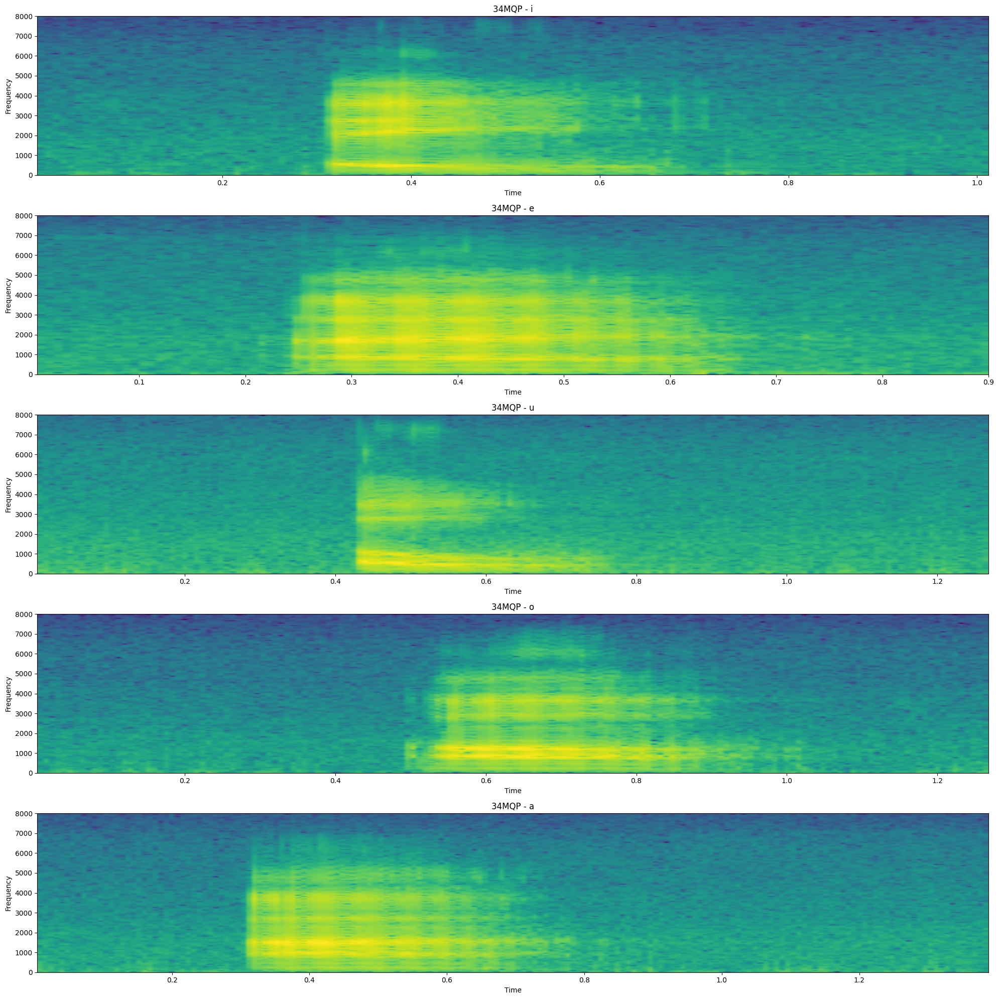

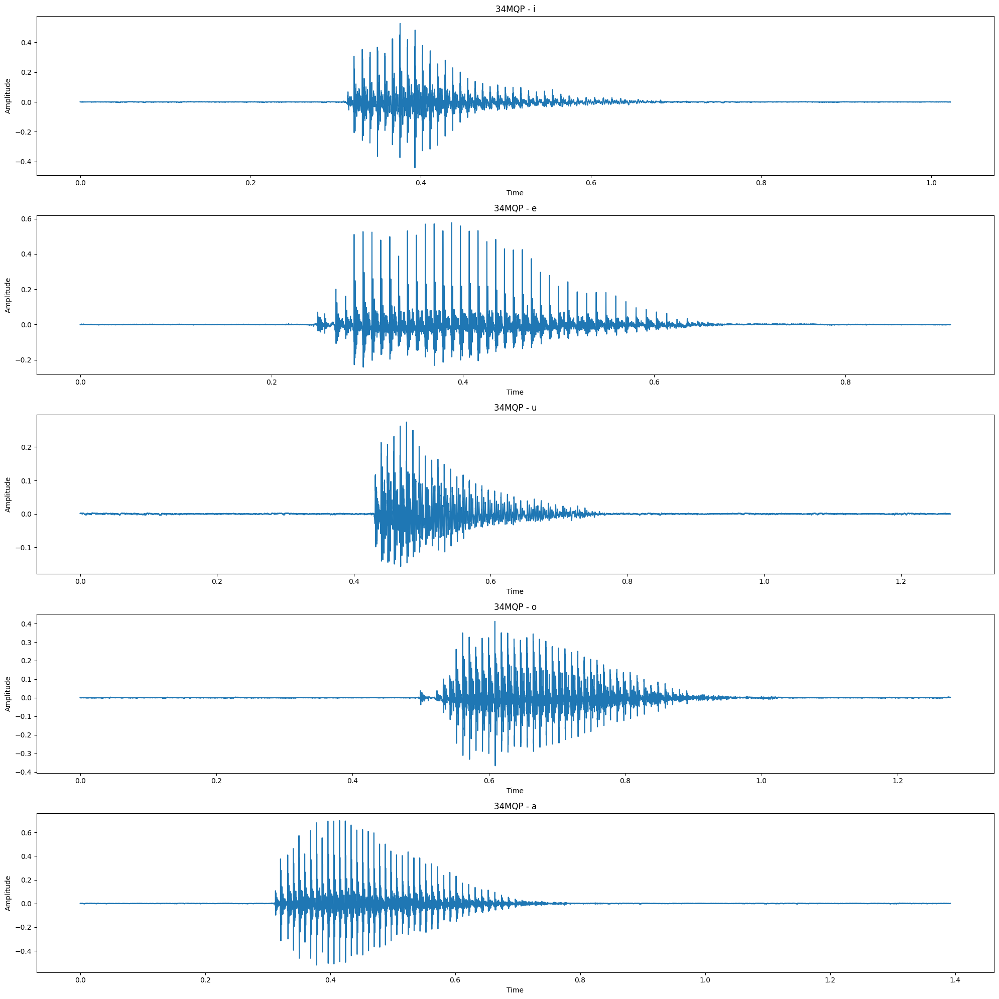

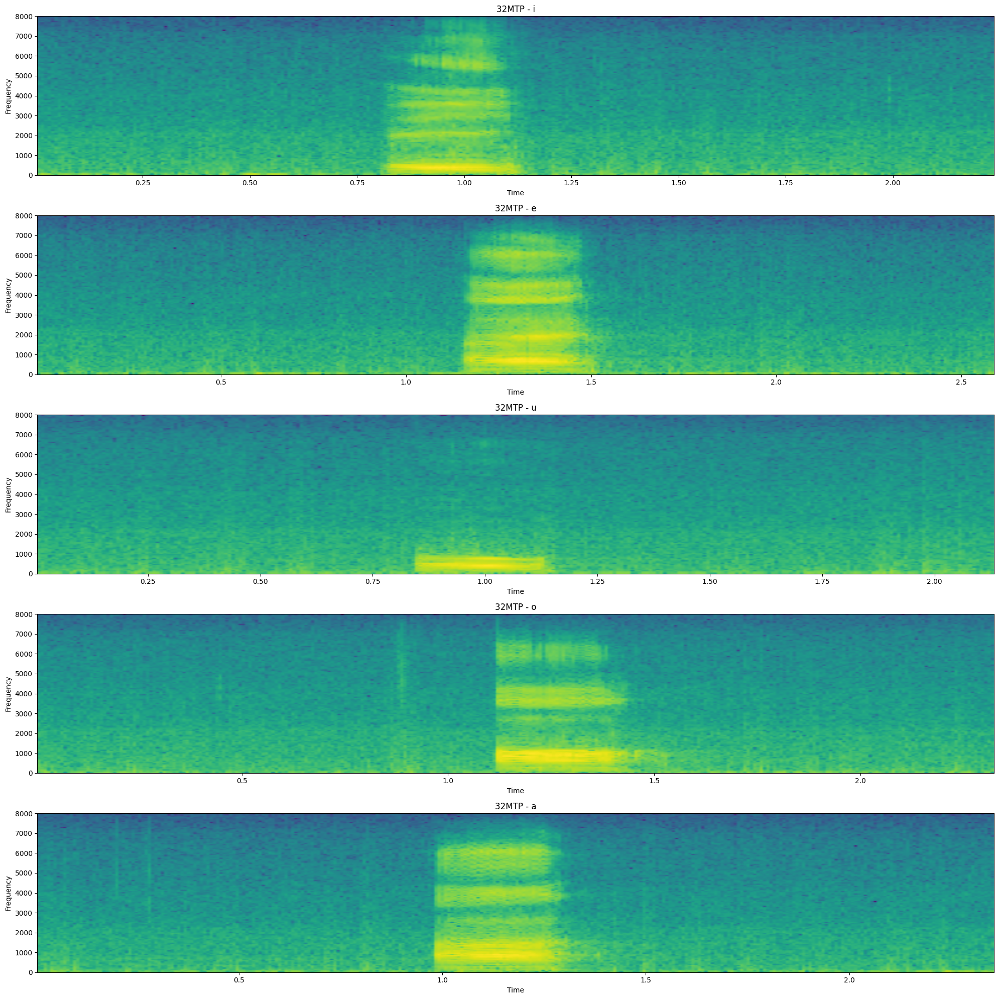

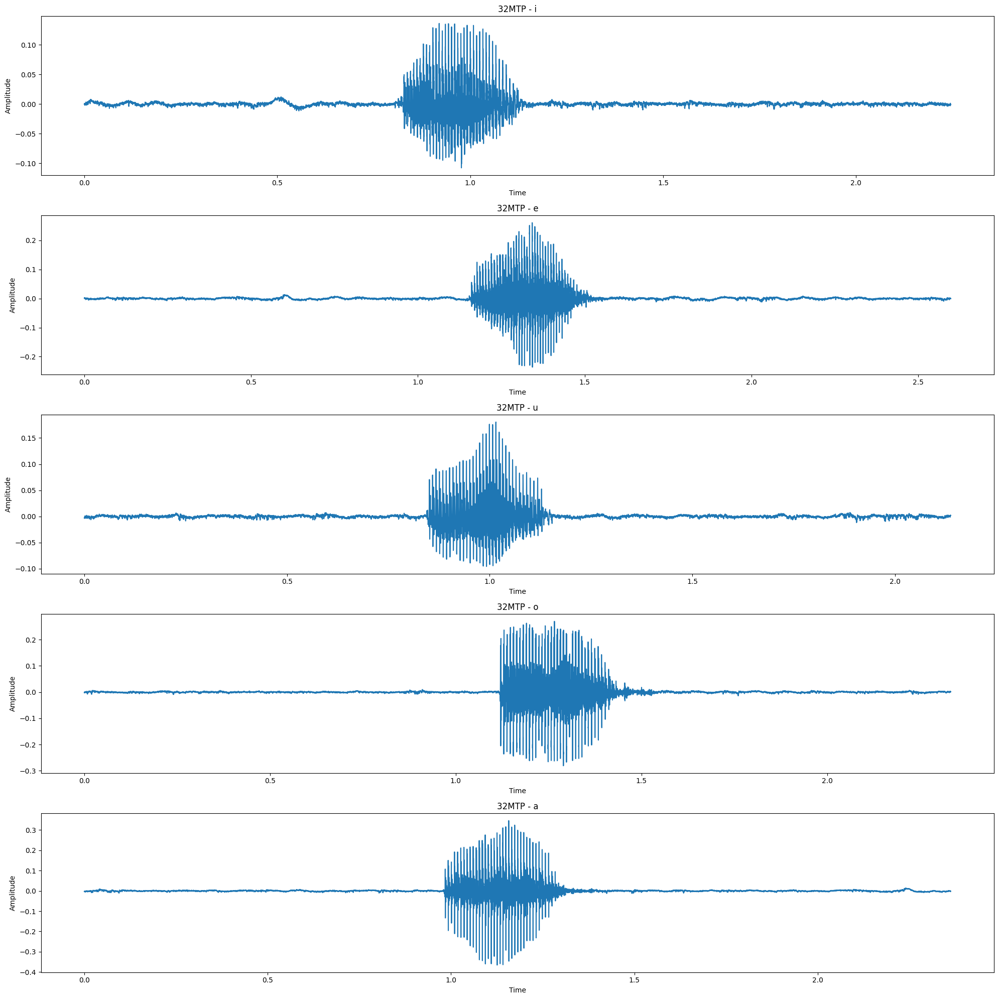

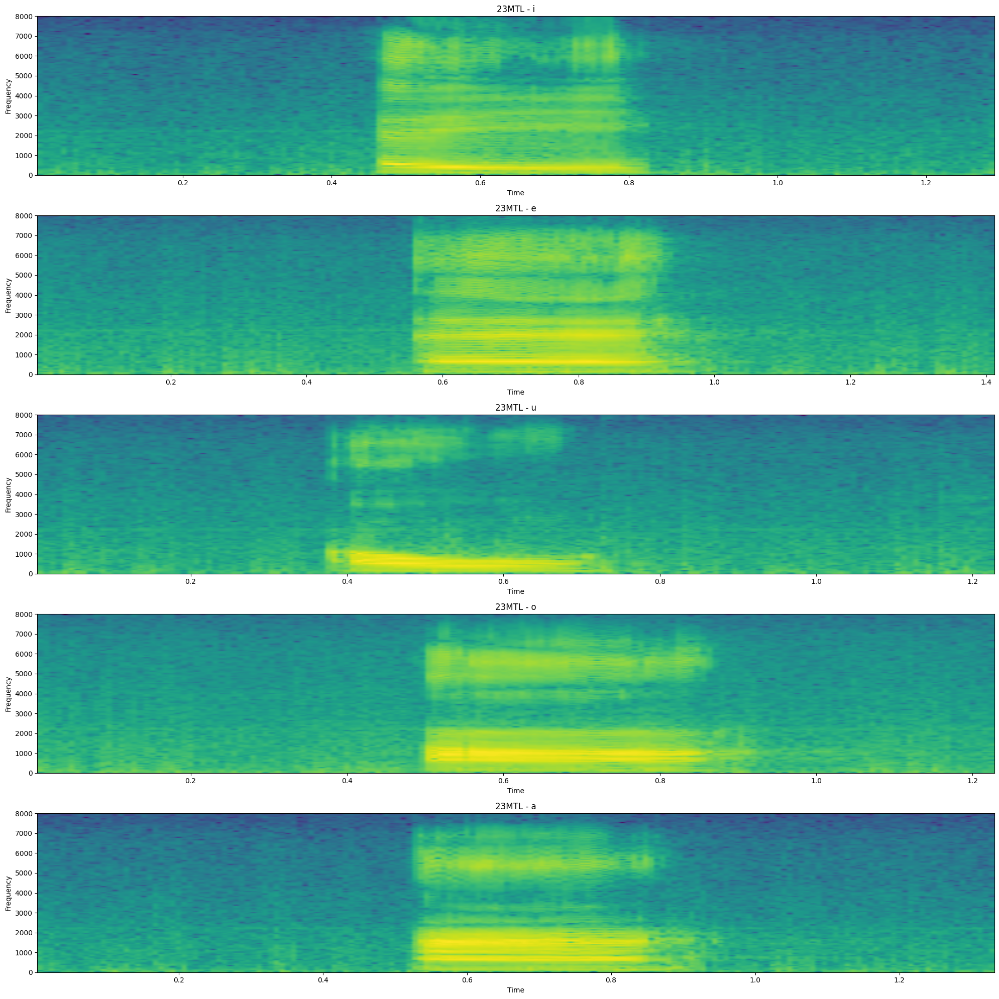

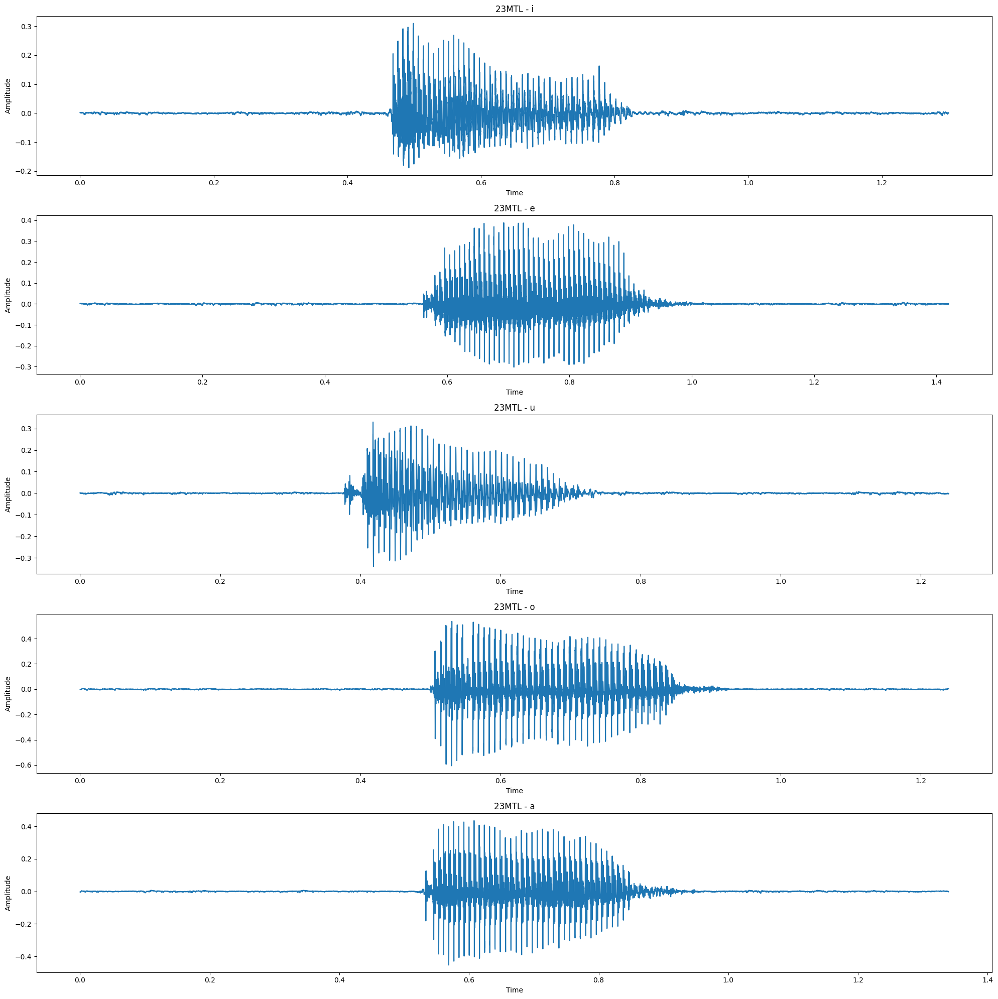

In [6]:
%matplotlib inline
import matplotlib.pyplot as plt
plt.rcParams["figure.figsize"] = (20,20)

human_nums = 4
for i in range (human_nums):
  fig, axs = plt.subplots(5)
  fig.figsize = (20,30)

  for (j) in range(5):
    (sample_rate, data, length), human,label = train_data[j + i * 5]
    time = np.linspace(0., length, data.shape[0])
    axs[j].set_title("{} - {}".format(human, label))
    axs[j].specgram(data, Fs = sample_rate)
    axs[j].set(xlabel='Time', ylabel='Frequency')

  fig.tight_layout()
  fig.show()

  fig, axs = plt.subplots(5)
  fig.figsize = (20,30)
  for (j) in range(5):
    (sample_rate, data, length), human,label = train_data[j + i*5]
    time = np.linspace(0., length, data.shape[0])
    axs[j].set_title("{} - {}".format(human, label))
    axs[j].plot(time, data)
    axs[j].set(xlabel='Time', ylabel='Amplitude')

  fig.tight_layout()
  fig.show()

  plt.show()

# Bài 1 - Ước tính Formant tự động

In [8]:
import os
import librosa
import numpy as np
import matplotlib.pyplot as plt
import scipy
from scipy.signal import lfilter
import glob

In [9]:
config = {
  "train_path":"signals/NguyenAmHuanLuyen-16k",
  "valid_path":"signals/NguyenAmKiemThu-16k",
}

In [10]:
def getSilenceAndSound(file_path):

  # ==== get label =====================
  filename = os.path.basename(file_path)
  # ====================================

  # === get human say ==================
  human = file_path.split("/")[-2]
  # ====================================

  # Load audio file
  y, fs = librosa.load(file_path, sr=None)

  # Calculate Short-Time Energy (STE)
  window_size = 0.03  # Size of the window (30 ms)
  overlap = 0.0  # Overlap between windows (50%)
  ste_threshold = 0.01  # STE threshold for classifying sound and silence

  # Calculate window parameters
  window_length = int(window_size * fs)
  overlap_length = int(overlap * window_length)

  # Calculate STE for each window
  ste = np.zeros_like(y)
  for i in range(0, len(y) - window_length, window_length - overlap_length):
      window = y[i:i + window_length]
      ste[i:i + window_length] = np.sum(window ** 2)

  # Classify sound and silence
  sound_segments = y[ste > ste_threshold]
  silence_segments = y[ste <= ste_threshold]

  # Create time vectors
  time_sound = np.arange(len(sound_segments)) / fs
  time_silence = np.arange(len(silence_segments)) / fs

  return fs, sound_segments, time_sound, silence_segments, time_silence

In [11]:
# This function is copied directly from https://github.com/cournape/talkbox/blob/master/scikits/talkbox/linpred/py_lpc.py
# Copyright (c) 2008 Cournapeau David
# (MIT licensed)
def levinson_1d(r, order):
    """Levinson-Durbin recursion, to efficiently solve symmetric linear systems
    with toeplitz structure.

    Parameters
    ---------
    r : array-like
        input array to invert (since the matrix is symmetric Toeplitz, the
        corresponding pxp matrix is defined by p items only). Generally the
        autocorrelation of the signal for linear prediction coefficients
        estimation. The first item must be a non zero real.

    Notes
    ----
    This implementation is in python, hence unsuitable for any serious
    computation. Use it as educational and reference purpose only.

    Levinson is a well-known algorithm to solve the Hermitian toeplitz
    equation:

                       _          _
        -R[1] = R[0]   R[1]   ... R[p-1]    a[1]
         :      :      :          :      *  :
         :      :      :          _      *  :
        -R[p] = R[p-1] R[p-2] ... R[0]      a[p]
                       _
    with respect to a (  is the complex conjugate). Using the special symmetry
    in the matrix, the inversion can be done in O(p^2) instead of O(p^3).
    """
    r = np.atleast_1d(r)
    if r.ndim > 1:
        raise ValueError("Only rank 1 are supported for now.")

    n = r.size
    if n < 1:
        raise ValueError("Cannot operate on empty array !")
    elif order > n - 1:
        raise ValueError("Order should be <= size-1")

    if not np.isreal(r[0]):
        raise ValueError("First item of input must be real.")
    elif not np.isfinite(1/r[0]):
        raise ValueError("First item should be != 0")

    # Estimated coefficients
    a = np.empty(order+1, r.dtype)
    # temporary array
    t = np.empty(order+1, r.dtype)
    # Reflection coefficients
    k = np.empty(order, r.dtype)

    a[0] = 1.
    e = r[0]

    for i in range(1, order+1):
        acc = r[i]
        for j in range(1, i):
            acc += a[j] * r[i-j]
        k[i-1] = -acc / e
        a[i] = k[i-1]

        for j in range(order):
            t[j] = a[j]

        for j in range(1, i):
            a[j] += k[i-1] * np.conj(t[i-j])

        e *= 1 - k[i-1] * np.conj(k[i-1])

    return a, e, k

In [12]:
def lpc(wave, order):
    """Compute LPC of the waveform.
    a: the LPC coefficients
    e: the total error
    k: the reflection coefficients

    Typically only a is required.
    """
    # only use right half of autocorrelation, normalised by total length
    autocorr = scipy.signal.correlate(wave, wave)[len(wave)-1:]/len(wave)
    a, e, k  = levinson_1d(autocorr, order)
    return a,e,k

In [13]:
def formant_estimation(audio_path):
  fs, y, _, _, _ = getSilenceAndSound(audio_path)
  dt = 1/fs;
  I0 = round(0.0/dt);
  Iend = round(0.75/dt);
  x = y[I0:Iend];
  x1 = x * np.hamming(x.shape[0]);

  preemph = [1, 0.63];
  x1 = lfilter(preemph, 1, x1);

  A = lpc(x1, order=12)[0]
  rts = np.roots(A)
  rts = rts[np.imag(rts) >= 0]
  angz = np.arctan2(np.imag(rts), np.real(rts))
  frqs = angz * fs / (2 *  np.pi)

  bw = -1/2*(fs/(2*np.pi))*np.log(abs(rts))
  formants = []
  for i in range(len(bw)):
    if (frqs[i] > 90) and (bw[i] < 400):
      formants.append(frqs[i])

  formants.sort()

  return formants

In [14]:
datalist = {
    "a":{"f1": [], "f2": [], "f3": []},
    "e":{"f1": [], "f2": [], "f3": []},
    "i":{"f1": [], "f2": [], "f3": []},
    "o":{"f1": [], "f2": [], "f3": []},
    "u":{"f1": [], "f2": [], "f3": []},
}
f1_list = []
f2_list = []
f3_list = []

from scipy.signal import lfilter

# humans = ["24FTL", "25MLM", "27MCM", "28MVN"]
humans = os.listdir(config["train_path"])

for h in humans:
  fnames = glob.glob(config["train_path"] + "/" +h+"/*.wav")
  fnames.sort()
  for audio_path in fnames:
      label = os.path.basename(audio_path).split(".")[0]
      human = audio_path.split("/")[-2]
      formants = formant_estimation(audio_path)

      print(h, "/" + label + "/", np.int32(formants)[:3])

      f1= formants[0]
      f2= formants[1]
      f3= formants[2]
      datalist[label]["f1"].append(f1)
      datalist[label]["f2"].append(f2)
      datalist[label]["f3"].append(f3)

45MDV /a/ [ 833 1431 2169]
45MDV /e/ [ 731 1855 2158]
45MDV /i/ [ 407 2276 2539]
45MDV /o/ [ 717 1035 2527]
45MDV /u/ [ 405  813 2529]
34MQP /a/ [ 851 1484 2632]
34MQP /e/ [ 734 1773 2704]
34MQP /i/ [ 420 2172 2665]
34MQP /o/ [ 760 1204 2862]
34MQP /u/ [ 432  856 2855]
32MTP /a/ [ 768 1287 2409]
32MTP /e/ [ 673 1892 3783]
32MTP /i/ [ 362 2035 3620]
32MTP /o/ [ 653  989 3576]
32MTP /u/ [ 363  731 2036]
23MTL /a/ [ 682 1471 1882]
23MTL /e/ [ 628 1844 2322]
23MTL /i/ [ 373 1845 2590]
23MTL /o/ [ 684 1009 1965]
23MTL /u/ [ 441  784 3340]
44MTT /a/ [ 713 1395 2288]
44MTT /e/ [ 664 1858 2738]
44MTT /i/ [ 437 1999 2721]
44MTT /o/ [ 685 1088 2643]
44MTT /u/ [ 432  887 2658]
28MVN /a/ [1108 1441 2084]
28MVN /e/ [ 669 1926 2811]
28MVN /i/ [ 411 2257 3043]
28MVN /o/ [ 857 1055 2049]
28MVN /u/ [ 446  718 3114]
38MDS /a/ [ 898 1420 2541]
38MDS /e/ [ 688 1799 2241]
38MDS /i/ [ 374 2155 2839]
38MDS /o/ [ 711  994 2335]
38MDS /u/ [ 415  786 2924]
35MMQ /a/ [ 615 1010 2636]
35MMQ /e/ [ 426  692 2680]
3

In [15]:
def getF1F2F3(am):
  f1 = datalist[am]["f1"]
  f2 = datalist[am]["f2"]
  f3 = datalist[am]["f3"]
  return np.mean(f1), np.mean(f2), np.mean(f3)

In [16]:
print("/a/", getF1F2F3("a"))
print("/e/", getF1F2F3("e"))
print("/i/", getF1F2F3("i"))
print("/o/", getF1F2F3("o"))
print("/u/", getF1F2F3("u"))

/a/ (836.6317034117509, 1437.3190533439342, 2547.5088404461408)
/e/ (654.5434971846821, 1706.9223419096165, 2799.8636532682967)
/i/ (399.9794869445127, 1944.949764628118, 3050.278727597648)
/o/ (707.6837379037008, 1053.3385909752567, 2700.7046185458407)
/u/ (420.4387731213942, 777.6434544353864, 2614.0320691108705)


# Bài 2 - FFT

Best case parameters:
STE frame size = 30ms, STE threshold = 0.01
FFT frame size = 60ms, M = 3, window function = Bartlett (Triangular)

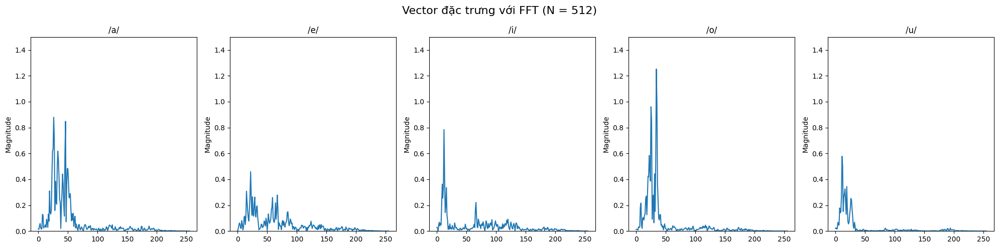

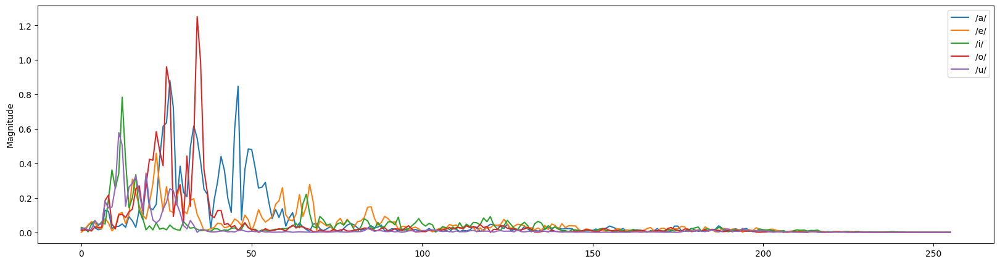

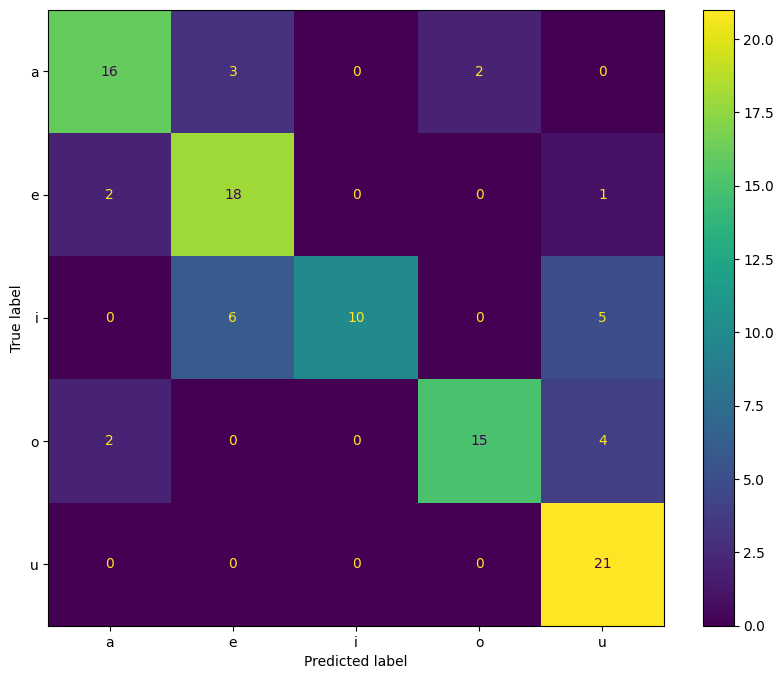

              precision    recall  f1-score   support

           a       0.80      0.76      0.78        21
           e       0.67      0.86      0.75        21
           i       1.00      0.48      0.65        21
           o       0.88      0.71      0.79        21
           u       0.68      1.00      0.81        21

    accuracy                           0.76       105
   macro avg       0.81      0.76      0.75       105
weighted avg       0.81      0.76      0.75       105

0.7619047619047619


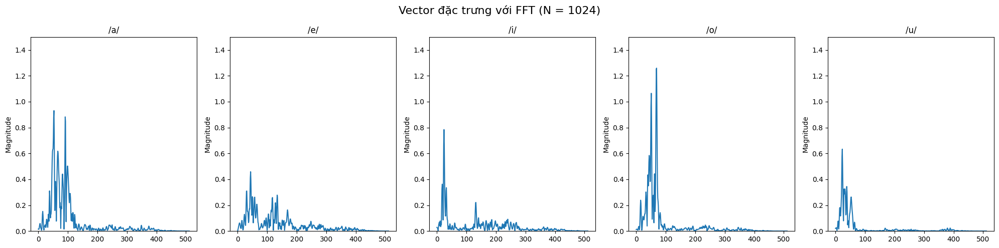

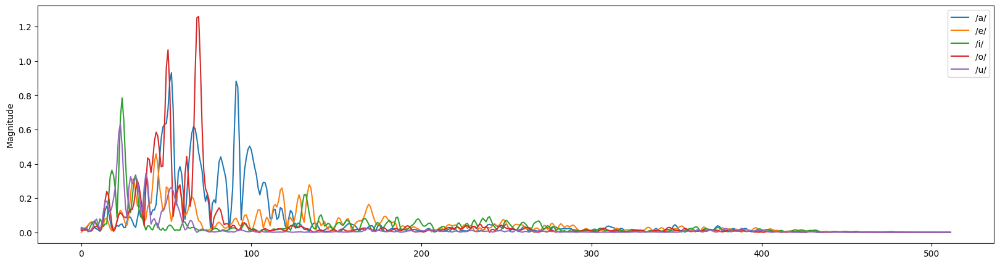

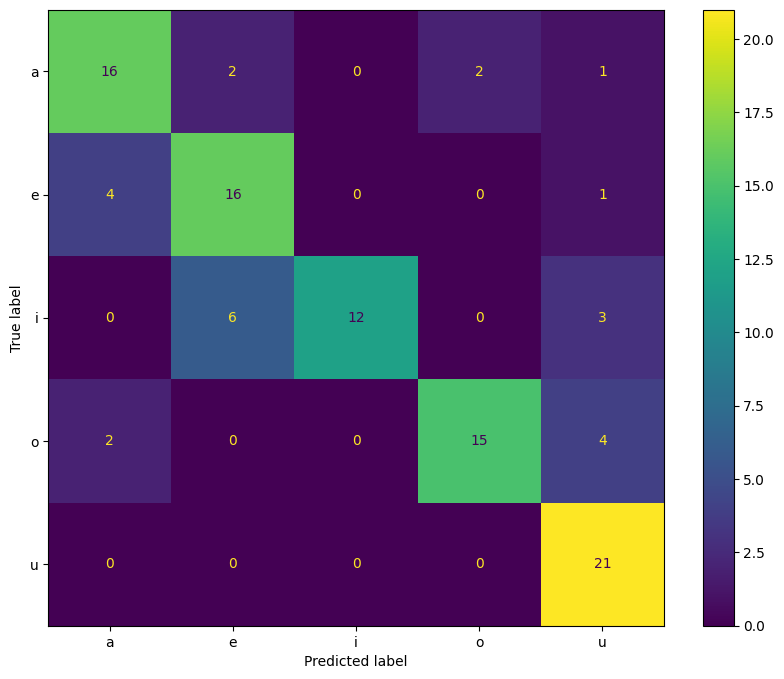

              precision    recall  f1-score   support

           a       0.73      0.76      0.74        21
           e       0.67      0.76      0.71        21
           i       1.00      0.57      0.73        21
           o       0.88      0.71      0.79        21
           u       0.70      1.00      0.82        21

    accuracy                           0.76       105
   macro avg       0.80      0.76      0.76       105
weighted avg       0.80      0.76      0.76       105

0.7619047619047619


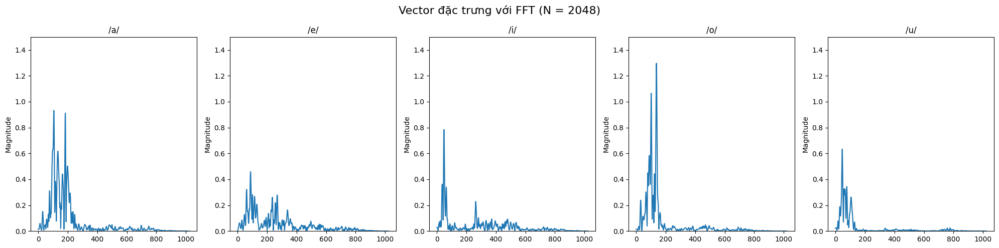

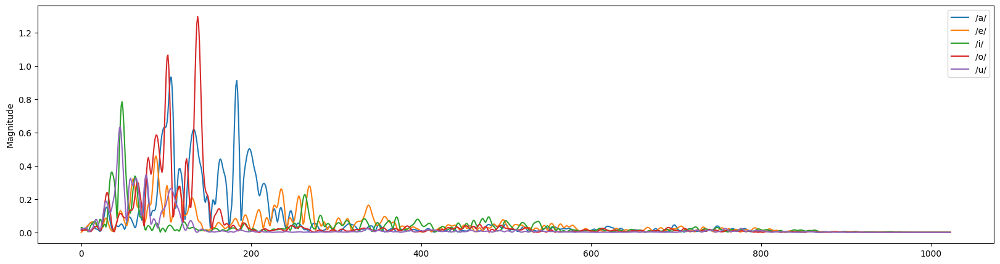

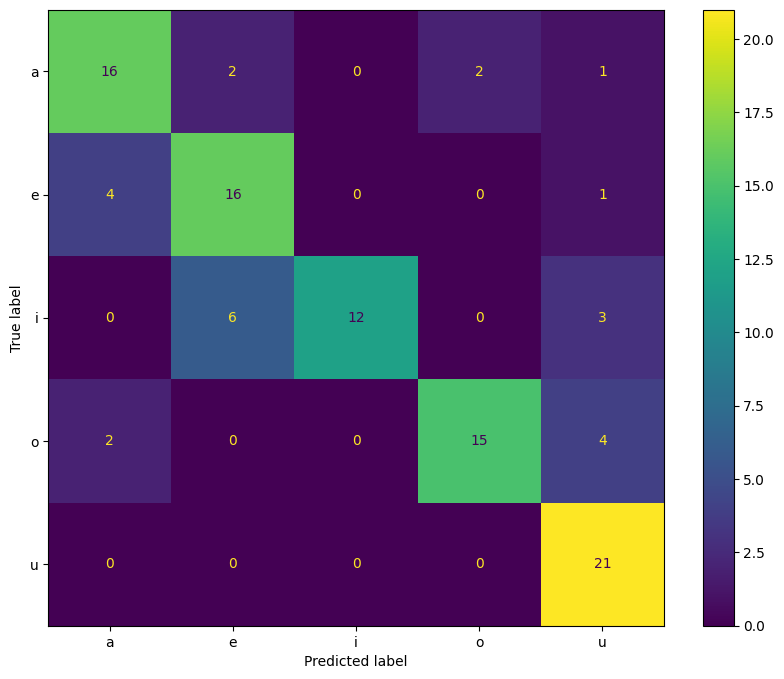

              precision    recall  f1-score   support

           a       0.73      0.76      0.74        21
           e       0.67      0.76      0.71        21
           i       1.00      0.57      0.73        21
           o       0.88      0.71      0.79        21
           u       0.70      1.00      0.82        21

    accuracy                           0.76       105
   macro avg       0.80      0.76      0.76       105
weighted avg       0.80      0.76      0.76       105

0.7619047619047619


In [77]:
# import os
# import numpy as np
# import librosa
# import matplotlib.pyplot as plt
# import glob

# config = {
#   "train_path":"signals/NguyenAmHuanLuyen-16k",
#   "valid_path":"signals/NguyenAmKiemThu-16k",
#   "nffts": [512, 1024, 2048],
#   "am": ["a", "e", "i", "o", "u"]
# }

# # No window function
# # def SingleFrameFFT(frame, nFFT):
# #    return np.fft.fft(frame,nFFT)

# # Rectangle
# # def SingleFrameFFT(frame, nFFT):
# #   signal = np.ones(len(frame)) * frame
# #   return np.fft.fft(signal, nFFT)

# # Hamming
# # def SingleFrameFFT(frame, nFFT):
# #   signal = np.hamming(len(frame)) * frame
# #   return np.fft.fft(signal, nFFT)

# # Hann
# # def SingleFrameFFT(frame, nFFT):
# #   signal = np.hanning(len(frame)) * frame
# #   return np.fft.fft(signal, nFFT)

# # Blackman
# # def SingleFrameFFT(frame, nFFT):
# #   signal = np.blackman(len(frame)) * frame
# #   return np.fft.fft(signal, nFFT)

# # Bartlett
# def SingleFrameFFT(frame, nFFT):
#   signal = np.bartlett(len(frame)) * frame
#   return np.fft.fft(signal, nFFT)

# def getFeaturesVector(file_path, nFFT):

#   # ==== get label =====================
#   filename = os.path.basename(file_path)
#   # ====================================

#   # === get human say ==================
#   human = file_path.split("/")[-2]
#   # ====================================

#   # Load audio file
#   y, fs = librosa.load(file_path, sr = None)

#   # Calculate Short-Time Energy (STE)
#   window_size = 0.03  # Size of the window (30 ms)
#   overlap = 0.0  # Overlap between windows (50%)
#   ste_threshold = 0.01  # STE threshold for classifying sound and silence

#   # Calculate window parameters
#   window_length = int(window_size * fs)
#   overlap_length = int(overlap * window_length)

#   # Calculate STE for each window
#   ste = np.zeros_like(y)
#   for i in range(0, len(y) - window_length, window_length - overlap_length):
#       window = y[i:i + window_length]
#       ste[i:i + window_length] = np.sum(window ** 2)

#   # Classify sound and silence
#   sound_segments = y[ste > ste_threshold]
#   silence_segments = y[ste <= ste_threshold]

#   # Create time vectors
#   time_sound = np.arange(len(sound_segments)) / fs
#   time_silence = np.arange(len(silence_segments)) / fs

#   # ==========================
#   offset = sound_segments.shape[0]
#   x1 = sound_segments[int(offset * 1/3): int(offset * 2/3)]
#   t = time_sound[int(offset * 1/3): int(offset * 2/3)]
#   # time_step = 0.03 * fs # = 30ms
#   # m = len(np.arange(t[0], t[-1], time_step))
#   # m = 0
#   m = 8

#   features = np.zeros(nFFT, dtype=np.complex128)

#   # for i in range(0, len(x1), int(time_step)):
#   #   frame = x1[i: i + window_length];
#   #   features += SingleFrameFFT(frame, nFFT = nFFT)
#   #   m += 1

#   for (i) in range(m):
#     frame = x1[int(x1.shape[0] * i/m ): int(x1.shape[0] * i/m + window_length)]
#     features += SingleFrameFFT(frame, nFFT = nFFT)

#   return features / m

# def euclidean_distance(a, b):
#     return abs(a - b)

# for NFFT in config["nffts"]:
#   m = {
#     "a":np.zeros(NFFT, dtype=np.complex128),
#     "e":np.zeros(NFFT, dtype=np.complex128),
#     "i":np.zeros(NFFT, dtype=np.complex128),
#     "o":np.zeros(NFFT, dtype=np.complex128),
#     "u":np.zeros(NFFT, dtype=np.complex128),
#   }

#   for path in glob.glob(config["train_path"] + "/**/*.wav"):
#     label = os.path.basename(path).split(".")[0]
#     features = getFeaturesVector(path, nFFT = NFFT)
#     m[label] += features

#   for a in config["am"]:
#     m[a] /= len(os.listdir(config["train_path"]))

#   y_true = []
#   y_pred = []

#   for fname in glob.glob(config["valid_path"] + "/**/*.wav"):
#     label = os.path.basename(fname).split(".")[0]
#     yhat = getFeaturesVector(fname, nFFT = NFFT)
#     pred = []
#     for a in config["am"]:
#       s = 0
#       for (i) in range(NFFT):
#         s += euclidean_distance(abs(m[a][i]), abs(yhat[i]))
#       pred.append(s)

#     y_pred.append(config["am"][np.argmin(pred)])
#     y_true.append(label)

#   plt.rcParams["figure.figsize"] = (20, 5)

#   from matplotlib import cm
#   fig, axs = plt.subplots(1, 5)
#   fig.figsize = (20,30)
#   fig.suptitle("Vector đặc trưng với FFT (N = {})".format(NFFT), fontsize=16)
#   for i in range(len(config["am"])):
#     axs[i].set_title("/"+config["am"][i]+"/")
#     axs[i].plot(abs(m[config["am"][i]][:len(m[config["am"][i]])//2]))
#     axs[i].set_ylim([0, 1.5])
#     axs[i].set_ylabel("Magnitude")

#   fig.tight_layout()
#   fig.show()

#   fig, axs = plt.subplots(1)
#   for a in config["am"]:
#     axs.plot((abs(m[a][:len(m[a])//2])), label = "/"+a+"/")

#   axs.set_ylabel("Magnitude")
#   axs.legend()
#   fig.show()

#   from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay
#   cm = confusion_matrix(y_true, y_pred, labels=config["am"])

#   plt.rcParams["figure.figsize"] = (10, 8)
#   disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=config["am"])
#   disp.plot()
#   plt.show()

#   from sklearn.metrics import classification_report, accuracy_score
#   print(classification_report(y_true, y_pred))
#   print(accuracy_score(y_true, y_pred))

**5 Window functions**
Fingerprint = modulus of fft vectors


 <function bartlett at 0x79f778d3b2e0>


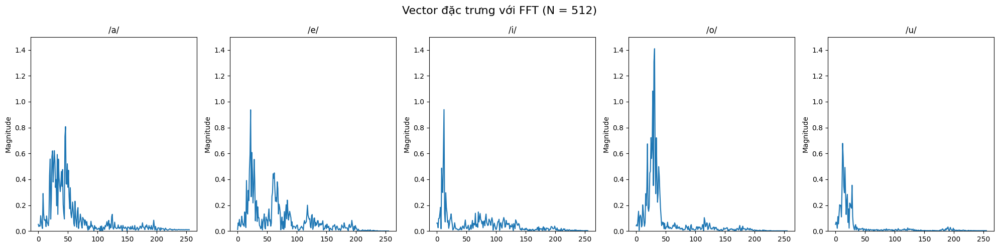

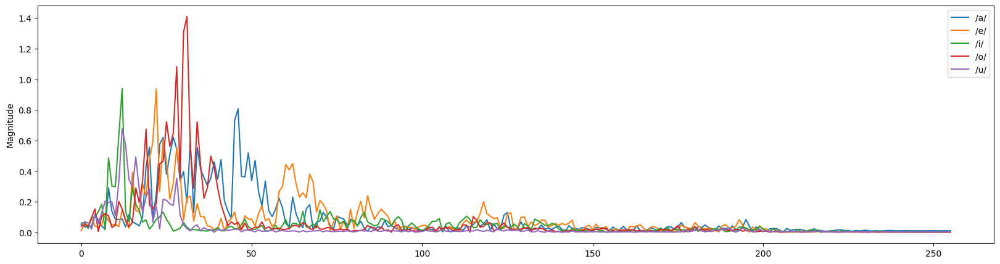

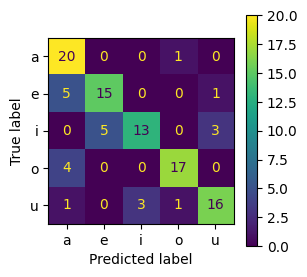

              precision    recall  f1-score   support

           a       0.67      0.95      0.78        21
           e       0.75      0.71      0.73        21
           i       0.81      0.62      0.70        21
           o       0.89      0.81      0.85        21
           u       0.80      0.76      0.78        21

    accuracy                           0.77       105
   macro avg       0.78      0.77      0.77       105
weighted avg       0.78      0.77      0.77       105

0.7714285714285715


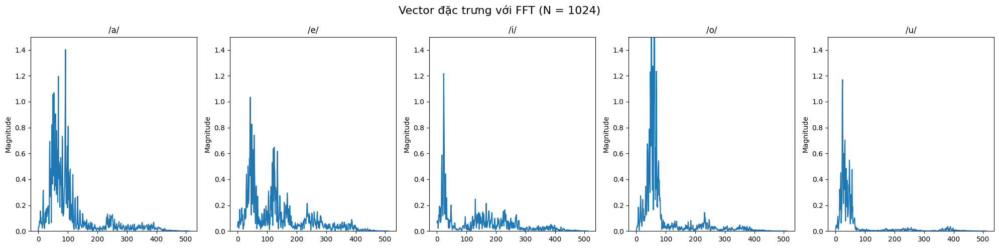

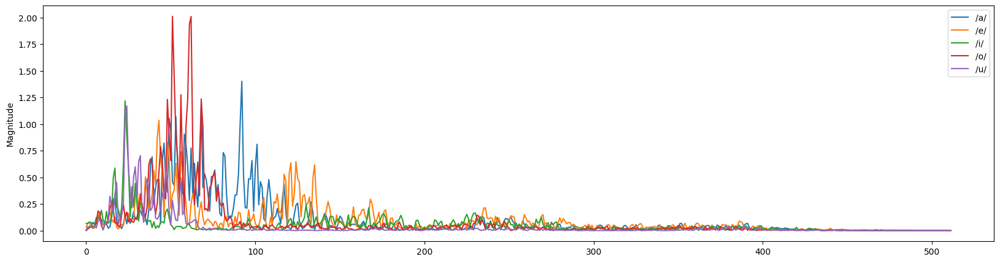

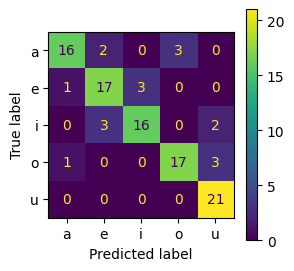

              precision    recall  f1-score   support

           a       0.89      0.76      0.82        21
           e       0.77      0.81      0.79        21
           i       0.84      0.76      0.80        21
           o       0.85      0.81      0.83        21
           u       0.81      1.00      0.89        21

    accuracy                           0.83       105
   macro avg       0.83      0.83      0.83       105
weighted avg       0.83      0.83      0.83       105

0.8285714285714286


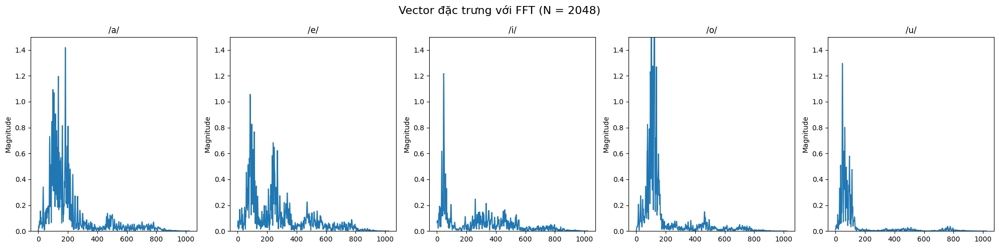

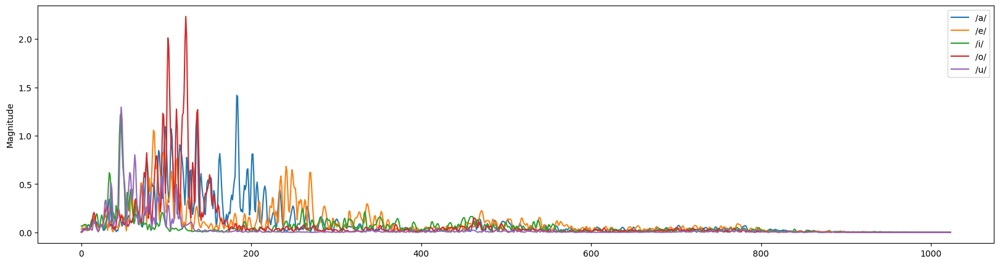

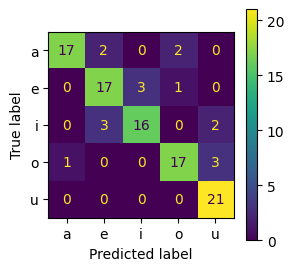

              precision    recall  f1-score   support

           a       0.94      0.81      0.87        21
           e       0.77      0.81      0.79        21
           i       0.84      0.76      0.80        21
           o       0.85      0.81      0.83        21
           u       0.81      1.00      0.89        21

    accuracy                           0.84       105
   macro avg       0.84      0.84      0.84       105
weighted avg       0.84      0.84      0.84       105

0.8380952380952381

 <function ones at 0x79f779326950>


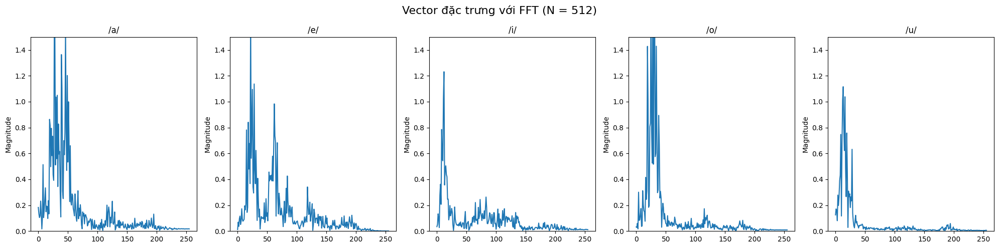

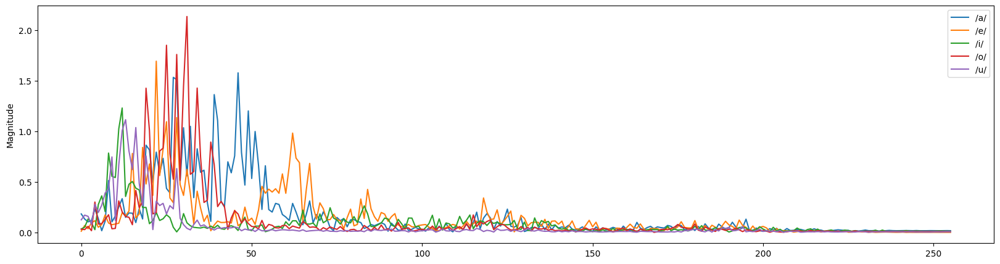

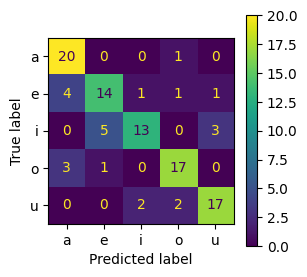

              precision    recall  f1-score   support

           a       0.74      0.95      0.83        21
           e       0.70      0.67      0.68        21
           i       0.81      0.62      0.70        21
           o       0.81      0.81      0.81        21
           u       0.81      0.81      0.81        21

    accuracy                           0.77       105
   macro avg       0.77      0.77      0.77       105
weighted avg       0.77      0.77      0.77       105

0.7714285714285715


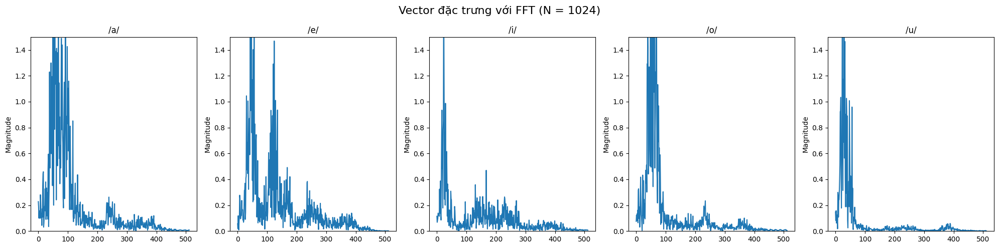

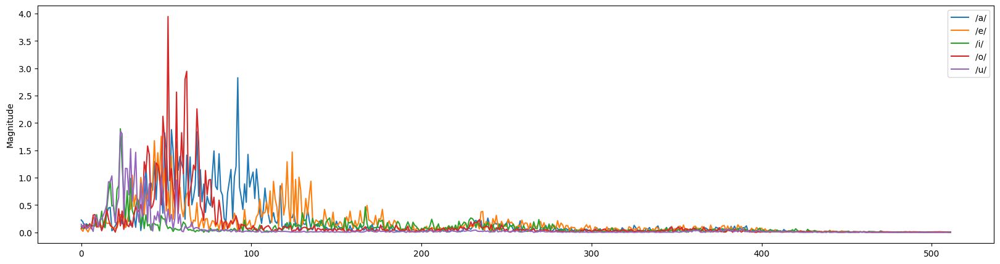

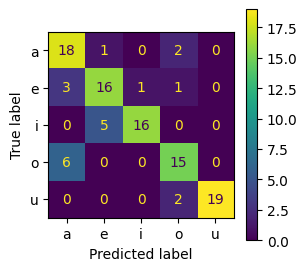

              precision    recall  f1-score   support

           a       0.67      0.86      0.75        21
           e       0.73      0.76      0.74        21
           i       0.94      0.76      0.84        21
           o       0.75      0.71      0.73        21
           u       1.00      0.90      0.95        21

    accuracy                           0.80       105
   macro avg       0.82      0.80      0.80       105
weighted avg       0.82      0.80      0.80       105

0.8


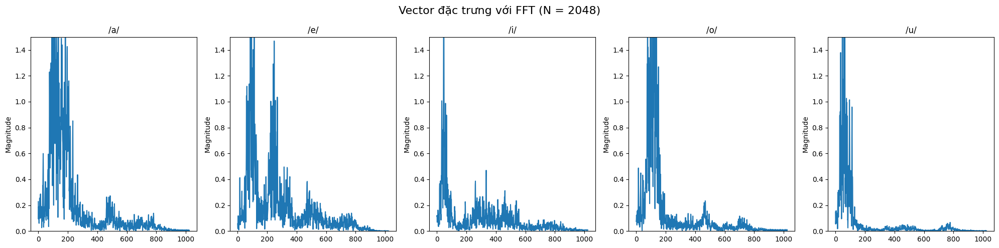

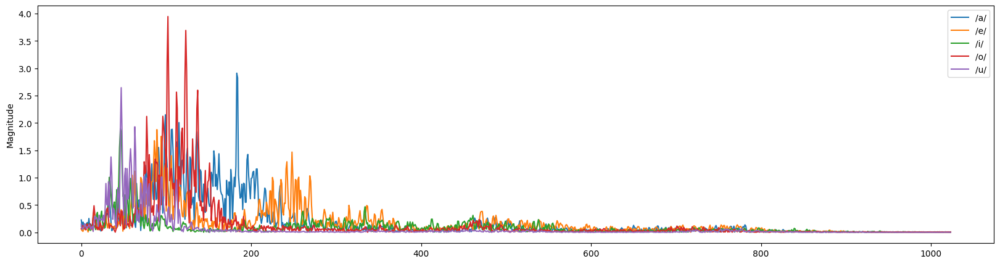

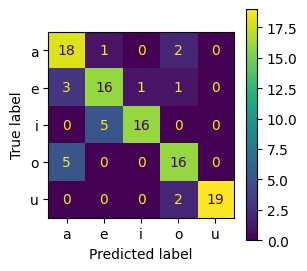

              precision    recall  f1-score   support

           a       0.69      0.86      0.77        21
           e       0.73      0.76      0.74        21
           i       0.94      0.76      0.84        21
           o       0.76      0.76      0.76        21
           u       1.00      0.90      0.95        21

    accuracy                           0.81       105
   macro avg       0.82      0.81      0.81       105
weighted avg       0.82      0.81      0.81       105

0.8095238095238095

 <function hamming at 0x79f778d3b400>


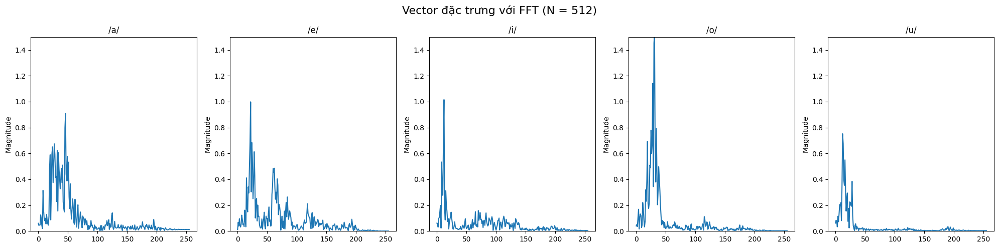

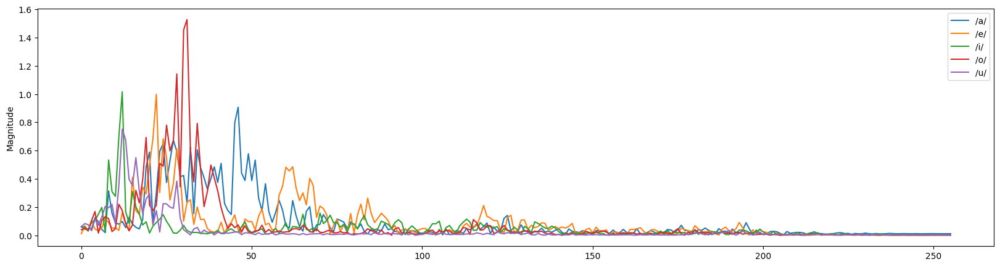

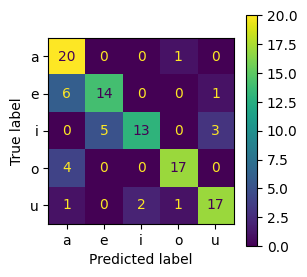

              precision    recall  f1-score   support

           a       0.65      0.95      0.77        21
           e       0.74      0.67      0.70        21
           i       0.87      0.62      0.72        21
           o       0.89      0.81      0.85        21
           u       0.81      0.81      0.81        21

    accuracy                           0.77       105
   macro avg       0.79      0.77      0.77       105
weighted avg       0.79      0.77      0.77       105

0.7714285714285715


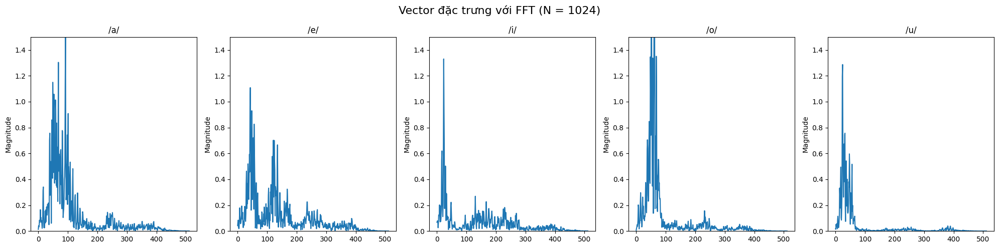

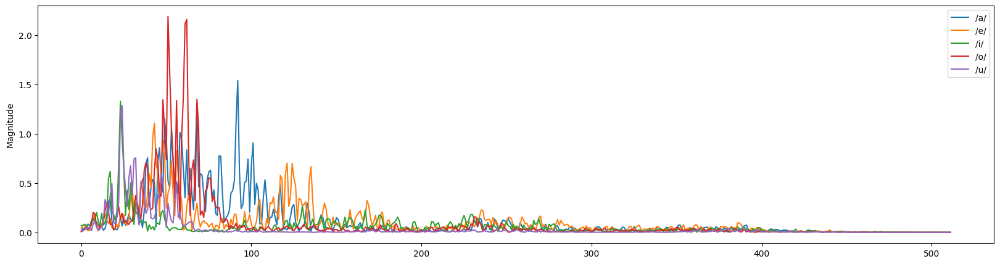

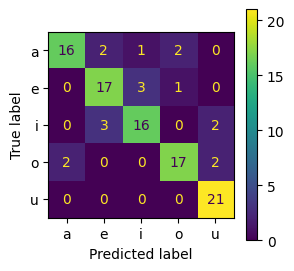

              precision    recall  f1-score   support

           a       0.89      0.76      0.82        21
           e       0.77      0.81      0.79        21
           i       0.80      0.76      0.78        21
           o       0.85      0.81      0.83        21
           u       0.84      1.00      0.91        21

    accuracy                           0.83       105
   macro avg       0.83      0.83      0.83       105
weighted avg       0.83      0.83      0.83       105

0.8285714285714286


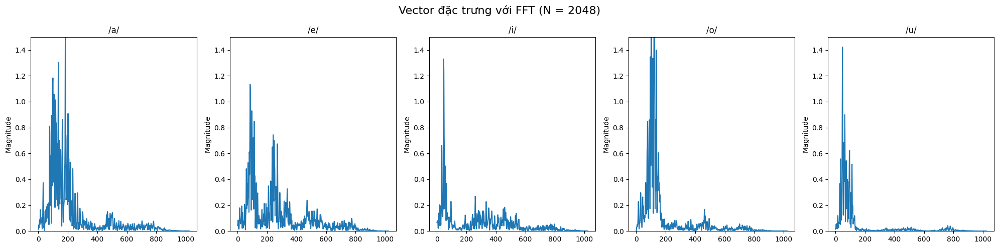

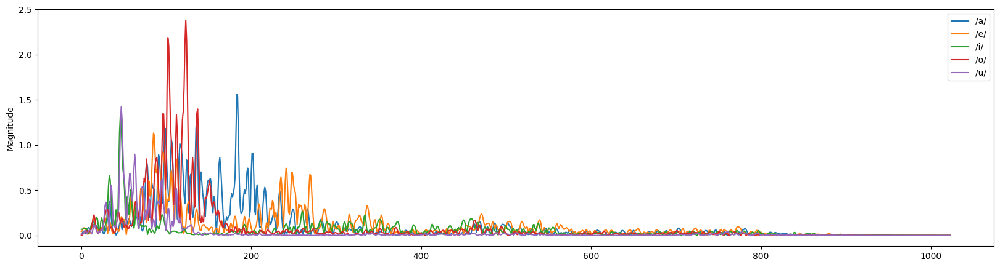

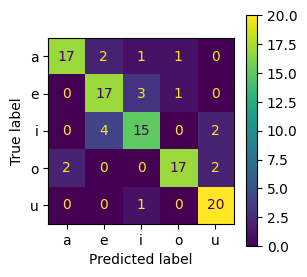

              precision    recall  f1-score   support

           a       0.89      0.81      0.85        21
           e       0.74      0.81      0.77        21
           i       0.75      0.71      0.73        21
           o       0.89      0.81      0.85        21
           u       0.83      0.95      0.89        21

    accuracy                           0.82       105
   macro avg       0.82      0.82      0.82       105
weighted avg       0.82      0.82      0.82       105

0.819047619047619

 <function hanning at 0x79f778d3b370>


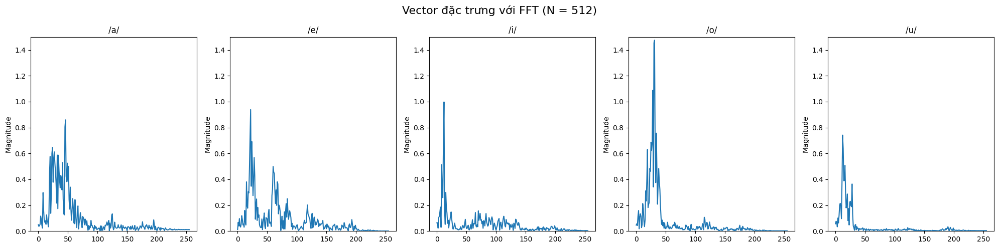

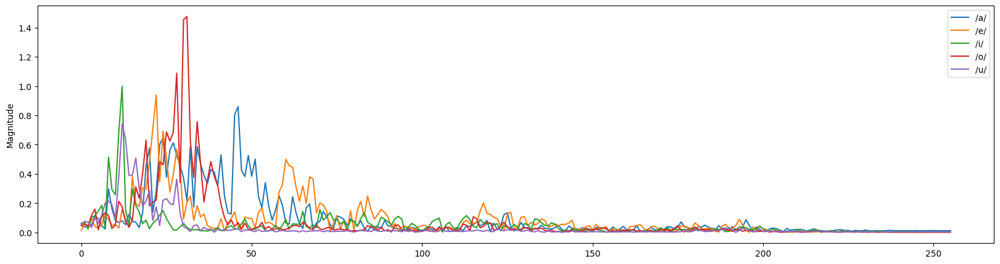

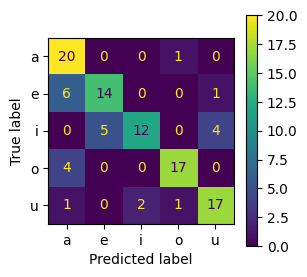

              precision    recall  f1-score   support

           a       0.65      0.95      0.77        21
           e       0.74      0.67      0.70        21
           i       0.86      0.57      0.69        21
           o       0.89      0.81      0.85        21
           u       0.77      0.81      0.79        21

    accuracy                           0.76       105
   macro avg       0.78      0.76      0.76       105
weighted avg       0.78      0.76      0.76       105

0.7619047619047619


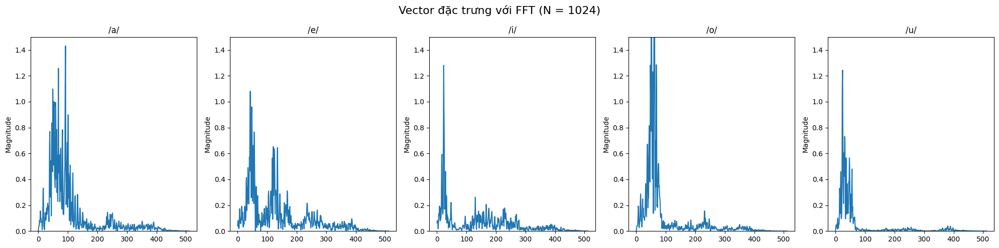

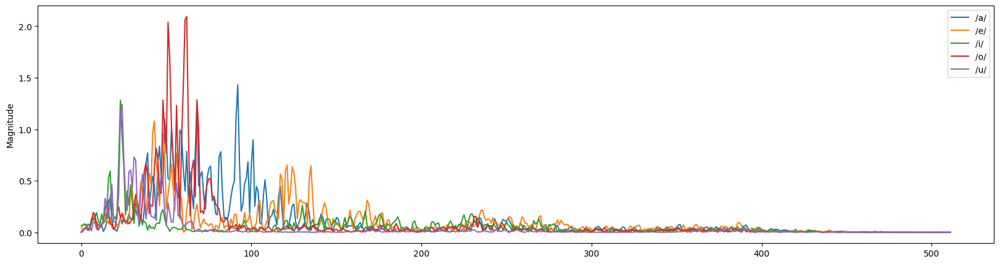

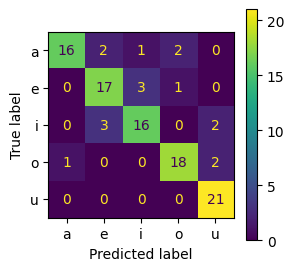

              precision    recall  f1-score   support

           a       0.94      0.76      0.84        21
           e       0.77      0.81      0.79        21
           i       0.80      0.76      0.78        21
           o       0.86      0.86      0.86        21
           u       0.84      1.00      0.91        21

    accuracy                           0.84       105
   macro avg       0.84      0.84      0.84       105
weighted avg       0.84      0.84      0.84       105

0.8380952380952381


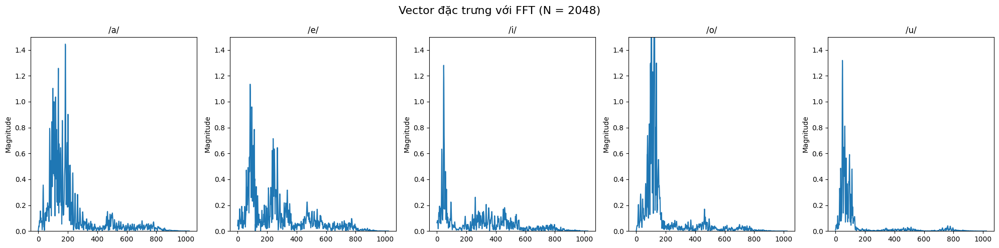

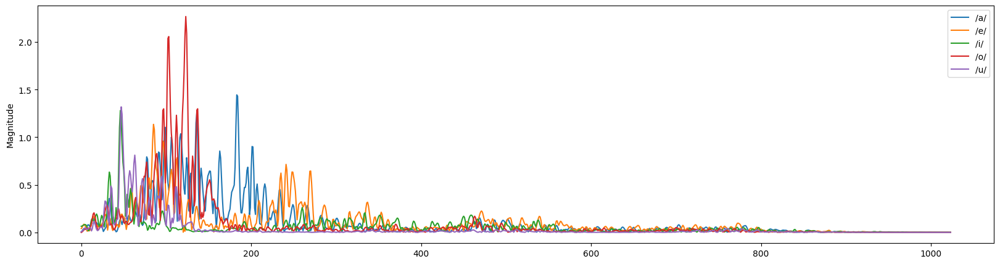

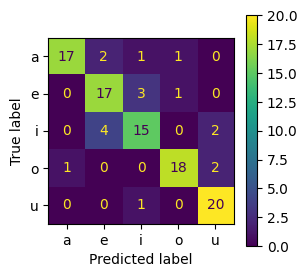

              precision    recall  f1-score   support

           a       0.94      0.81      0.87        21
           e       0.74      0.81      0.77        21
           i       0.75      0.71      0.73        21
           o       0.90      0.86      0.88        21
           u       0.83      0.95      0.89        21

    accuracy                           0.83       105
   macro avg       0.83      0.83      0.83       105
weighted avg       0.83      0.83      0.83       105

0.8285714285714286

 <function blackman at 0x79f778d3b250>


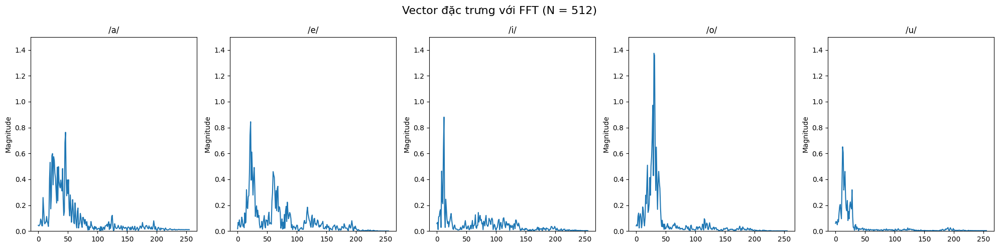

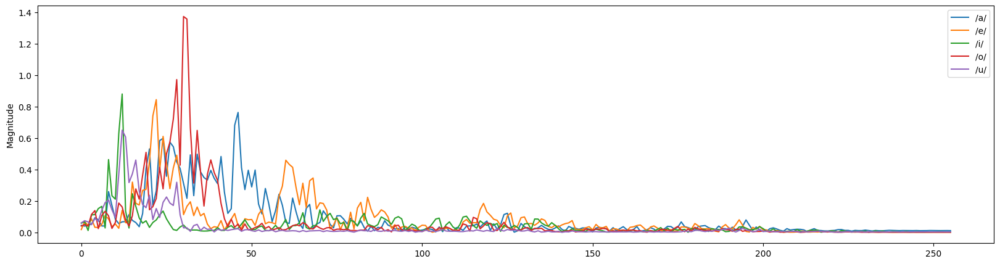

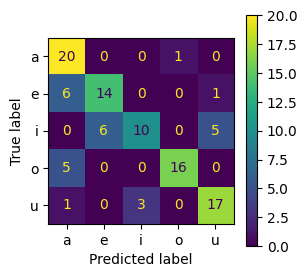

              precision    recall  f1-score   support

           a       0.62      0.95      0.75        21
           e       0.70      0.67      0.68        21
           i       0.77      0.48      0.59        21
           o       0.94      0.76      0.84        21
           u       0.74      0.81      0.77        21

    accuracy                           0.73       105
   macro avg       0.75      0.73      0.73       105
weighted avg       0.75      0.73      0.73       105

0.7333333333333333


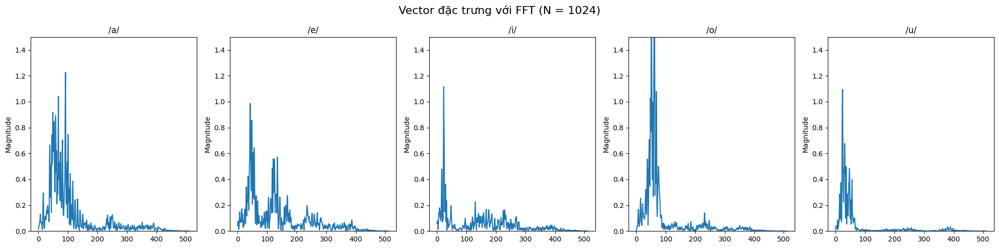

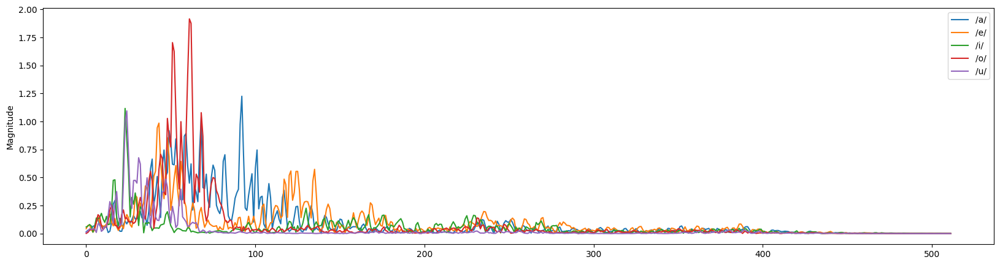

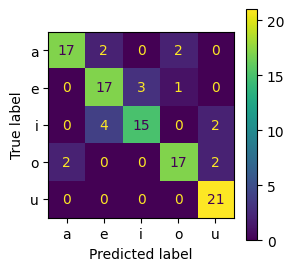

              precision    recall  f1-score   support

           a       0.89      0.81      0.85        21
           e       0.74      0.81      0.77        21
           i       0.83      0.71      0.77        21
           o       0.85      0.81      0.83        21
           u       0.84      1.00      0.91        21

    accuracy                           0.83       105
   macro avg       0.83      0.83      0.83       105
weighted avg       0.83      0.83      0.83       105

0.8285714285714286


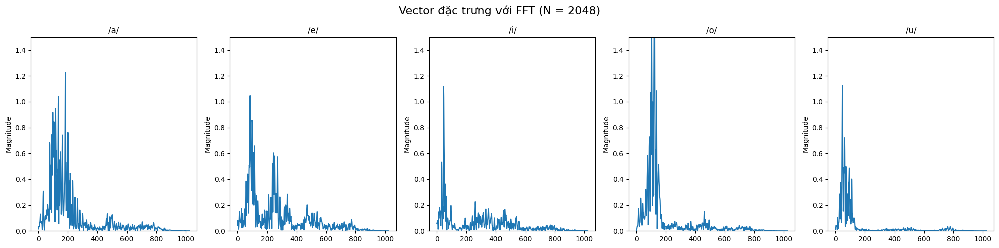

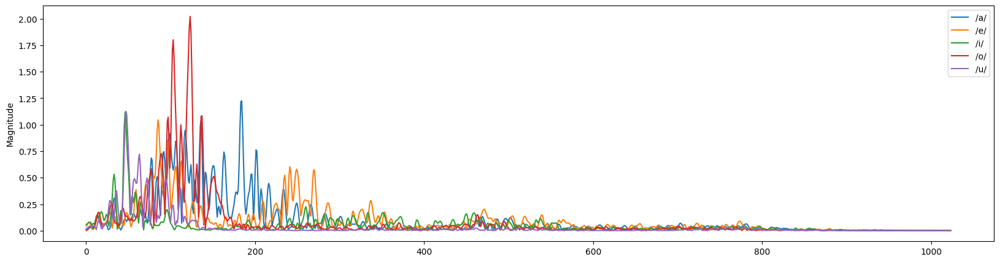

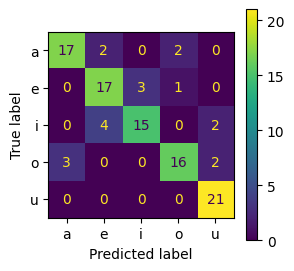

              precision    recall  f1-score   support

           a       0.85      0.81      0.83        21
           e       0.74      0.81      0.77        21
           i       0.83      0.71      0.77        21
           o       0.84      0.76      0.80        21
           u       0.84      1.00      0.91        21

    accuracy                           0.82       105
   macro avg       0.82      0.82      0.82       105
weighted avg       0.82      0.82      0.82       105

0.819047619047619


In [18]:
import os
import numpy as np
import librosa
import matplotlib.pyplot as plt
import glob



config = {
  "train_path":"signals/NguyenAmHuanLuyen-16k",
  "valid_path":"signals/NguyenAmKiemThu-16k",
  "nffts": [512, 1024, 2048],
  "am": ["a", "e", "i", "o", "u"],
  "swfunc": [np.bartlett, np.ones, np.hamming, np.hanning, np.blackman]
}

# No window function
# def SingleFrameFFT(frame, nFFT):
#    return np.fft.fft(frame,nFFT)


def SingleFrameFFT(frame, nFFT, swfunc):
  signal = swfunc(len(frame)) * frame
  return np.fft.fft(signal, nFFT)

def getFeaturesVector(file_path, nFFT, swfunc):

  # ==== get label =====================
  filename = os.path.basename(file_path)
  # ====================================

  # === get human say ==================
  human = file_path.split("/")[-2]
  # ====================================

  # Load audio file
  y, fs = librosa.load(file_path, sr = None)

  # Calculate Short-Time Energy (STE)
  window_size = 0.03  # Size of the window (30 ms)
  overlap = 0.0  # Overlap between windows (50%)
  ste_threshold = 0.01  # STE threshold for classifying sound and silence

  # Calculate window parameters
  window_length = int(window_size * fs)
  overlap_length = int(overlap * window_length)

  # Calculate STE for each window
  ste = np.zeros_like(y)
  for i in range(0, len(y) - window_length, window_length - overlap_length):
      window = y[i:i + window_length]
      ste[i:i + window_length] = np.sum(window ** 2)

  # Classify sound and silence
  sound_segments = y[ste > ste_threshold]
  silence_segments = y[ste <= ste_threshold]

  # Create time vectors
  time_sound = np.arange(len(sound_segments)) / fs
  time_silence = np.arange(len(silence_segments)) / fs

  # ==========================
  offset = sound_segments.shape[0]
  x1 = sound_segments[int(offset * 1/3): int(offset * 2/3)]
  t = time_sound[int(offset * 1/3): int(offset * 2/3)]
  time_step = 0.03 # = 30ms
  # m = len(np.arange(t[0], t[-1], time_step))
  m = 3

  features = np.zeros(nFFT, dtype=np.complex128)
  for (i) in range(m):
    # frame = x1[int(x1.shape[0] * i/m ): int(x1.shape[0] * (i + 1)/m)]
    frame = x1[int(x1.shape[0] * i/m ): int(x1.shape[0] * i/m + 2 * window_length)]
    features += SingleFrameFFT(frame, nFFT = nFFT, swfunc = swfunc)

  return features / m

def euclidean_distance(a, b):
    return abs(a - b)

for swfunc in config["swfunc"]:
  print("\n", swfunc)
  for NFFT in config["nffts"]:
    m = {
      "a":np.zeros(NFFT, dtype=np.complex128),
      "e":np.zeros(NFFT, dtype=np.complex128),
      "i":np.zeros(NFFT, dtype=np.complex128),
      "o":np.zeros(NFFT, dtype=np.complex128),
      "u":np.zeros(NFFT, dtype=np.complex128),
    }

    for path in glob.glob(config["train_path"] + "/**/*.wav"):
      label = os.path.basename(path).split(".")[0]
      features = getFeaturesVector(path, nFFT = NFFT, swfunc=swfunc)
      m[label] += features

    for a in config["am"]:
      m[a] /= len(os.listdir(config["train_path"]))

    y_true = []
    y_pred = []

    for fname in glob.glob(config["valid_path"] + "/**/*.wav"):
      label = os.path.basename(fname).split(".")[0]
      yhat = getFeaturesVector(fname, nFFT = NFFT, swfunc=swfunc)
      pred = []
      for a in config["am"]:
        s = 0
        for (i) in range(NFFT):
          s += euclidean_distance(abs(m[a][i]), abs(yhat[i]))
        pred.append(s)

      y_pred.append(config["am"][np.argmin(pred)])
      y_true.append(label)

    plt.rcParams["figure.figsize"] = (20, 5)

    from matplotlib import cm
    fig, axs = plt.subplots(1, 5)
    fig.figsize = (20,30)
    fig.suptitle("Vector đặc trưng với FFT (N = {})".format(NFFT), fontsize=16)
    for i in range(len(config["am"])):
      axs[i].set_title("/"+config["am"][i]+"/")
      axs[i].plot((abs(m[config["am"][i]][:len(m[config["am"][i]])//2])))
      axs[i].set_ylim([0, 1.5])
      axs[i].set_ylabel("Magnitude")

    fig.tight_layout()
    fig.show()

    fig, axs = plt.subplots(1)
    for a in config["am"]:
      axs.plot((abs(m[a][:len(m[a])//2])), label = "/"+a+"/")

    axs.set_ylabel("Magnitude")
    axs.legend()
    fig.show()

    from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay
    cm = confusion_matrix(y_true, y_pred, labels=config["am"])

    plt.rcParams["figure.figsize"] = (10, 8)
    disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=config["am"])
    fig, ax = plt.subplots(figsize=(10,10))
    disp.plot(ax=ax)
    fig.set_figwidth(3)
    fig.set_figheight(3)
    fig.show()
    plt.show()

    from sklearn.metrics import classification_report, accuracy_score
    print(classification_report(y_true, y_pred))
    print(accuracy_score(y_true, y_pred))

**5 Window functions**
Fingerprint = 20*log10(abs(fft vector))

In [19]:
# import os
# import numpy as np
# import librosa
# import matplotlib.pyplot as plt
# import glob



# config = {
#   "train_path":"signals/NguyenAmHuanLuyen-16k",
#   "valid_path":"signals/NguyenAmKiemThu-16k",
#   "nffts": [512, 1024, 2048],
#   "am": ["a", "e", "i", "o", "u"],
#   "swfunc": [np.bartlett, np.ones, np.hamming, np.hanning, np.blackman]
# }

# # No window function
# # def SingleFrameFFT(frame, nFFT):
# #    return np.fft.fft(frame,nFFT)

# # Rectangle
# # def SingleFrameFFT(frame, nFFT):
# #   signal = np.ones(len(frame)) * frame
# #   return np.fft.fft(signal, nFFT)

# # Hamming
# # def SingleFrameFFT(frame, nFFT):
# #   signal = np.hamming(len(frame)) * frame
# #   return np.fft.fft(signal, nFFT)

# # Hann
# # def SingleFrameFFT(frame, nFFT):
# #   signal = np.hanning(len(frame)) * frame
# #   return np.fft.fft(signal, nFFT)

# # Blackman
# # def SingleFrameFFT(frame, nFFT):
# #   signal = np.blackman(len(frame)) * frame
# #   return np.fft.fft(signal, nFFT)

# # Bartlett
# # def SingleFrameFFT(frame, nFFT):
# #   signal = np.bartlett(len(frame)) * frame
# #   return np.fft.fft(signal, nFFT)

# def SingleFrameFFT(frame, nFFT, swfunc):
#   signal = swfunc(len(frame)) * frame
#   return np.fft.fft(signal, nFFT)

# def getFeaturesVector(file_path, nFFT, swfunc):

#   # ==== get label =====================
#   filename = os.path.basename(file_path)
#   # ====================================

#   # === get human say ==================
#   human = file_path.split("/")[-2]
#   # ====================================

#   # Load audio file
#   y, fs = librosa.load(file_path, sr = None)

#   # Calculate Short-Time Energy (STE)
#   window_size = 0.03  # Size of the window (30 ms)
#   overlap = 0.0  # Overlap between windows (50%)
#   ste_threshold = 0.01  # STE threshold for classifying sound and silence

#   # Calculate window parameters
#   window_length = int(window_size * fs)
#   overlap_length = int(overlap * window_length)

#   # Calculate STE for each window
#   ste = np.zeros_like(y)
#   for i in range(0, len(y) - window_length, window_length - overlap_length):
#       window = y[i:i + window_length]
#       ste[i:i + window_length] = np.sum(window ** 2)

#   # Classify sound and silence
#   sound_segments = y[ste > ste_threshold]
#   silence_segments = y[ste <= ste_threshold]

#   # Create time vectors
#   time_sound = np.arange(len(sound_segments)) / fs
#   time_silence = np.arange(len(silence_segments)) / fs

#   # ==========================
#   offset = sound_segments.shape[0]
#   x1 = sound_segments[int(offset * 1/3): int(offset * 2/3)]
#   t = time_sound[int(offset * 1/3): int(offset * 2/3)]
#   time_step = 0.03 # = 30ms
#   # m = len(np.arange(t[0], t[-1], time_step))
#   m = 3

#   features = np.zeros(nFFT, dtype=np.complex128)
#   for (i) in range(m):
#     # frame = x1[int(x1.shape[0] * i/m ): int(x1.shape[0] * (i + 1)/m)]
#     frame = x1[int(x1.shape[0] * i/m ): int(x1.shape[0] * i/m + 2 * window_length)]
#     features += SingleFrameFFT(frame, nFFT = nFFT, swfunc = swfunc)

#   return features / m

# def euclidean_distance(a, b):
#     return abs(a - b)

# for swfunc in config["swfunc"]:
#   print("\n", swfunc)
#   for NFFT in config["nffts"]:
#     m = {
#       "a":np.zeros(NFFT, dtype=np.complex128),
#       "e":np.zeros(NFFT, dtype=np.complex128),
#       "i":np.zeros(NFFT, dtype=np.complex128),
#       "o":np.zeros(NFFT, dtype=np.complex128),
#       "u":np.zeros(NFFT, dtype=np.complex128),
#     }

#     for path in glob.glob(config["train_path"] + "/**/*.wav"):
#       label = os.path.basename(path).split(".")[0]
#       features = getFeaturesVector(path, nFFT = NFFT, swfunc=swfunc)
#       m[label] += features

#     for a in config["am"]:
#       m[a] /= len(os.listdir(config["train_path"]))

#     y_true = []
#     y_pred = []

#     for fname in glob.glob(config["valid_path"] + "/**/*.wav"):
#       label = os.path.basename(fname).split(".")[0]
#       yhat = getFeaturesVector(fname, nFFT = NFFT, swfunc=swfunc)
#       pred = []
#       for a in config["am"]:
#         s = 0
#         for (i) in range(NFFT):
#           s += euclidean_distance(abs(m[a][i]), abs(yhat[i]))
#         pred.append(s)

#       y_pred.append(config["am"][np.argmin(pred)])
#       y_true.append(label)

#     plt.rcParams["figure.figsize"] = (20, 5)

#     from matplotlib import cm
#     fig, axs = plt.subplots(1, 5)
#     fig.figsize = (20,30)
#     fig.suptitle("Vector đặc trưng với FFT (N = {})".format(NFFT), fontsize=16)
#     for i in range(len(config["am"])):
#       axs[i].set_title("/"+config["am"][i]+"/")
#       axs[i].plot(20*np.log10(abs(m[config["am"][i]][:len(m[config["am"][i]])//2])))
#       axs[i].set_ylim([-100, 20])
#       axs[i].set_ylabel("dB")

#     fig.tight_layout()
#     fig.show()

#     fig, axs = plt.subplots(1)
#     for a in config["am"]:
#       axs.plot(20*np.log10(abs(m[a][:len(m[a])//2])), label = "/"+a+"/")

#     axs.set_ylabel("dB")
#     axs.legend()
#     fig.show()

#     from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay
#     cm = confusion_matrix(y_true, y_pred, labels=config["am"])

#     plt.rcParams["figure.figsize"] = (10, 8)
#     disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=config["am"])
#     fig, ax = plt.subplots(figsize=(10,10))
#     disp.plot(ax=ax)
#     fig.set_figwidth(3)
#     fig.set_figheight(3)
#     fig.show()
#     plt.show()

#     from sklearn.metrics import classification_report, accuracy_score
#     print(classification_report(y_true, y_pred))
#     print(accuracy_score(y_true, y_pred))

# Bài 3 - MFCC (Only)

              precision    recall  f1-score   support

           a       0.90      0.90      0.90        21
           e       0.95      0.86      0.90        21
           i       1.00      0.86      0.92        21
           o       0.90      0.90      0.90        21
           u       0.81      1.00      0.89        21

    accuracy                           0.90       105
   macro avg       0.91      0.90      0.91       105
weighted avg       0.91      0.90      0.91       105

0.9047619047619048


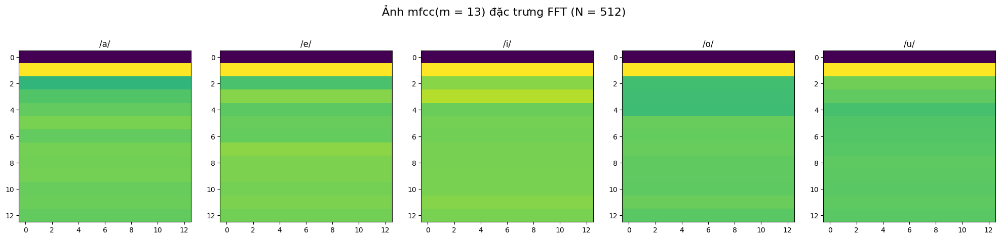

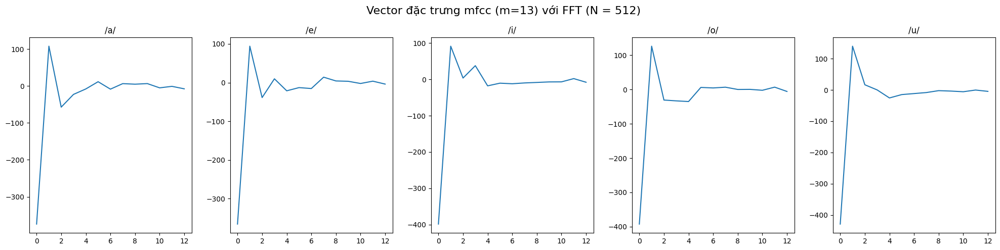

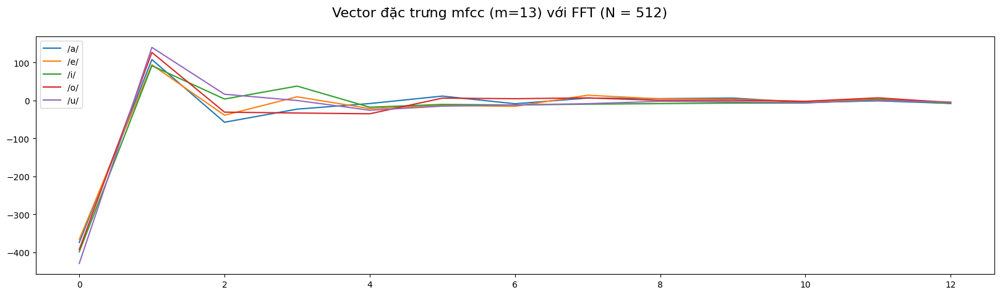

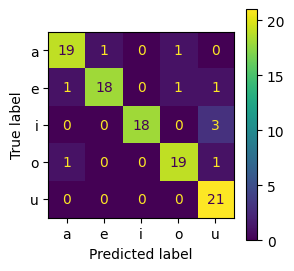

              precision    recall  f1-score   support

           a       0.90      0.90      0.90        21
           e       0.86      0.86      0.86        21
           i       1.00      0.81      0.89        21
           o       0.95      0.90      0.93        21
           u       0.81      1.00      0.89        21

    accuracy                           0.90       105
   macro avg       0.90      0.90      0.90       105
weighted avg       0.90      0.90      0.90       105

0.8952380952380953


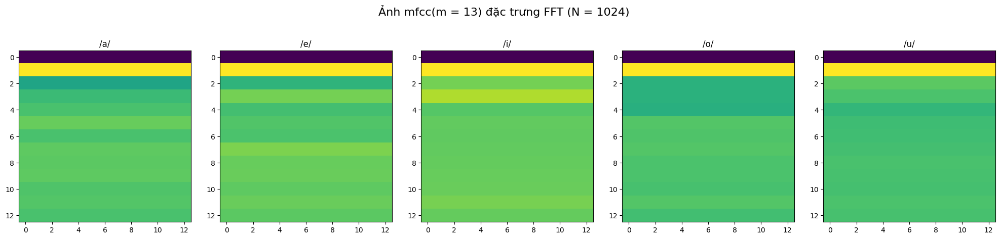

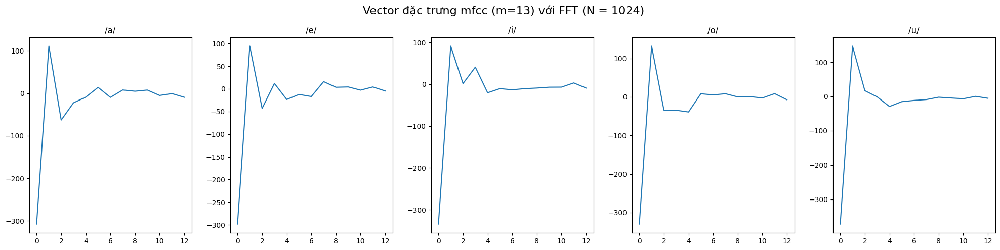

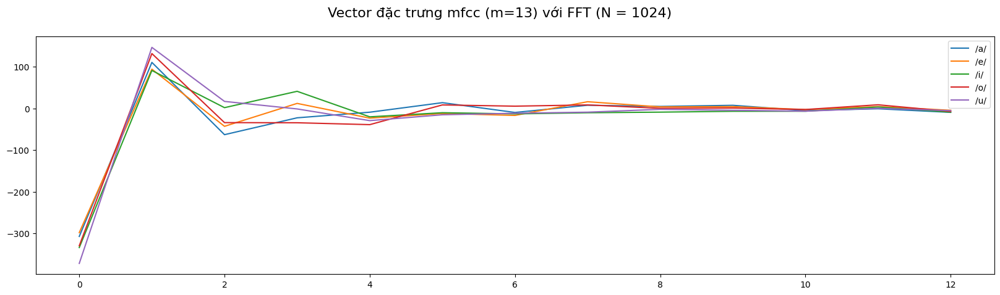

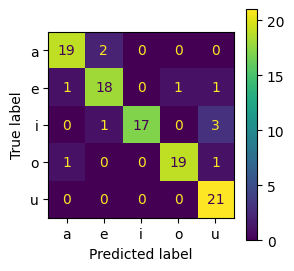

              precision    recall  f1-score   support

           a       0.90      0.90      0.90        21
           e       0.82      0.86      0.84        21
           i       1.00      0.76      0.86        21
           o       0.95      0.90      0.93        21
           u       0.81      1.00      0.89        21

    accuracy                           0.89       105
   macro avg       0.90      0.89      0.89       105
weighted avg       0.90      0.89      0.89       105

0.8857142857142857


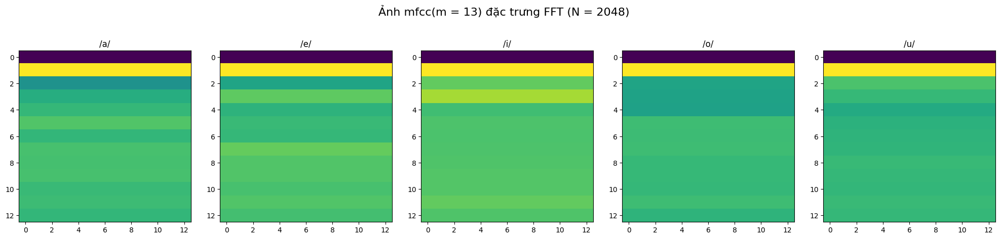

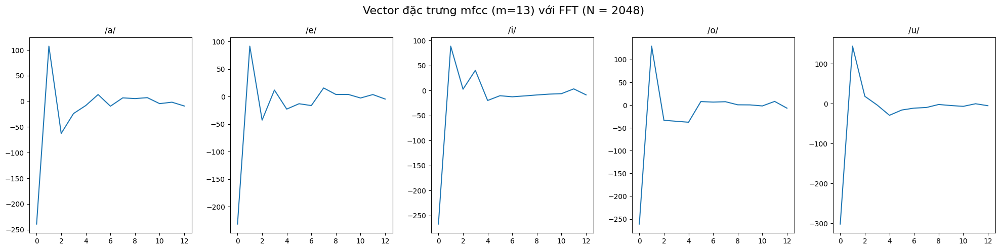

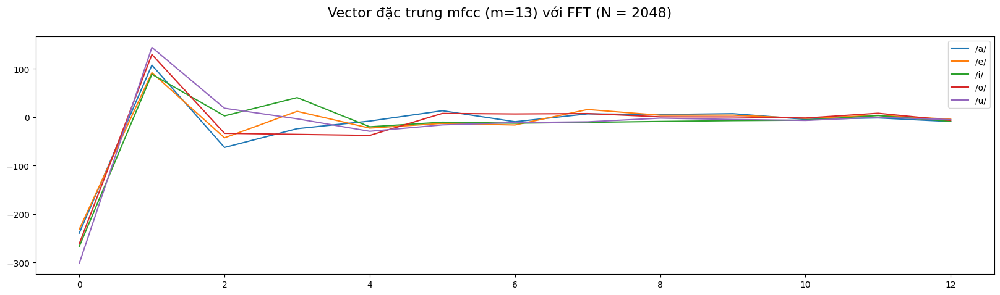

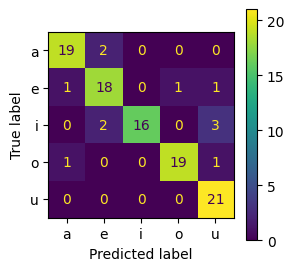

In [20]:
import warnings
warnings.filterwarnings("ignore")

import os
import numpy as np
import librosa
import matplotlib.pyplot as plt
import glob

config = {
  "train_path":"signals/NguyenAmHuanLuyen-16k",
  "valid_path":"signals/NguyenAmKiemThu-16k",
  "nffts": [512, 1024, 2048],
  "am": ["a", "e", "i", "o", "u"],
  "mfcc": 13
}

def euclidean_distance(a, b):
    return abs(a - b)

def load_audio(filename):
    try:
        return librosa.load(filename, sr=None)
    except Exception as e:
        print(f"Cannot load '{filename}': {e}")
        return None

def extract_mfcc(y, sr=22050, n_mfcc=10, n_fft=1024):
    try:
        return librosa.feature.mfcc(y=y, sr=sr, n_mfcc=n_mfcc, n_fft=n_fft)
    except Exception as e:
        print(f"Cannot extract MFCC: {e}")
        return None

def getFeaturesVector(file_path, n_mfcc = 13, n_fft=1024):
  # ==== get label =====================
  filename = os.path.basename(file_path)
  # ====================================

  # === get human say ==================
  human = file_path.split("/")[-2]
  # ====================================

  # Load audio file
  y, fs = librosa.load(file_path, sr=None)

  # Calculate Short-Time Energy (STE)
  window_size = 0.03  # Size of the window (30 ms)
  overlap = 0.5  # Overlap between windows (50%)
  ste_threshold = 0.01  # STE threshold for classifying sound and silence

  # Calculate window parameters
  window_length = int(window_size * fs)
  overlap_length = int(overlap * window_length)

  # Calculate STE for each window
  ste = np.zeros_like(y)
  for i in range(0, len(y) - window_length, window_length - overlap_length):
      window = y[i:i + window_length]
      ste[i:i + window_length] = np.sum(window ** 2)

  # Classify sound and silence
  sound_segments = y[ste > ste_threshold]
  silence_segments = y[ste <= ste_threshold]

  # Create time vectors
  time_sound = np.arange(len(sound_segments)) / fs
  time_silence = np.arange(len(silence_segments)) / fs

  # ==========================
  offset = sound_segments.shape[0]
  # x1 = sound_segments[int(offset * 1/3): int(offset * 2/3)]
  x1 = sound_segments
  # t = time_sound[int(offset * 1/3): int(offset * 2/3)]
  t = time_sound
  time_step = 0.03 # = 30ms
  m = len(np.arange(t[0], t[-1], time_step))

  features = np.zeros((n_mfcc, n_mfcc))
  for (i) in range(m):
    frame = x1[int(x1.shape[0] * i/m ): int(x1.shape[0] * (i + 1)/m)]
    features += extract_mfcc(frame, fs, n_mfcc, n_fft)
  return features / m

for n_fft in config["nffts"]:
  m = {
    "a":np.zeros((config["mfcc"], config["mfcc"])),
    "e":np.zeros((config["mfcc"], config["mfcc"])),
    "i":np.zeros((config["mfcc"], config["mfcc"])),
    "o":np.zeros((config["mfcc"], config["mfcc"])),
    "u":np.zeros((config["mfcc"], config["mfcc"])),
  }

  for path in glob.glob(config["train_path"] + "/**/*.wav"):
    label = os.path.basename(path).split(".")[0]
    fmc = getFeaturesVector(path, n_mfcc=config["mfcc"], n_fft=n_fft)
    m[label] += fmc

  for a in config["am"]:
    m[a] /= len(os.listdir(config["train_path"]))

  y_true = []
  y_pred = []

  for fname in glob.glob(config["valid_path"] + "/**/*.wav"):
    label = os.path.basename(fname).split(".")[0]
    yhat = getFeaturesVector(fname, n_mfcc=config["mfcc"], n_fft=n_fft)
    pred = []
    for a in config["am"]:
      s = 0
      for (i) in range(config["mfcc"]):
        for(j) in range(config["mfcc"]):
          s += euclidean_distance(m[a][i][j], yhat[i][j])
      pred.append(s)

    y_pred.append(config["am"][np.argmin(pred)])
    y_true.append(label)

  plt.rcParams["figure.figsize"] = (20, 5)
  from matplotlib import cm
  fig, axs = plt.subplots(1, 5)
  fig.figsize = (20,30)
  fig.suptitle("Ảnh mfcc(m = {}) đặc trưng FFT (N = {})".format(config["mfcc"],n_fft), fontsize=16)
  axs[0].set_title("/a/")
  axs[0].imshow(m["a"])

  axs[1].set_title("/e/")
  axs[1].imshow(m["e"])

  axs[2].set_title("/i/")
  axs[2].imshow(m["i"])

  axs[3].set_title("/o/")
  axs[3].imshow(m["o"])

  axs[4].set_title("/u/")
  axs[4].imshow(m["u"])
  fig.tight_layout()
  fig.show()

  #==========================
  fig, axs = plt.subplots(1, 5)
  fig.figsize = (20,30)
  fig.suptitle("Vector đặc trưng mfcc (m={}) với FFT (N = {})".format(config["mfcc"], n_fft), fontsize=16)
  axs[0].set_title("/a/")
  axs[0].plot(m["a"][:, 0])

  axs[1].set_title("/e/")
  axs[1].plot(m["e"][:, 0])

  axs[2].set_title("/i/")
  axs[2].plot(m["i"][:, 0])

  axs[3].set_title("/o/")
  axs[3].plot(m["o"][:, 0])

  axs[4].set_title("/u/")
  axs[4].plot(m["u"][:, 0])

  fig.tight_layout()
  fig.show()

  # ==========================
  fig, axs = plt.subplots(1)
  fig.suptitle("Vector đặc trưng mfcc (m={}) với FFT (N = {})".format(config["mfcc"], n_fft), fontsize=16)
  axs.plot(m["a"][:, 0], label = "/a/")
  axs.plot(m["e"][:, 0], label = "/e/")
  axs.plot(m["i"][:, 0], label = "/i/")
  axs.plot(m["o"][:, 0], label = "/o/")
  axs.plot(m["u"][:, 0], label = "/u/")
  axs.legend()
  fig.show()

  from sklearn.metrics import classification_report, accuracy_score
  print(classification_report(y_true, y_pred))
  print(accuracy_score(y_true, y_pred))

  from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay
  cm = confusion_matrix(y_true, y_pred, labels=config["am"])

  plt.rcParams["figure.figsize"] = (10, 8)
  disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=config["am"])
  fig, ax = plt.subplots(figsize=(10,10))
  disp.plot(ax=ax)
  fig.set_figwidth(3)
  fig.set_figheight(3)
  fig.show()
  plt.show()

# Bài 3 - MFCC (with K-means)

n_fft  =  512  K =  2
              precision    recall  f1-score   support

           a       0.83      0.95      0.89        21
           e       0.90      0.86      0.88        21
           i       0.90      0.90      0.90        21
           o       0.90      0.86      0.88        21
           u       0.95      0.90      0.93        21

    accuracy                           0.90       105
   macro avg       0.90      0.90      0.90       105
weighted avg       0.90      0.90      0.90       105

0.8952380952380953


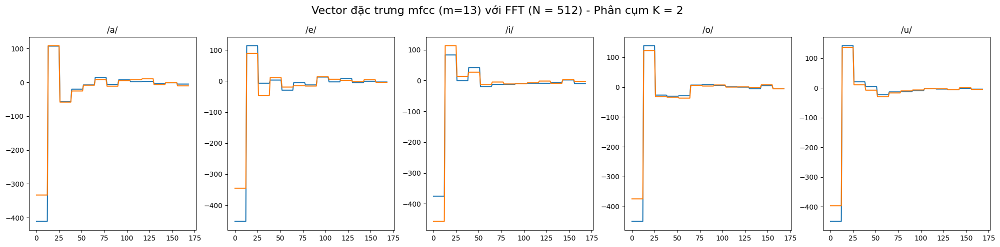

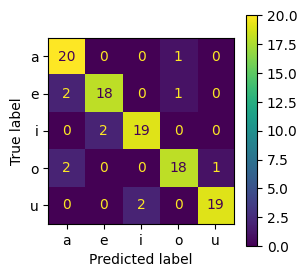

n_fft  =  1024  K =  2
              precision    recall  f1-score   support

           a       0.86      0.90      0.88        21
           e       0.86      0.86      0.86        21
           i       0.90      0.90      0.90        21
           o       0.90      0.86      0.88        21
           u       0.90      0.90      0.90        21

    accuracy                           0.89       105
   macro avg       0.89      0.89      0.89       105
weighted avg       0.89      0.89      0.89       105

0.8857142857142857


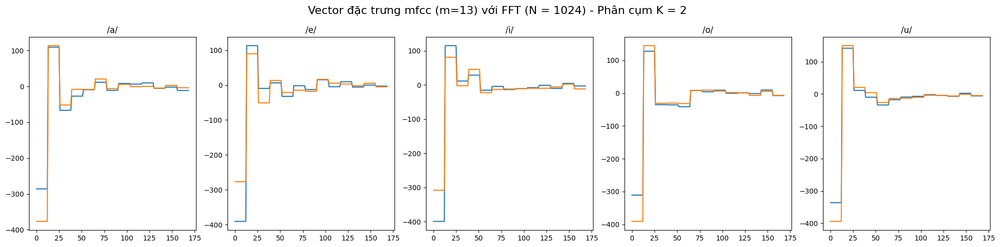

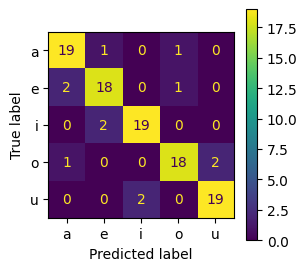

n_fft  =  2048  K =  2
              precision    recall  f1-score   support

           a       0.86      0.90      0.88        21
           e       0.72      0.86      0.78        21
           i       0.89      0.76      0.82        21
           o       0.95      0.90      0.93        21
           u       0.95      0.90      0.93        21

    accuracy                           0.87       105
   macro avg       0.87      0.87      0.87       105
weighted avg       0.87      0.87      0.87       105

0.8666666666666667


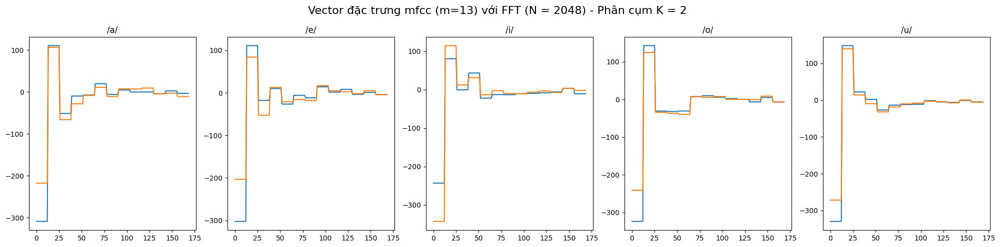

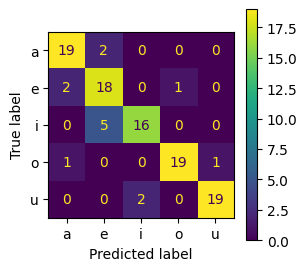

n_fft  =  512  K =  3
              precision    recall  f1-score   support

           a       0.91      0.95      0.93        21
           e       0.86      0.86      0.86        21
           i       0.90      0.86      0.88        21
           o       0.95      0.95      0.95        21
           u       0.90      0.90      0.90        21

    accuracy                           0.90       105
   macro avg       0.90      0.90      0.90       105
weighted avg       0.90      0.90      0.90       105

0.9047619047619048


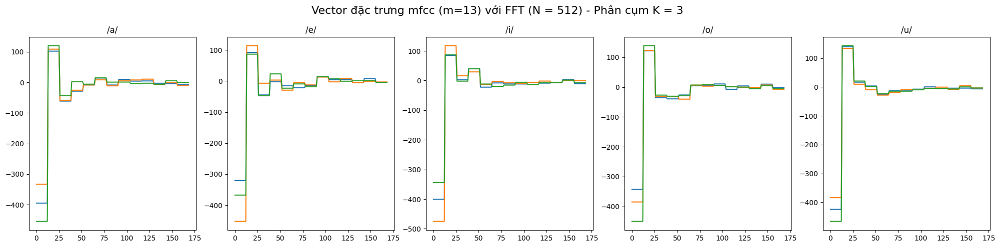

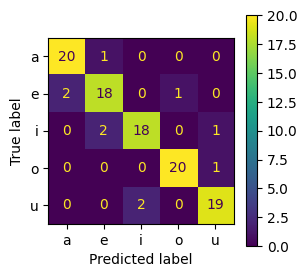

n_fft  =  1024  K =  3
              precision    recall  f1-score   support

           a       0.86      0.90      0.88        21
           e       0.77      0.81      0.79        21
           i       0.90      0.86      0.88        21
           o       0.95      0.95      0.95        21
           u       0.95      0.90      0.93        21

    accuracy                           0.89       105
   macro avg       0.89      0.89      0.89       105
weighted avg       0.89      0.89      0.89       105

0.8857142857142857


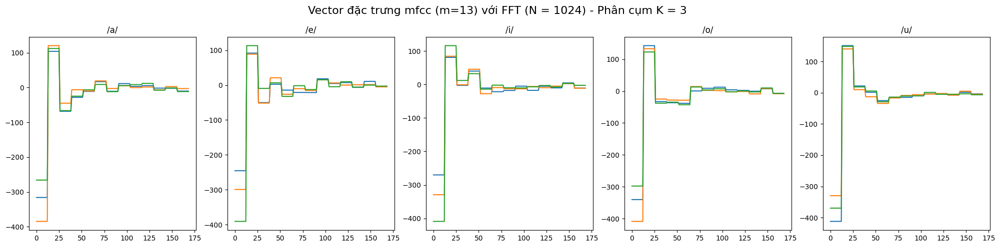

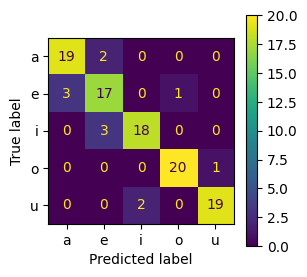

n_fft  =  2048  K =  3
              precision    recall  f1-score   support

           a       0.86      0.90      0.88        21
           e       0.77      0.81      0.79        21
           i       0.89      0.81      0.85        21
           o       0.95      0.95      0.95        21
           u       0.90      0.90      0.90        21

    accuracy                           0.88       105
   macro avg       0.88      0.88      0.88       105
weighted avg       0.88      0.88      0.88       105

0.8761904761904762


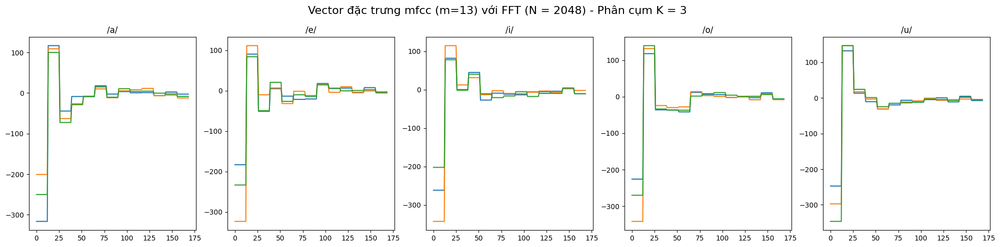

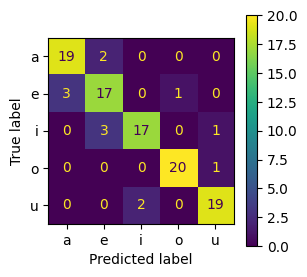

n_fft  =  512  K =  4
              precision    recall  f1-score   support

           a       0.95      0.90      0.93        21
           e       0.87      0.95      0.91        21
           i       0.91      0.95      0.93        21
           o       0.95      0.90      0.93        21
           u       0.95      0.90      0.93        21

    accuracy                           0.92       105
   macro avg       0.93      0.92      0.92       105
weighted avg       0.93      0.92      0.92       105

0.9238095238095239


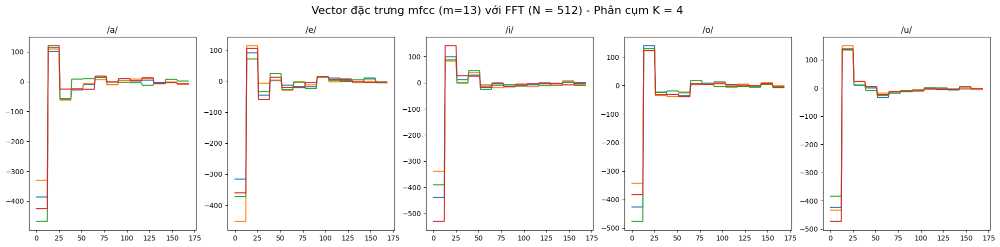

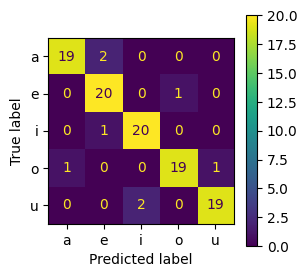

n_fft  =  1024  K =  4
              precision    recall  f1-score   support

           a       0.86      0.86      0.86        21
           e       0.76      0.90      0.83        21
           i       0.90      0.86      0.88        21
           o       0.94      0.81      0.87        21
           u       0.90      0.90      0.90        21

    accuracy                           0.87       105
   macro avg       0.87      0.87      0.87       105
weighted avg       0.87      0.87      0.87       105

0.8666666666666667


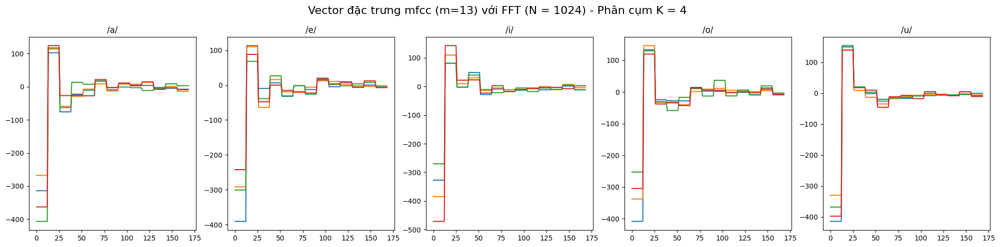

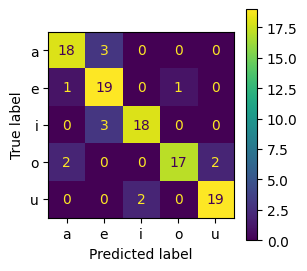

n_fft  =  2048  K =  4
              precision    recall  f1-score   support

           a       0.86      0.86      0.86        21
           e       0.79      0.90      0.84        21
           i       0.95      0.86      0.90        21
           o       0.90      0.86      0.88        21
           u       0.90      0.90      0.90        21

    accuracy                           0.88       105
   macro avg       0.88      0.88      0.88       105
weighted avg       0.88      0.88      0.88       105

0.8761904761904762


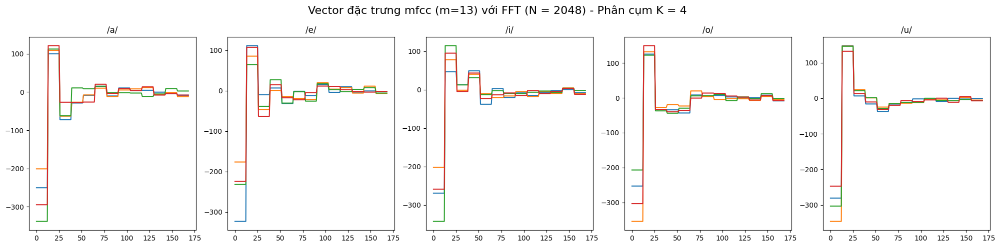

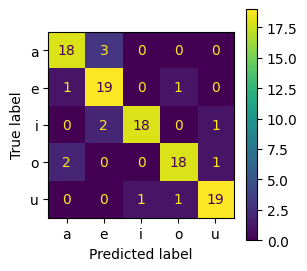

n_fft  =  512  K =  5
              precision    recall  f1-score   support

           a       0.90      0.86      0.88        21
           e       0.83      0.95      0.89        21
           i       0.86      0.90      0.88        21
           o       0.95      0.86      0.90        21
           u       0.90      0.86      0.88        21

    accuracy                           0.89       105
   macro avg       0.89      0.89      0.89       105
weighted avg       0.89      0.89      0.89       105

0.8857142857142857


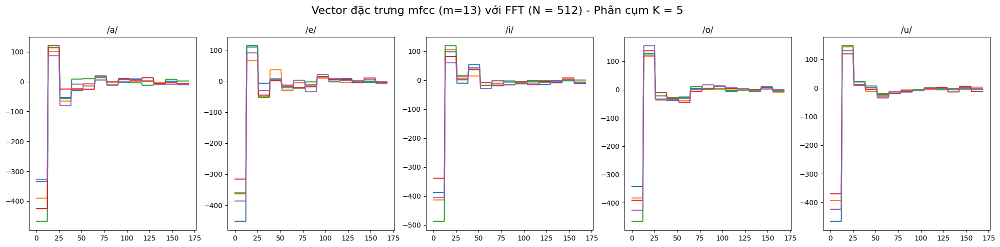

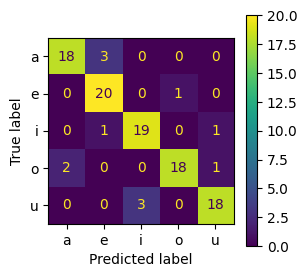

n_fft  =  1024  K =  5
              precision    recall  f1-score   support

           a       0.86      0.90      0.88        21
           e       0.83      0.90      0.86        21
           i       0.86      0.90      0.88        21
           o       0.95      0.86      0.90        21
           u       0.95      0.86      0.90        21

    accuracy                           0.89       105
   macro avg       0.89      0.89      0.89       105
weighted avg       0.89      0.89      0.89       105

0.8857142857142857


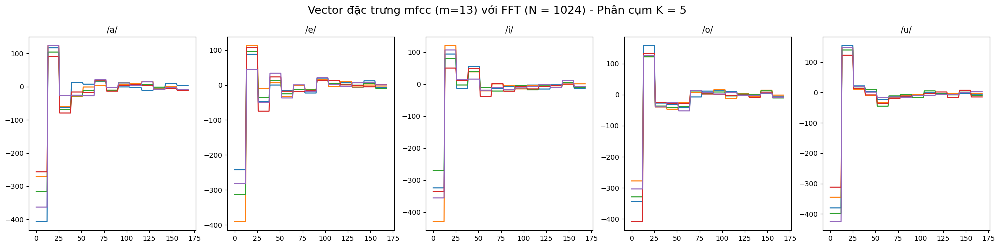

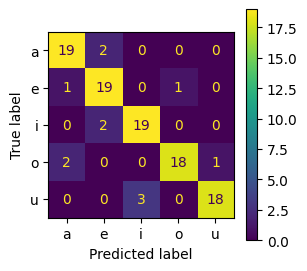

n_fft  =  2048  K =  5
              precision    recall  f1-score   support

           a       0.86      0.86      0.86        21
           e       0.83      0.90      0.86        21
           i       0.90      0.90      0.90        21
           o       0.95      0.86      0.90        21
           u       0.90      0.90      0.90        21

    accuracy                           0.89       105
   macro avg       0.89      0.89      0.89       105
weighted avg       0.89      0.89      0.89       105

0.8857142857142857


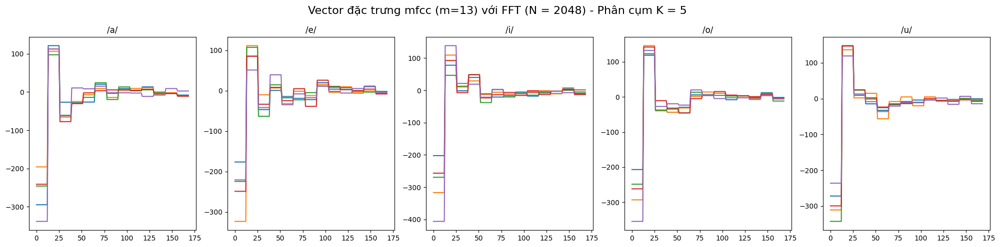

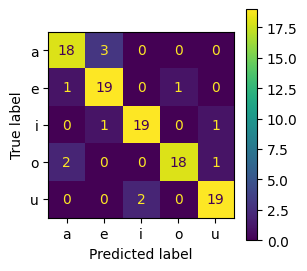

In [21]:
import warnings
warnings.filterwarnings("ignore")

import os
import numpy as np
import librosa
import matplotlib.pyplot as plt
import glob
from sklearn.cluster import KMeans

config = {
    "train_path":"signals/NguyenAmHuanLuyen-16k",
    "valid_path":"signals/NguyenAmKiemThu-16k",
    "nffts": [512, 1024, 2048],
    "am": ["a", "e", "i", "o", "u"],
    "mfcc": 13,
    "K":[2, 3, 4, 5]
}

def euclidean_distance(a, b):
    return abs(a - b)

def load_audio(filename):
    try:
        return librosa.load(filename, sr=None)
    except Exception as e:
        print(f"Cannot load '{filename}': {e}")
        return None

def extract_mfcc(y, sr=22050, n_mfcc=10, n_fft=1024):
    try:
        return librosa.feature.mfcc(y=y, sr=sr, n_mfcc=n_mfcc, n_fft=n_fft)
    except Exception as e:
        print(f"Cannot extract MFCC: {e}")
        return None

def getFeaturesVector(file_path, n_mfcc = 13, n_fft=1024):
  # ==== get label =====================
  filename = os.path.basename(file_path)
  # ====================================

  # === get human say ==================
  human = file_path.split("/")[-2]
  # ====================================

  # Load audio file
  y, fs = librosa.load(file_path, sr=None)

  # Calculate Short-Time Energy (STE)
  window_size = 0.03  # Size of the window (30 ms)
  overlap = 0.5  # Overlap between windows (50%)
  ste_threshold = 0.01  # STE threshold for classifying sound and silence

  # Calculate window parameters
  window_length = int(window_size * fs)
  overlap_length = int(overlap * window_length)

  # Calculate STE for each window
  ste = np.zeros_like(y)
  for i in range(0, len(y) - window_length, window_length - overlap_length):
      window = y[i:i + window_length]
      ste[i:i + window_length] = np.sum(window ** 2)

  # Classify sound and silence
  sound_segments = y[ste > ste_threshold]
  silence_segments = y[ste <= ste_threshold]

  # Create time vectors
  time_sound = np.arange(len(sound_segments)) / fs
  time_silence = np.arange(len(silence_segments)) / fs

  # ==========================
  offset = sound_segments.shape[0]
  # x1 = sound_segments[int(offset * 1/3): int(offset * 2/3)]
  x1 = sound_segments
  # t = time_sound[int(offset * 1/3): int(offset * 2/3)]
  t = time_sound
  time_step = 0.03 # = 30ms
  m = len(np.arange(t[0], t[-1], time_step))

  features = np.zeros((n_mfcc, n_mfcc))
  for (i) in range(m):
    frame = x1[int(x1.shape[0] * i/m ): int(x1.shape[0] * (i + 1)/m)]
    features += extract_mfcc(frame, fs, n_mfcc, n_fft)
  return features / m


def modelPredictFeature2(features, am_key, K, n_mfcc, data, m):
  cluster_dict = {i: np.where(m[am_key].labels_ == i)[0] for i in range(m[am_key].n_clusters)}
  # cluster_id = m[am_key].predict([features])[0]

  features_means = []
  for (id) in range(K):
    features_mean = np.zeros(n_mfcc * n_mfcc)
    for human_index in cluster_dict[id]:
      features_mean += data[am_key][human_index]

    features_mean /= cluster_dict[id].shape[0]
    features_means.append(features_mean)
  return features_means


for K in config["K"]:
  for n_fft in config["nffts"]:
    data = {
      "a":[],
      "e":[],
      "i":[],
      "o":[],
      "u":[],
    }

    for path in glob.glob(config["train_path"] + "/**/*.wav"):
      label = os.path.basename(path).split(".")[0]
      features = getFeaturesVector(path, n_mfcc=config["mfcc"], n_fft=n_fft)
      data[label].append(features)

    for a in config["am"]:
      nsamples, nx, ny = np.array(data[a]).shape
      data[a] = np.array(data[a]).reshape((nsamples,nx*ny))
    # ================
    m = {
      "a":KMeans(n_clusters=K),
      "e":KMeans(n_clusters=K),
      "i":KMeans(n_clusters=K),
      "o":KMeans(n_clusters=K),
      "u":KMeans(n_clusters=K),
    }

    for a in config["am"]:
      m[a].fit(data[a])

    plt.rcParams["figure.figsize"] = (20, 5)
    fig, axs = plt.subplots(1, 5)
    fig.figsize = (20,30)
    fig.suptitle("Vector đặc trưng mfcc (m={}) với FFT (N = {}) - Phân cụm K = {}".format(config["mfcc"], n_fft, K), fontsize=16)
    i_am_key = 0
    for am_key in config["am"]:
      fmean = modelPredictFeature2(features, am_key, K, config["mfcc"], data, m)
      for id in range(K):
        axs[i_am_key].set_title(f"/{am_key}/")
        axs[i_am_key].plot(fmean[id], label = f"/{am_key}/ - cụm {id}")
      i_am_key = i_am_key + 1

    fig.tight_layout()
    fig.show()

    y_pred = []
    y_true = []

    for path in glob.glob(config["valid_path"] + "/**/*.wav"):
      label = os.path.basename(path).split(".")[0]
      features = getFeaturesVector(path, n_mfcc=config["mfcc"], n_fft=n_fft)
      features = np.array(features).reshape((config["mfcc"]*config["mfcc"]))

      pred = []
      for am_key in config["am"]:
        fmean = modelPredictFeature2(features, am_key, K, config["mfcc"], data, m)
        smean = []
        for id in range(K):
          s = 0
          for (i) in range(config["mfcc"] * config["mfcc"]):
            s += euclidean_distance(fmean[id][i], features[i])
          smean.append(s)
        pred.append(np.min(smean))

      y_pred.append(config["am"][np.argmin(pred)])
      y_true.append(label)

    print("n_fft  = ", n_fft, " K = ", K)
    from sklearn.metrics import classification_report, accuracy_score
    print(classification_report(y_true, y_pred))
    print(accuracy_score(y_true, y_pred))

    from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay
    cm = confusion_matrix(y_true, y_pred, labels=config["am"])
    disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=config["am"])
    # disp.plot()
    # plt.show()

    fig, ax = plt.subplots(figsize=(10,10))
    disp.plot(ax=ax)
    fig.set_figwidth(3)
    fig.set_figheight(3)
    fig.show()
    plt.show()

n_fft  =  512  K =  2
              precision    recall  f1-score   support

           a       0.78      0.86      0.82        21
           e       0.86      0.86      0.86        21
           i       1.00      0.95      0.98        21
           o       0.85      0.81      0.83        21
           u       0.95      0.95      0.95        21

    accuracy                           0.89       105
   macro avg       0.89      0.89      0.89       105
weighted avg       0.89      0.89      0.89       105

0.8857142857142857


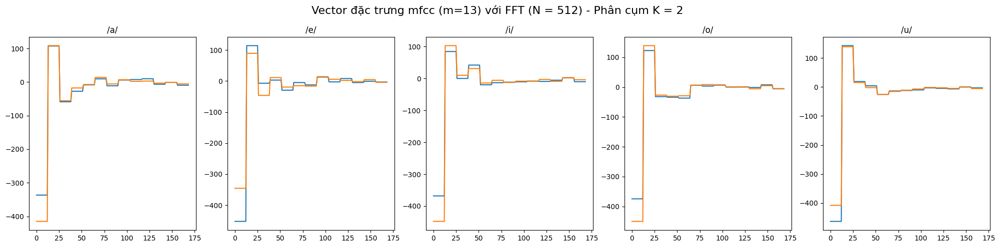

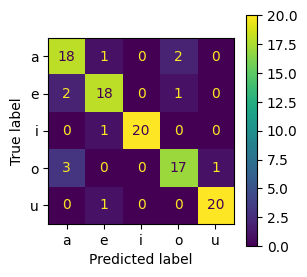

n_fft  =  1024  K =  2
              precision    recall  f1-score   support

           a       0.86      0.90      0.88        21
           e       0.86      0.86      0.86        21
           i       0.90      0.90      0.90        21
           o       0.90      0.86      0.88        21
           u       0.90      0.90      0.90        21

    accuracy                           0.89       105
   macro avg       0.89      0.89      0.89       105
weighted avg       0.89      0.89      0.89       105

0.8857142857142857


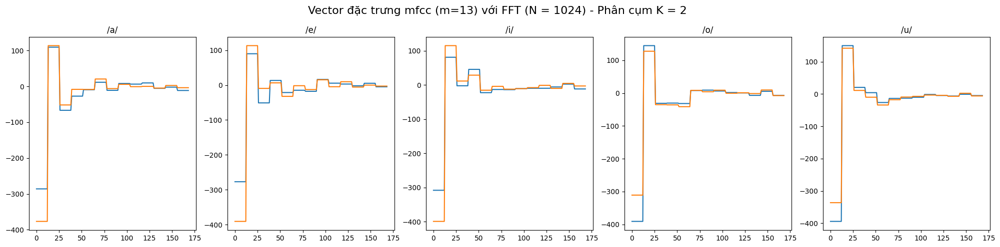

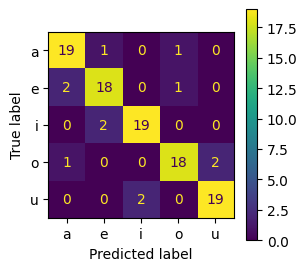

n_fft  =  2048  K =  2
              precision    recall  f1-score   support

           a       0.86      0.90      0.88        21
           e       0.72      0.86      0.78        21
           i       0.89      0.76      0.82        21
           o       0.95      0.90      0.93        21
           u       0.95      0.90      0.93        21

    accuracy                           0.87       105
   macro avg       0.87      0.87      0.87       105
weighted avg       0.87      0.87      0.87       105

0.8666666666666667


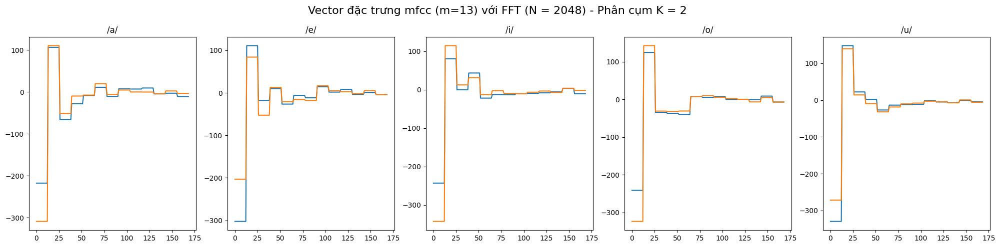

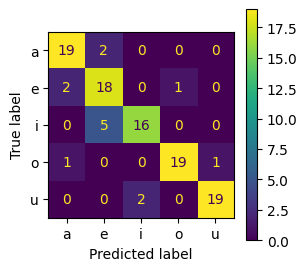

n_fft  =  512  K =  3
              precision    recall  f1-score   support

           a       0.91      0.95      0.93        21
           e       0.86      0.86      0.86        21
           i       0.90      0.86      0.88        21
           o       0.95      0.95      0.95        21
           u       0.90      0.90      0.90        21

    accuracy                           0.90       105
   macro avg       0.90      0.90      0.90       105
weighted avg       0.90      0.90      0.90       105

0.9047619047619048


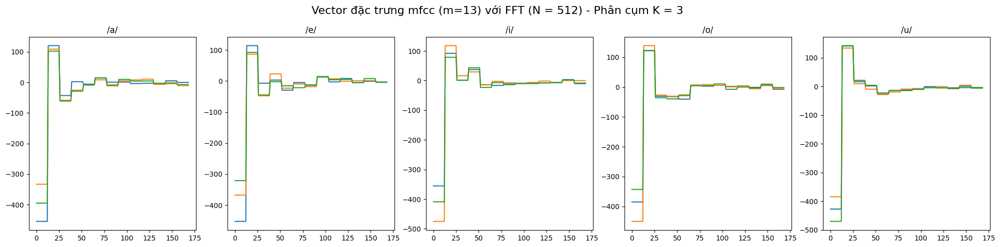

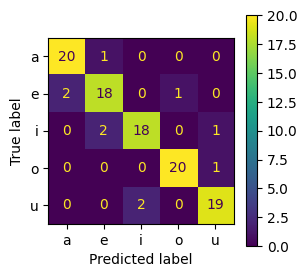

n_fft  =  1024  K =  3
              precision    recall  f1-score   support

           a       0.86      0.90      0.88        21
           e       0.77      0.81      0.79        21
           i       0.90      0.86      0.88        21
           o       0.95      0.95      0.95        21
           u       0.95      0.90      0.93        21

    accuracy                           0.89       105
   macro avg       0.89      0.89      0.89       105
weighted avg       0.89      0.89      0.89       105

0.8857142857142857


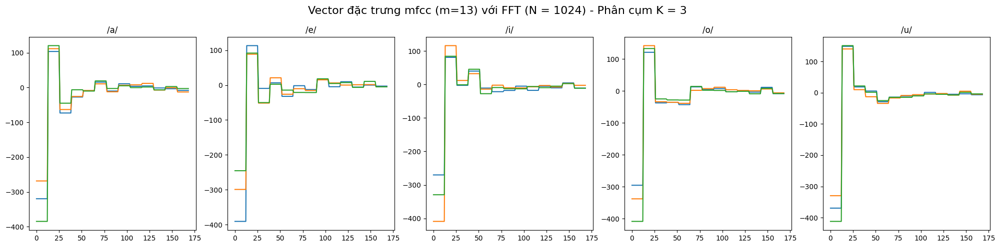

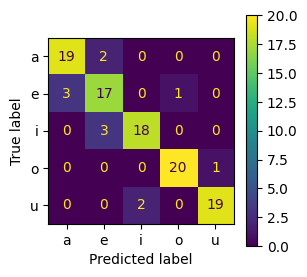

n_fft  =  2048  K =  3
              precision    recall  f1-score   support

           a       0.86      0.90      0.88        21
           e       0.77      0.81      0.79        21
           i       0.89      0.81      0.85        21
           o       0.95      0.95      0.95        21
           u       0.90      0.90      0.90        21

    accuracy                           0.88       105
   macro avg       0.88      0.88      0.88       105
weighted avg       0.88      0.88      0.88       105

0.8761904761904762


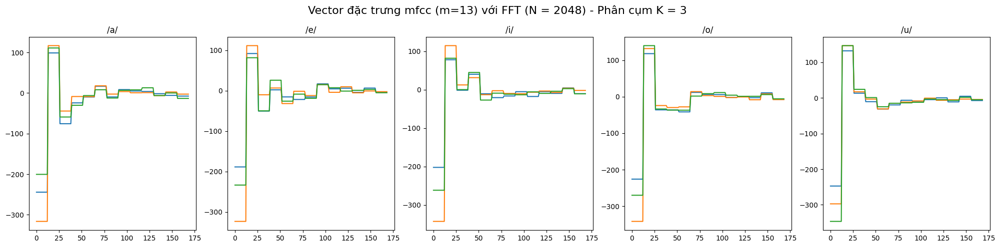

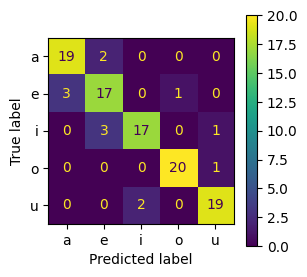

n_fft  =  512  K =  4
              precision    recall  f1-score   support

           a       0.90      0.90      0.90        21
           e       0.86      0.90      0.88        21
           i       0.86      0.90      0.88        21
           o       0.95      0.86      0.90        21
           u       0.90      0.90      0.90        21

    accuracy                           0.90       105
   macro avg       0.90      0.90      0.90       105
weighted avg       0.90      0.90      0.90       105

0.8952380952380953


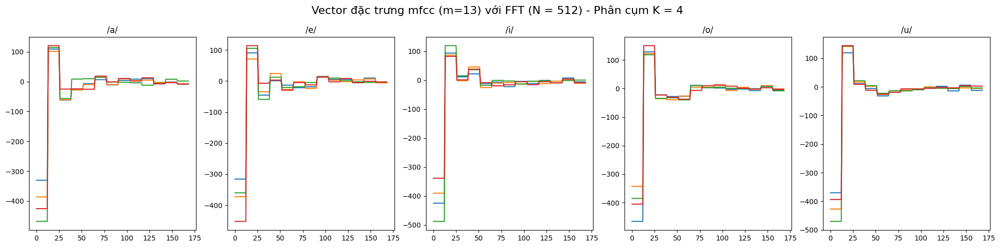

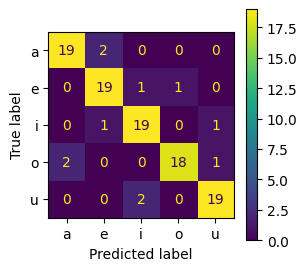

n_fft  =  1024  K =  4
              precision    recall  f1-score   support

           a       0.78      0.86      0.82        21
           e       0.76      0.90      0.83        21
           i       0.90      0.86      0.88        21
           o       1.00      0.81      0.89        21
           u       0.95      0.90      0.93        21

    accuracy                           0.87       105
   macro avg       0.88      0.87      0.87       105
weighted avg       0.88      0.87      0.87       105

0.8666666666666667


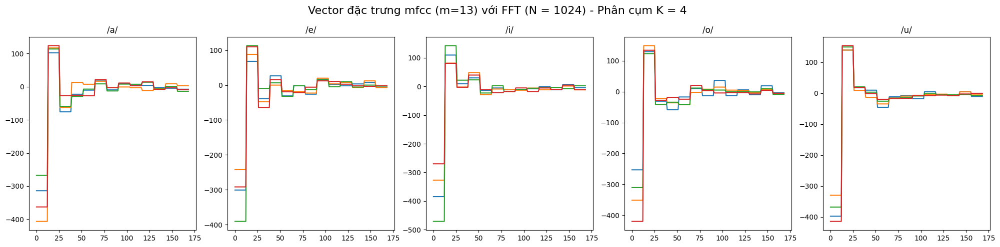

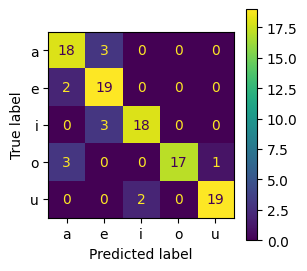

n_fft  =  2048  K =  4
              precision    recall  f1-score   support

           a       0.90      0.86      0.88        21
           e       0.79      0.90      0.84        21
           i       0.95      0.86      0.90        21
           o       0.90      0.90      0.90        21
           u       0.90      0.90      0.90        21

    accuracy                           0.89       105
   macro avg       0.89      0.89      0.89       105
weighted avg       0.89      0.89      0.89       105

0.8857142857142857


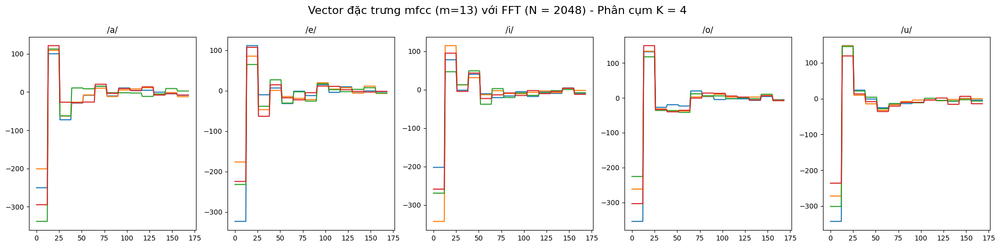

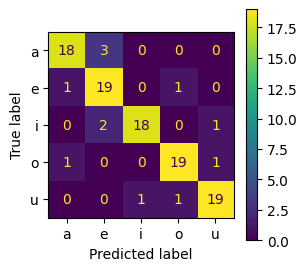

n_fft  =  512  K =  5
              precision    recall  f1-score   support

           a       0.90      0.86      0.88        21
           e       0.83      0.95      0.89        21
           i       0.90      0.90      0.90        21
           o       0.95      0.86      0.90        21
           u       0.90      0.90      0.90        21

    accuracy                           0.90       105
   macro avg       0.90      0.90      0.90       105
weighted avg       0.90      0.90      0.90       105

0.8952380952380953


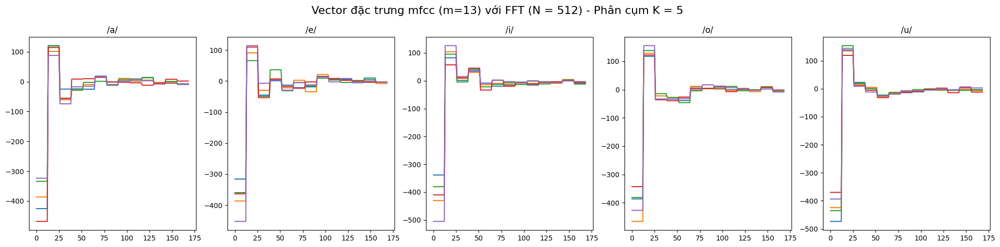

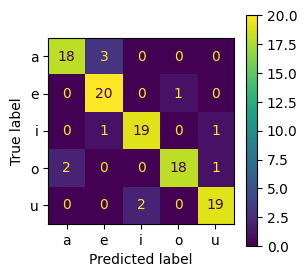

n_fft  =  1024  K =  5
              precision    recall  f1-score   support

           a       0.85      0.81      0.83        21
           e       0.82      0.86      0.84        21
           i       0.87      0.95      0.91        21
           o       0.90      0.90      0.90        21
           u       0.95      0.86      0.90        21

    accuracy                           0.88       105
   macro avg       0.88      0.88      0.88       105
weighted avg       0.88      0.88      0.88       105

0.8761904761904762


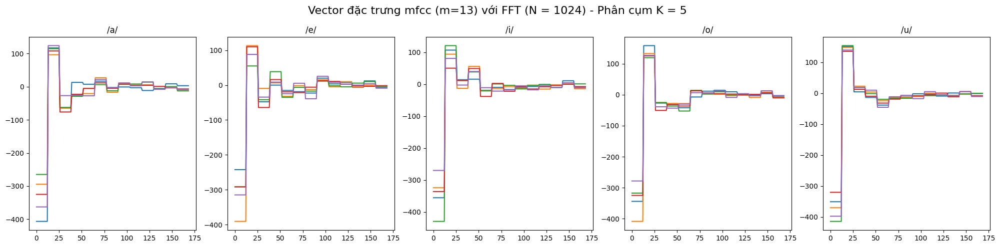

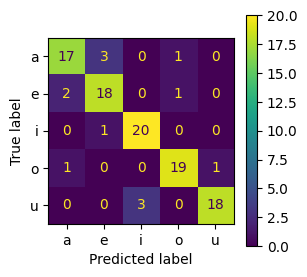

n_fft  =  2048  K =  5
              precision    recall  f1-score   support

           a       0.95      0.86      0.90        21
           e       0.83      0.95      0.89        21
           i       0.90      0.90      0.90        21
           o       1.00      0.95      0.98        21
           u       0.90      0.90      0.90        21

    accuracy                           0.91       105
   macro avg       0.92      0.91      0.91       105
weighted avg       0.92      0.91      0.91       105

0.9142857142857143


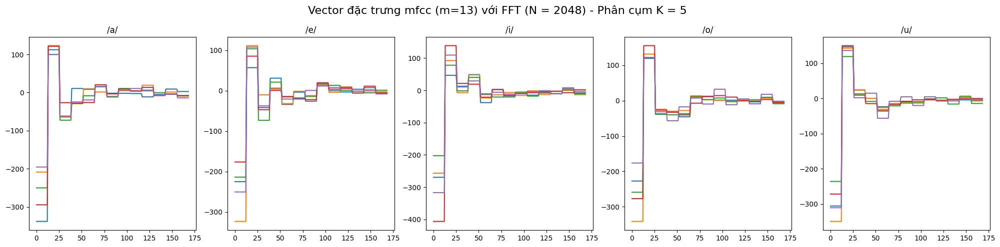

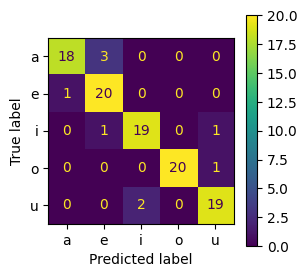

In [22]:
import warnings
warnings.filterwarnings("ignore")

import os
import numpy as np
import librosa
import matplotlib.pyplot as plt
import glob
from sklearn.cluster import KMeans

config = {
    "train_path":"signals/NguyenAmHuanLuyen-16k",
    "valid_path":"signals/NguyenAmKiemThu-16k",
    "nffts": [512, 1024, 2048],
    "am": ["a", "e", "i", "o", "u"],
    "mfcc": 13,
    "K":[2, 3, 4, 5]
}

def euclidean_distance(a, b):
    return abs(a - b)

def load_audio(filename):
    try:
        return librosa.load(filename, sr=None)
    except Exception as e:
        print(f"Cannot load '{filename}': {e}")
        return None

def extract_mfcc(y, sr=22050, n_mfcc=10, n_fft=1024):
    try:
        return librosa.feature.mfcc(y=y, sr=sr, n_mfcc=n_mfcc, n_fft=n_fft)
    except Exception as e:
        print(f"Cannot extract MFCC: {e}")
        return None

def getFeaturesVector(file_path, n_mfcc = 13, n_fft=1024):
  # ==== get label =====================
  filename = os.path.basename(file_path)
  # ====================================

  # === get human say ==================
  human = file_path.split("/")[-2]
  # ====================================

  # Load audio file
  y, fs = librosa.load(file_path, sr=None)

  # Calculate Short-Time Energy (STE)
  window_size = 0.03  # Size of the window (30 ms)
  overlap = 0.5  # Overlap between windows (50%)
  ste_threshold = 0.01  # STE threshold for classifying sound and silence

  # Calculate window parameters
  window_length = int(window_size * fs)
  overlap_length = int(overlap * window_length)

  # Calculate STE for each window
  ste = np.zeros_like(y)
  for i in range(0, len(y) - window_length, window_length - overlap_length):
      window = y[i:i + window_length]
      ste[i:i + window_length] = np.sum(window ** 2)

  # Classify sound and silence
  sound_segments = y[ste > ste_threshold]
  silence_segments = y[ste <= ste_threshold]

  # Create time vectors
  time_sound = np.arange(len(sound_segments)) / fs
  time_silence = np.arange(len(silence_segments)) / fs

  # ==========================
  offset = sound_segments.shape[0]
  # x1 = sound_segments[int(offset * 1/3): int(offset * 2/3)]
  x1 = sound_segments
  # t = time_sound[int(offset * 1/3): int(offset * 2/3)]
  t = time_sound
  time_step = 0.03 # = 30ms
  m = len(np.arange(t[0], t[-1], time_step))

  features = np.zeros((n_mfcc, n_mfcc))
  for (i) in range(m):
    frame = x1[int(x1.shape[0] * i/m ): int(x1.shape[0] * (i + 1)/m)]
    features += extract_mfcc(frame, fs, n_mfcc, n_fft)
  return features / m


def modelPredictFeature2(features, am_key, K, n_mfcc, data, m):
  cluster_dict = {i: np.where(m[am_key].labels_ == i)[0] for i in range(m[am_key].n_clusters)}
  # cluster_id = m[am_key].predict([features])[0]

  features_means = []
  for (id) in range(K):
    features_mean = np.zeros(n_mfcc * n_mfcc)
    for human_index in cluster_dict[id]:
      features_mean += data[am_key][human_index]

    features_mean /= cluster_dict[id].shape[0]
    features_means.append(features_mean)
  return features_means


for K in config["K"]:
  for n_fft in config["nffts"]:
    data = {
      "a":[],
      "e":[],
      "i":[],
      "o":[],
      "u":[],
    }

    for path in glob.glob(config["train_path"] + "/**/*.wav"):
      label = os.path.basename(path).split(".")[0]
      features = getFeaturesVector(path, n_mfcc=config["mfcc"], n_fft=n_fft)
      data[label].append(features)

    for a in config["am"]:
      nsamples, nx, ny = np.array(data[a]).shape
      data[a] = np.array(data[a]).reshape((nsamples,nx*ny))
    # ================
    m = {
      "a":KMeans(n_clusters=K),
      "e":KMeans(n_clusters=K),
      "i":KMeans(n_clusters=K),
      "o":KMeans(n_clusters=K),
      "u":KMeans(n_clusters=K),
    }

    for a in config["am"]:
      m[a].fit(data[a])

    plt.rcParams["figure.figsize"] = (20, 5)
    fig, axs = plt.subplots(1, 5)
    fig.figsize = (20,30)
    fig.suptitle("Vector đặc trưng mfcc (m={}) với FFT (N = {}) - Phân cụm K = {}".format(config["mfcc"], n_fft, K), fontsize=16)
    i_am_key = 0
    for am_key in config["am"]:
      fmean = modelPredictFeature2(features, am_key, K, config["mfcc"], data, m)
      for id in range(K):
        axs[i_am_key].set_title(f"/{am_key}/")
        axs[i_am_key].plot(fmean[id], label = f"/{am_key}/ - cụm {id}")
      i_am_key = i_am_key + 1

    fig.tight_layout()
    fig.show()

    y_pred = []
    y_true = []

    for path in glob.glob(config["valid_path"] + "/**/*.wav"):
      label = os.path.basename(path).split(".")[0]
      features = getFeaturesVector(path, n_mfcc=config["mfcc"], n_fft=n_fft)
      features = np.array(features).reshape((config["mfcc"]*config["mfcc"]))

      pred = []
      for am_key in config["am"]:
        fmean = modelPredictFeature2(features, am_key, K, config["mfcc"], data, m)
        smean = []
        for id in range(K):
          s = 0
          for (i) in range(config["mfcc"] * config["mfcc"]):
            s += euclidean_distance(fmean[id][i], features[i])
          smean.append(s)
        pred.append(np.min(smean))

      y_pred.append(config["am"][np.argmin(pred)])
      y_true.append(label)

    print("n_fft  = ", n_fft, " K = ", K)
    from sklearn.metrics import classification_report, accuracy_score
    print(classification_report(y_true, y_pred))
    print(accuracy_score(y_true, y_pred))

    from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay
    cm = confusion_matrix(y_true, y_pred, labels=config["am"])
    disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=config["am"])
    # disp.plot()
    # plt.show()

    fig, ax = plt.subplots(figsize=(10,10))
    disp.plot(ax=ax)
    fig.set_figwidth(3)
    fig.set_figheight(3)
    fig.show()
    plt.show()

# Bài 3 - MFCC (with KNN)

n_fft  =  512
              precision    recall  f1-score   support

           a       0.95      0.95      0.95        21
           e       0.94      0.81      0.87        21
           i       1.00      0.90      0.95        21
           o       0.87      0.95      0.91        21
           u       0.83      0.95      0.89        21

    accuracy                           0.91       105
   macro avg       0.92      0.91      0.91       105
weighted avg       0.92      0.91      0.91       105

0.9142857142857143


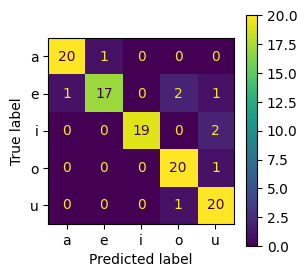

n_fft  =  1024
              precision    recall  f1-score   support

           a       0.91      0.95      0.93        21
           e       0.94      0.81      0.87        21
           i       0.95      0.90      0.93        21
           o       0.91      0.95      0.93        21
           u       0.87      0.95      0.91        21

    accuracy                           0.91       105
   macro avg       0.92      0.91      0.91       105
weighted avg       0.92      0.91      0.91       105

0.9142857142857143


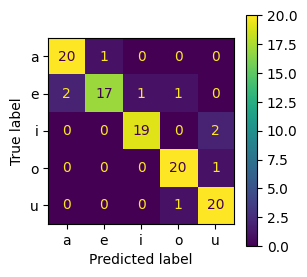

n_fft  =  2048
              precision    recall  f1-score   support

           a       0.95      0.95      0.95        21
           e       0.95      0.86      0.90        21
           i       1.00      0.90      0.95        21
           o       0.86      0.90      0.88        21
           u       0.83      0.95      0.89        21

    accuracy                           0.91       105
   macro avg       0.92      0.91      0.91       105
weighted avg       0.92      0.91      0.91       105

0.9142857142857143


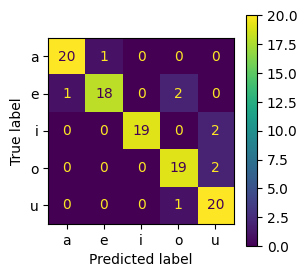

In [23]:
import warnings
warnings.filterwarnings("ignore")

import os
import numpy as np
import librosa
import matplotlib.pyplot as plt
import glob
from sklearn import neighbors

config = {
    "train_path":"signals/NguyenAmHuanLuyen-16k",
    "valid_path":"signals/NguyenAmKiemThu-16k",
    "nffts": [512, 1024, 2048],
    "am": ["a", "e", "i", "o", "u"],
    "mfcc": 13,
    "n_neighbors": 10,
}

def euclidean_distance(a, b):
    return abs(a - b)

def load_audio(filename):
    try:
        return librosa.load(filename, sr=None)
    except Exception as e:
        print(f"Cannot load '{filename}': {e}")
        return None

def extract_mfcc(y, sr=22050, n_mfcc=10, n_fft=1024):
    try:
        return librosa.feature.mfcc(y=y, sr=sr, n_mfcc=n_mfcc, n_fft=n_fft)
    except Exception as e:
        print(f"Cannot extract MFCC: {e}")
        return None

def getFeaturesVector(file_path, n_mfcc = 13, n_fft=1024):
  # ==== get label =====================
  filename = os.path.basename(file_path)
  # ====================================

  # === get human say ==================
  human = file_path.split("/")[-2]
  # ====================================

  # Load audio file
  y, fs = librosa.load(file_path, sr=None)

  # Calculate Short-Time Energy (STE)
  window_size = 0.03  # Size of the window (30 ms)
  overlap = 0.5  # Overlap between windows (50%)
  ste_threshold = 0.01  # STE threshold for classifying sound and silence

  # Calculate window parameters
  window_length = int(window_size * fs)
  overlap_length = int(overlap * window_length)

  # Calculate STE for each window
  ste = np.zeros_like(y)
  for i in range(0, len(y) - window_length, window_length - overlap_length):
      window = y[i:i + window_length]
      ste[i:i + window_length] = np.sum(window ** 2)

  # Classify sound and silence
  sound_segments = y[ste > ste_threshold]
  silence_segments = y[ste <= ste_threshold]

  # Create time vectors
  time_sound = np.arange(len(sound_segments)) / fs
  time_silence = np.arange(len(silence_segments)) / fs

  # ==========================
  offset = sound_segments.shape[0]
  # x1 = sound_segments[int(offset * 1/3): int(offset * 2/3)]
  x1 = sound_segments
  # t = time_sound[int(offset * 1/3): int(offset * 2/3)]
  t = time_sound
  time_step = 0.03 # = 30ms
  m = len(np.arange(t[0], t[-1], time_step))

  features = np.zeros((n_mfcc, n_mfcc))
  for (i) in range(m):
    frame = x1[int(x1.shape[0] * i/m ): int(x1.shape[0] * (i + 1)/m)]
    features += extract_mfcc(frame, fs, n_mfcc, n_fft)
  return features / m

for n_fft in config["nffts"]:
  data = {
    "a":[],
    "e":[],
    "i":[],
    "o":[],
    "u":[],
  }

  X, Y = [], []
  for path in glob.glob(config["train_path"] + "/**/*.wav"):
    label = os.path.basename(path).split(".")[0]
    features = getFeaturesVector(path, n_mfcc=config["mfcc"], n_fft = n_fft)
    X.append(features)
    Y.append(label)

  X = np.array(X)
  nsamples, nx, ny = X.shape
  X = X.reshape((nsamples,nx*ny))

  # ================
  clf = neighbors.KNeighborsClassifier(n_neighbors = config["n_neighbors"])
  clf.fit(X, Y)


  X_valid = []
  Y_valid = []
  for path in glob.glob(config["valid_path"]+"/**/*.wav"):
      label = os.path.basename(path).split(".")[0]
      features = getFeaturesVector(path, n_mfcc=config["mfcc"], n_fft = n_fft)
      X_valid.append(features)
      Y_valid.append(label)

  nsamples, nx, ny = np.array(X_valid).shape
  X_valid = np.array(X_valid).reshape((nsamples,nx*ny))

  print("n_fft  = ", n_fft)
  from sklearn.metrics import classification_report, accuracy_score
  print(classification_report(Y_valid, clf.predict(X_valid)))
  print(accuracy_score(Y_valid, clf.predict(X_valid)))

  from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay
  cm = confusion_matrix(Y_valid, clf.predict(X_valid), labels=config["am"])
  disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=config["am"])
  # disp.plot()
  # plt.show()
  fig, ax = plt.subplots(figsize=(10,10))
  disp.plot(ax=ax)
  fig.set_figwidth(3)
  fig.set_figheight(3)
  fig.show()
  plt.show()

# Bài 3 - MFCC (with Catboost)

In [24]:
%pip install catboost

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 98.7/98.7 MB 10.4 MB/s eta 0:00:00


Learning rate set to 0.493633
0:	learn: 1.3272821	total: 155ms	remaining: 15.4s
1:	learn: 1.0988076	total: 227ms	remaining: 11.1s
2:	learn: 0.9203665	total: 305ms	remaining: 9.86s
3:	learn: 0.7725886	total: 440ms	remaining: 10.6s
4:	learn: 0.6862513	total: 604ms	remaining: 11.5s
5:	learn: 0.5989303	total: 744ms	remaining: 11.7s
6:	learn: 0.5258738	total: 889ms	remaining: 11.8s
7:	learn: 0.4703362	total: 969ms	remaining: 11.1s
8:	learn: 0.4107313	total: 1.11s	remaining: 11.2s
9:	learn: 0.3746933	total: 1.23s	remaining: 11.1s
10:	learn: 0.3421991	total: 1.37s	remaining: 11.1s
11:	learn: 0.3168850	total: 1.46s	remaining: 10.7s
12:	learn: 0.2918035	total: 1.6s	remaining: 10.7s
13:	learn: 0.2670583	total: 1.73s	remaining: 10.6s
14:	learn: 0.2425695	total: 1.84s	remaining: 10.4s
15:	learn: 0.2244720	total: 1.95s	remaining: 10.3s
16:	learn: 0.2030684	total: 2.03s	remaining: 9.92s
17:	learn: 0.1904784	total: 2.09s	remaining: 9.53s
18:	learn: 0.1760915	total: 2.2s	remaining: 9.39s
19:	learn: 0.

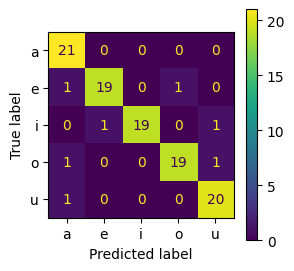

Learning rate set to 0.493633
0:	learn: 1.3026428	total: 107ms	remaining: 10.5s
1:	learn: 1.0773536	total: 181ms	remaining: 8.86s
2:	learn: 0.8921305	total: 243ms	remaining: 7.85s
3:	learn: 0.7782900	total: 327ms	remaining: 7.86s
4:	learn: 0.6967969	total: 393ms	remaining: 7.46s
5:	learn: 0.6041963	total: 444ms	remaining: 6.96s
6:	learn: 0.5379011	total: 488ms	remaining: 6.49s
7:	learn: 0.4786157	total: 531ms	remaining: 6.1s
8:	learn: 0.4260175	total: 574ms	remaining: 5.8s
9:	learn: 0.3797742	total: 616ms	remaining: 5.55s
10:	learn: 0.3425471	total: 663ms	remaining: 5.36s
11:	learn: 0.3115611	total: 705ms	remaining: 5.17s
12:	learn: 0.2834619	total: 747ms	remaining: 5s
13:	learn: 0.2592485	total: 788ms	remaining: 4.84s
14:	learn: 0.2364492	total: 832ms	remaining: 4.71s
15:	learn: 0.2181785	total: 876ms	remaining: 4.6s
16:	learn: 0.2015215	total: 930ms	remaining: 4.54s
17:	learn: 0.1871905	total: 974ms	remaining: 4.44s
18:	learn: 0.1746743	total: 1.02s	remaining: 4.34s
19:	learn: 0.1604

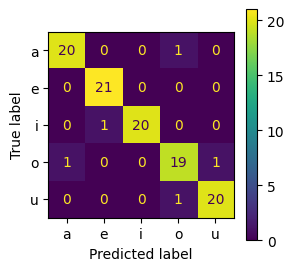

Learning rate set to 0.493633
0:	learn: 1.3077459	total: 155ms	remaining: 15.4s
1:	learn: 1.0697584	total: 294ms	remaining: 14.4s
2:	learn: 0.9194188	total: 372ms	remaining: 12s
3:	learn: 0.7979291	total: 487ms	remaining: 11.7s
4:	learn: 0.6999687	total: 582ms	remaining: 11.1s
5:	learn: 0.6117521	total: 643ms	remaining: 10.1s
6:	learn: 0.5363177	total: 718ms	remaining: 9.53s
7:	learn: 0.4721503	total: 778ms	remaining: 8.95s
8:	learn: 0.4289029	total: 863ms	remaining: 8.73s
9:	learn: 0.3858899	total: 994ms	remaining: 8.95s
10:	learn: 0.3358009	total: 1.11s	remaining: 8.96s
11:	learn: 0.3053279	total: 1.2s	remaining: 8.81s
12:	learn: 0.2765998	total: 1.29s	remaining: 8.65s
13:	learn: 0.2528682	total: 1.41s	remaining: 8.66s
14:	learn: 0.2323432	total: 1.48s	remaining: 8.41s
15:	learn: 0.2172287	total: 1.65s	remaining: 8.69s
16:	learn: 0.2010029	total: 1.75s	remaining: 8.57s
17:	learn: 0.1865222	total: 1.83s	remaining: 8.35s
18:	learn: 0.1723110	total: 1.92s	remaining: 8.17s
19:	learn: 0.1

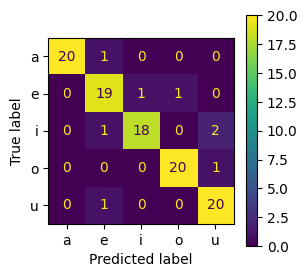

In [25]:
import warnings
warnings.filterwarnings("ignore")

import os
import numpy as np
import librosa
import matplotlib.pyplot as plt
import glob
from catboost import CatBoostClassifier

config = {
    "train_path":"signals/NguyenAmHuanLuyen-16k",
    "valid_path":"signals/NguyenAmKiemThu-16k",
    "nffts": [512, 1024, 2048],
    "am": ["a", "e", "i", "o", "u"],
    "mfcc": 13,
    "n_estimators": 100,
}

def euclidean_distance(a, b):
    return abs(a - b)

def load_audio(filename):
    try:
        return librosa.load(filename, sr=None)
    except Exception as e:
        print(f"Cannot load '{filename}': {e}")
        return None

def extract_mfcc(y, sr=22050, n_mfcc=10, n_fft=1024):
    try:
        return librosa.feature.mfcc(y=y, sr=sr, n_mfcc=n_mfcc, n_fft=n_fft)
    except Exception as e:
        print(f"Cannot extract MFCC: {e}")
        return None

def getFeaturesVector(file_path, n_mfcc = 13, n_fft=1024):
  # ==== get label =====================
  filename = os.path.basename(file_path)
  # ====================================

  # === get human say ==================
  human = file_path.split("/")[-2]
  # ====================================

  # Load audio file
  y, fs = librosa.load(file_path, sr=None)

  # Calculate Short-Time Energy (STE)
  window_size = 0.03  # Size of the window (30 ms)
  overlap = 0.5  # Overlap between windows (50%)
  ste_threshold = 0.01  # STE threshold for classifying sound and silence

  # Calculate window parameters
  window_length = int(window_size * fs)
  overlap_length = int(overlap * window_length)

  # Calculate STE for each window
  ste = np.zeros_like(y)
  for i in range(0, len(y) - window_length, window_length - overlap_length):
      window = y[i:i + window_length]
      ste[i:i + window_length] = np.sum(window ** 2)

  # Classify sound and silence
  sound_segments = y[ste > ste_threshold]
  silence_segments = y[ste <= ste_threshold]

  # Create time vectors
  time_sound = np.arange(len(sound_segments)) / fs
  time_silence = np.arange(len(silence_segments)) / fs

  # ==========================
  offset = sound_segments.shape[0]
  # x1 = sound_segments[int(offset * 1/3): int(offset * 2/3)]
  x1 = sound_segments
  # t = time_sound[int(offset * 1/3): int(offset * 2/3)]
  t = time_sound
  time_step = 0.03 # = 30ms
  m = len(np.arange(t[0], t[-1], time_step))

  features = np.zeros((n_mfcc, n_mfcc))
  for (i) in range(m):
    frame = x1[int(x1.shape[0] * i/m ): int(x1.shape[0] * (i + 1)/m)]
    features += extract_mfcc(frame, fs, n_mfcc, n_fft)
  return features / m

for n_fft in config["nffts"]:
  data = {
    "a":[],
    "e":[],
    "i":[],
    "o":[],
    "u":[],
  }

  X, Y = [], []
  for path in glob.glob(config["train_path"] + "/**/*.wav"):
    label = os.path.basename(path).split(".")[0]
    features = getFeaturesVector(path, n_mfcc=config["mfcc"], n_fft = n_fft)
    X.append(features)
    Y.append(label)

    from sklearn import neighbors

  X = np.array(X)
  nsamples, nx, ny = X.shape
  X = X.reshape((nsamples,nx*ny))

  # ================
  clf = CatBoostClassifier(n_estimators=100)
  clf.fit(X,Y)


  X_valid = []
  Y_valid = []
  for path in glob.glob(config["valid_path"]+"/**/*.wav"):
      label = os.path.basename(path).split(".")[0]
      features = getFeaturesVector(path, n_mfcc=config["mfcc"], n_fft = n_fft)
      X_valid.append(features)
      Y_valid.append(label)

  nsamples, nx, ny = np.array(X_valid).shape
  X_valid = np.array(X_valid).reshape((nsamples,nx*ny))

  print("n_fft  = ", n_fft)
  from sklearn.metrics import classification_report, accuracy_score
  print(classification_report(Y_valid, clf.predict(X_valid)))
  print(accuracy_score(Y_valid, clf.predict(X_valid)))

  from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay
  cm = confusion_matrix(Y_valid, clf.predict(X_valid), labels=config["am"])
  disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=config["am"])
  # disp.plot()
  # plt.show()
  fig, ax = plt.subplots(figsize=(10,10))
  disp.plot(ax=ax)
  fig.set_figwidth(3)
  fig.set_figheight(3)
  fig.show()
  plt.show()

# Algorithm Timing

## 1. FFT

In [26]:
import os
import numpy as np
import librosa
import matplotlib.pyplot as plt
import glob



config = {
  "train_path":"signals/NguyenAmHuanLuyen-16k",
  "valid_path":"signals/NguyenAmKiemThu-16k",
  "nffts": [2048],
  "am": ["a", "e", "i", "o", "u"],
  "swfunc": [np.bartlett, np.ones, np.hamming, np.hanning, np.blackman]
}

# No window function
# def SingleFrameFFT(frame, nFFT):
#    return np.fft.fft(frame,nFFT)

# Rectangle
# def SingleFrameFFT(frame, nFFT):
#   signal = np.ones(len(frame)) * frame
#   return np.fft.fft(signal, nFFT)

# Hamming
# def SingleFrameFFT(frame, nFFT):
#   signal = np.hamming(len(frame)) * frame
#   return np.fft.fft(signal, nFFT)

# Hann
# def SingleFrameFFT(frame, nFFT):
#   signal = np.hanning(len(frame)) * frame
#   return np.fft.fft(signal, nFFT)

# Blackman
# def SingleFrameFFT(frame, nFFT):
#   signal = np.blackman(len(frame)) * frame
#   return np.fft.fft(signal, nFFT)

# Bartlett
# def SingleFrameFFT(frame, nFFT):
#   signal = np.bartlett(len(frame)) * frame
#   return np.fft.fft(signal, nFFT)

def SingleFrameFFT(frame, nFFT, swfunc):
  signal = swfunc(len(frame)) * frame
  return np.fft.fft(signal, nFFT)

def getFeaturesVector(file_path, nFFT, swfunc):

  # ==== get label =====================
  filename = os.path.basename(file_path)
  # ====================================

  # === get human say ==================
  human = file_path.split("/")[-2]
  # ====================================

  # Load audio file
  y, fs = librosa.load(file_path, sr = None)

  # Calculate Short-Time Energy (STE)
  window_size = 0.03  # Size of the window (30 ms)
  overlap = 0.0  # Overlap between windows (50%)
  ste_threshold = 0.01  # STE threshold for classifying sound and silence

  # Calculate window parameters
  window_length = int(window_size * fs)
  overlap_length = int(overlap * window_length)

  # Calculate STE for each window
  ste = np.zeros_like(y)
  for i in range(0, len(y) - window_length, window_length - overlap_length):
      window = y[i:i + window_length]
      ste[i:i + window_length] = np.sum(window ** 2)

  # Classify sound and silence
  sound_segments = y[ste > ste_threshold]
  silence_segments = y[ste <= ste_threshold]

  # Create time vectors
  time_sound = np.arange(len(sound_segments)) / fs
  time_silence = np.arange(len(silence_segments)) / fs

  # ==========================
  offset = sound_segments.shape[0]
  x1 = sound_segments[int(offset * 1/3): int(offset * 2/3)]
  t = time_sound[int(offset * 1/3): int(offset * 2/3)]
  time_step = 0.03 # = 30ms
  # m = len(np.arange(t[0], t[-1], time_step))
  m = 3

  features = np.zeros(nFFT, dtype=np.complex128)
  for (i) in range(m):
    # frame = x1[int(x1.shape[0] * i/m ): int(x1.shape[0] * (i + 1)/m)]
    frame = x1[int(x1.shape[0] * i/m ): int(x1.shape[0] * i/m + 2 * window_length)]
    features += SingleFrameFFT(frame, nFFT = nFFT, swfunc = swfunc)

  return features / m

def euclidean_distance(a, b):
    return abs(a - b)

for swfunc in config["swfunc"]:
  print("\n", swfunc)
  for NFFT in config["nffts"]:
    m = {
      "a":np.zeros(NFFT, dtype=np.complex128),
      "e":np.zeros(NFFT, dtype=np.complex128),
      "i":np.zeros(NFFT, dtype=np.complex128),
      "o":np.zeros(NFFT, dtype=np.complex128),
      "u":np.zeros(NFFT, dtype=np.complex128),
    }

    for path in glob.glob(config["train_path"] + "/**/*.wav"):
      label = os.path.basename(path).split(".")[0]
      features = getFeaturesVector(path, nFFT = NFFT, swfunc=swfunc)
      m[label] += features

    for a in config["am"]:
      m[a] /= len(os.listdir(config["train_path"]))


 <function bartlett at 0x79f778d3b2e0>

 <function ones at 0x79f779326950>

 <function hamming at 0x79f778d3b400>

 <function hanning at 0x79f778d3b370>

 <function blackman at 0x79f778d3b250>


In [27]:
%%time
y_true = []
y_pred = []

for fname in glob.glob(config["valid_path"] + "/**/*.wav"):
  label = os.path.basename(fname).split(".")[0]
  yhat = getFeaturesVector(fname, nFFT = NFFT, swfunc=swfunc)
  pred = []
  for a in config["am"]:
    s = 0
    for (i) in range(NFFT):
      s += euclidean_distance(abs(m[a][i]), abs(yhat[i]))
    pred.append(s)

  y_pred.append(config["am"][np.argmin(pred)])
  y_true.append(label)

CPU times: user 888 ms, sys: 5.49 ms, total: 894 ms
Wall time: 915 ms


## 2. MFCC only

In [28]:
import warnings
warnings.filterwarnings("ignore")

import os
import numpy as np
import librosa
import matplotlib.pyplot as plt
import glob

config = {
  "train_path":"signals/NguyenAmHuanLuyen-16k",
  "valid_path":"signals/NguyenAmKiemThu-16k",
  "nffts": [2048],
  "am": ["a", "e", "i", "o", "u"],
  "mfcc": 13
}

def euclidean_distance(a, b):
    return abs(a - b)

def load_audio(filename):
    try:
        return librosa.load(filename, sr=None)
    except Exception as e:
        print(f"Cannot load '{filename}': {e}")
        return None

def extract_mfcc(y, sr=22050, n_mfcc=10, n_fft=1024):
    try:
        return librosa.feature.mfcc(y=y, sr=sr, n_mfcc=n_mfcc, n_fft=n_fft)
    except Exception as e:
        print(f"Cannot extract MFCC: {e}")
        return None

def getFeaturesVector(file_path, n_mfcc = 13, n_fft=1024):
  # ==== get label =====================
  filename = os.path.basename(file_path)
  # ====================================

  # === get human say ==================
  human = file_path.split("/")[-2]
  # ====================================

  # Load audio file
  y, fs = librosa.load(file_path, sr=None)

  # Calculate Short-Time Energy (STE)
  window_size = 0.03  # Size of the window (30 ms)
  overlap = 0.5  # Overlap between windows (50%)
  ste_threshold = 0.01  # STE threshold for classifying sound and silence

  # Calculate window parameters
  window_length = int(window_size * fs)
  overlap_length = int(overlap * window_length)

  # Calculate STE for each window
  ste = np.zeros_like(y)
  for i in range(0, len(y) - window_length, window_length - overlap_length):
      window = y[i:i + window_length]
      ste[i:i + window_length] = np.sum(window ** 2)

  # Classify sound and silence
  sound_segments = y[ste > ste_threshold]
  silence_segments = y[ste <= ste_threshold]

  # Create time vectors
  time_sound = np.arange(len(sound_segments)) / fs
  time_silence = np.arange(len(silence_segments)) / fs

  # ==========================
  offset = sound_segments.shape[0]
  # x1 = sound_segments[int(offset * 1/3): int(offset * 2/3)]
  x1 = sound_segments
  # t = time_sound[int(offset * 1/3): int(offset * 2/3)]
  t = time_sound
  time_step = 0.03 # = 30ms
  m = len(np.arange(t[0], t[-1], time_step))

  features = np.zeros((n_mfcc, n_mfcc))
  for (i) in range(m):
    frame = x1[int(x1.shape[0] * i/m ): int(x1.shape[0] * (i + 1)/m)]
    features += extract_mfcc(frame, fs, n_mfcc, n_fft)
  return features / m

for n_fft in config["nffts"]:
  m = {
    "a":np.zeros((config["mfcc"], config["mfcc"])),
    "e":np.zeros((config["mfcc"], config["mfcc"])),
    "i":np.zeros((config["mfcc"], config["mfcc"])),
    "o":np.zeros((config["mfcc"], config["mfcc"])),
    "u":np.zeros((config["mfcc"], config["mfcc"])),
  }

  for path in glob.glob(config["train_path"] + "/**/*.wav"):
    label = os.path.basename(path).split(".")[0]
    fmc = getFeaturesVector(path, n_mfcc=config["mfcc"], n_fft=n_fft)
    m[label] += fmc

  for a in config["am"]:
    m[a] /= len(os.listdir(config["train_path"]))

In [29]:
%%time
y_true = []
y_pred = []

for fname in glob.glob(config["valid_path"] + "/**/*.wav"):
    label = os.path.basename(fname).split(".")[0]
    yhat = getFeaturesVector(fname, n_mfcc=config["mfcc"], n_fft=n_fft)
    pred = []
    for a in config["am"]:
      s = 0
      for (i) in range(config["mfcc"]):
          s += euclidean_distance(m[a][:,0][i], yhat[:,0][i])
      pred.append(s)

    y_pred.append(config["am"][np.argmin(pred)])
    y_true.append(label)

CPU times: user 6.22 s, sys: 4.76 s, total: 11 s
Wall time: 12.8 s


## 3. Kmeans-Clustering

In [30]:
import warnings
warnings.filterwarnings("ignore")

import os
import numpy as np
import librosa
import matplotlib.pyplot as plt
import glob
from sklearn.cluster import KMeans

config = {
    "train_path":"signals/NguyenAmHuanLuyen-16k",
    "valid_path":"signals/NguyenAmKiemThu-16k",
    "nffts": [2048],
    "am": ["a", "e", "i", "o", "u"],
    "mfcc": 13,
    "K":[5]
}

def euclidean_distance(a, b):
    return abs(a - b)

def load_audio(filename):
    try:
        return librosa.load(filename, sr=None)
    except Exception as e:
        print(f"Cannot load '{filename}': {e}")
        return None

def extract_mfcc(y, sr=22050, n_mfcc=10, n_fft=1024):
    try:
        return librosa.feature.mfcc(y=y, sr=sr, n_mfcc=n_mfcc, n_fft=n_fft)
    except Exception as e:
        print(f"Cannot extract MFCC: {e}")
        return None

def getFeaturesVector(file_path, n_mfcc = 13, n_fft=1024):
  # ==== get label =====================
  filename = os.path.basename(file_path)
  # ====================================

  # === get human say ==================
  human = file_path.split("/")[-2]
  # ====================================

  # Load audio file
  y, fs = librosa.load(file_path, sr=None)

  # Calculate Short-Time Energy (STE)
  window_size = 0.03  # Size of the window (30 ms)
  overlap = 0.5  # Overlap between windows (50%)
  ste_threshold = 0.01  # STE threshold for classifying sound and silence

  # Calculate window parameters
  window_length = int(window_size * fs)
  overlap_length = int(overlap * window_length)

  # Calculate STE for each window
  ste = np.zeros_like(y)
  for i in range(0, len(y) - window_length, window_length - overlap_length):
      window = y[i:i + window_length]
      ste[i:i + window_length] = np.sum(window ** 2)

  # Classify sound and silence
  sound_segments = y[ste > ste_threshold]
  silence_segments = y[ste <= ste_threshold]

  # Create time vectors
  time_sound = np.arange(len(sound_segments)) / fs
  time_silence = np.arange(len(silence_segments)) / fs

  # ==========================
  offset = sound_segments.shape[0]
  # x1 = sound_segments[int(offset * 1/3): int(offset * 2/3)]
  x1 = sound_segments
  # t = time_sound[int(offset * 1/3): int(offset * 2/3)]
  t = time_sound
  time_step = 0.03 # = 30ms
  m = len(np.arange(t[0], t[-1], time_step))

  features = np.zeros((n_mfcc, n_mfcc))
  for (i) in range(m):
    frame = x1[int(x1.shape[0] * i/m ): int(x1.shape[0] * (i + 1)/m)]
    features += extract_mfcc(frame, fs, n_mfcc, n_fft)
  return features / m


def modelPredictFeature2(features, am_key, K, n_mfcc, data, m):
  cluster_dict = {i: np.where(m[am_key].labels_ == i)[0] for i in range(m[am_key].n_clusters)}
  # cluster_id = m[am_key].predict([features])[0]

  features_means = []
  for (id) in range(K):
    features_mean = np.zeros(n_mfcc * n_mfcc)
    for human_index in cluster_dict[id]:
      features_mean += data[am_key][human_index]

    features_mean /= cluster_dict[id].shape[0]
    features_means.append(features_mean)
  return features_means


for K in config["K"]:
  for n_fft in config["nffts"]:
    data = {
      "a":[],
      "e":[],
      "i":[],
      "o":[],
      "u":[],
    }

    for path in glob.glob(config["train_path"] + "/**/*.wav"):
      label = os.path.basename(path).split(".")[0]
      features = getFeaturesVector(path, n_mfcc=config["mfcc"], n_fft=n_fft)
      data[label].append(features)

    for a in config["am"]:
      nsamples, nx, ny = np.array(data[a]).shape
      data[a] = np.array(data[a]).reshape((nsamples,nx*ny))
    # ================
    m = {
      "a":KMeans(n_clusters=K),
      "e":KMeans(n_clusters=K),
      "i":KMeans(n_clusters=K),
      "o":KMeans(n_clusters=K),
      "u":KMeans(n_clusters=K),
    }

    for a in config["am"]:
      m[a].fit(data[a])

In [31]:
%%time
y_pred = []
y_true = []

for path in glob.glob(config["valid_path"] + "/**/*.wav"):
  label = os.path.basename(path).split(".")[0]
  features = getFeaturesVector(path, n_mfcc=config["mfcc"], n_fft=n_fft)
  features = np.array(features).reshape((config["mfcc"]*config["mfcc"]))

  pred = []
  for am_key in config["am"]:
    fmean = modelPredictFeature2(features, am_key, K, config["mfcc"], data, m)
    smean = []
    for id in range(K):
      s = 0
      for (i) in range(config["mfcc"] * config["mfcc"]):
        s += euclidean_distance(fmean[id][i], features[i])
      smean.append(s)
    pred.append(np.min(smean))

  y_pred.append(config["am"][np.argmin(pred)])
  y_true.append(label)

CPU times: user 5.67 s, sys: 4 s, total: 9.67 s
Wall time: 5.66 s


## 4. KNN

In [32]:
import warnings
warnings.filterwarnings("ignore")

import os
import numpy as np
import librosa
import matplotlib.pyplot as plt
import glob
from sklearn import neighbors

config = {
    "train_path":"signals/NguyenAmHuanLuyen-16k",
    "valid_path":"signals/NguyenAmKiemThu-16k",
    "nffts": [1024],
    "am": ["a", "e", "i", "o", "u"],
    "mfcc": 13,
    "n_neighbors": 10,
}

def euclidean_distance(a, b):
    return abs(a - b)

def load_audio(filename):
    try:
        return librosa.load(filename, sr=None)
    except Exception as e:
        print(f"Cannot load '{filename}': {e}")
        return None

def extract_mfcc(y, sr=22050, n_mfcc=10, n_fft=1024):
    try:
        return librosa.feature.mfcc(y=y, sr=sr, n_mfcc=n_mfcc, n_fft=n_fft)
    except Exception as e:
        print(f"Cannot extract MFCC: {e}")
        return None

def getFeaturesVector(file_path, n_mfcc = 13, n_fft=1024):
  # ==== get label =====================
  filename = os.path.basename(file_path)
  # ====================================

  # === get human say ==================
  human = file_path.split("/")[-2]
  # ====================================

  # Load audio file
  y, fs = librosa.load(file_path, sr=None)

  # Calculate Short-Time Energy (STE)
  window_size = 0.03  # Size of the window (30 ms)
  overlap = 0.5  # Overlap between windows (50%)
  ste_threshold = 0.01  # STE threshold for classifying sound and silence

  # Calculate window parameters
  window_length = int(window_size * fs)
  overlap_length = int(overlap * window_length)

  # Calculate STE for each window
  ste = np.zeros_like(y)
  for i in range(0, len(y) - window_length, window_length - overlap_length):
      window = y[i:i + window_length]
      ste[i:i + window_length] = np.sum(window ** 2)

  # Classify sound and silence
  sound_segments = y[ste > ste_threshold]
  silence_segments = y[ste <= ste_threshold]

  # Create time vectors
  time_sound = np.arange(len(sound_segments)) / fs
  time_silence = np.arange(len(silence_segments)) / fs

  # ==========================
  offset = sound_segments.shape[0]
  # x1 = sound_segments[int(offset * 1/3): int(offset * 2/3)]
  x1 = sound_segments
  # t = time_sound[int(offset * 1/3): int(offset * 2/3)]
  t = time_sound
  time_step = 0.03 # = 30ms
  m = len(np.arange(t[0], t[-1], time_step))

  features = np.zeros((n_mfcc, n_mfcc))
  for (i) in range(m):
    frame = x1[int(x1.shape[0] * i/m ): int(x1.shape[0] * (i + 1)/m)]
    features += extract_mfcc(frame, fs, n_mfcc, n_fft)
  return features / m

for n_fft in config["nffts"]:
  data = {
    "a":[],
    "e":[],
    "i":[],
    "o":[],
    "u":[],
  }

  X, Y = [], []
  for path in glob.glob(config["train_path"] + "/**/*.wav"):
    label = os.path.basename(path).split(".")[0]
    features = getFeaturesVector(path, n_mfcc=config["mfcc"], n_fft = n_fft)
    X.append(features)
    Y.append(label)

  X = np.array(X)
  nsamples, nx, ny = X.shape
  X = X.reshape((nsamples,nx*ny))

  # ================
  clf = neighbors.KNeighborsClassifier(n_neighbors = config["n_neighbors"])
  clf.fit(X, Y)

In [33]:
%%time
X_valid = []
Y_valid = []
for path in glob.glob(config["valid_path"]+"/**/*.wav"):
  label = os.path.basename(path).split(".")[0]
  features = getFeaturesVector(path, n_mfcc=config["mfcc"], n_fft = n_fft)
  X_valid.append(features)
  Y_valid.append(label)

nsamples, nx, ny = np.array(X_valid).shape
X_valid = np.array(X_valid).reshape((nsamples,nx*ny))
clf.predict(X_valid)

CPU times: user 4.39 s, sys: 2.98 s, total: 7.37 s
Wall time: 3.77 s


array(['i', 'e', 'u', 'o', 'a', 'i', 'e', 'u', 'u', 'a', 'i', 'e', 'u',
       'o', 'a', 'u', 'e', 'u', 'o', 'a', 'i', 'e', 'u', 'o', 'a', 'i',
       'e', 'u', 'o', 'a', 'i', 'e', 'u', 'o', 'a', 'i', 'a', 'u', 'o',
       'a', 'i', 'o', 'u', 'o', 'a', 'i', 'e', 'u', 'o', 'a', 'i', 'a',
       'u', 'o', 'a', 'u', 'e', 'u', 'o', 'a', 'i', 'e', 'u', 'o', 'a',
       'i', 'e', 'u', 'o', 'a', 'i', 'e', 'u', 'o', 'a', 'i', 'e', 'u',
       'o', 'a', 'i', 'e', 'o', 'o', 'e', 'i', 'e', 'u', 'o', 'a', 'i',
       'e', 'u', 'o', 'a', 'i', 'i', 'u', 'o', 'a', 'i', 'e', 'u', 'o',
       'a'], dtype='<U1')

## 5. CatBoost

In [34]:
import warnings
warnings.filterwarnings("ignore")

import os
import numpy as np
import librosa
import matplotlib.pyplot as plt
import glob
from catboost import CatBoostClassifier

config = {
    "train_path":"signals/NguyenAmHuanLuyen-16k",
    "valid_path":"signals/NguyenAmKiemThu-16k",
    "nffts": [1024],
    "am": ["a", "e", "i", "o", "u"],
    "mfcc": 13,
    "n_estimators": 100,
}

def euclidean_distance(a, b):
    return abs(a - b)

def load_audio(filename):
    try:
        return librosa.load(filename, sr=None)
    except Exception as e:
        print(f"Cannot load '{filename}': {e}")
        return None

def extract_mfcc(y, sr=22050, n_mfcc=10, n_fft=1024):
    try:
        return librosa.feature.mfcc(y=y, sr=sr, n_mfcc=n_mfcc, n_fft=n_fft)
    except Exception as e:
        print(f"Cannot extract MFCC: {e}")
        return None

def getFeaturesVector(file_path, n_mfcc = 13, n_fft=1024):
  # ==== get label =====================
  filename = os.path.basename(file_path)
  # ====================================

  # === get human say ==================
  human = file_path.split("/")[-2]
  # ====================================

  # Load audio file
  y, fs = librosa.load(file_path, sr=None)

  # Calculate Short-Time Energy (STE)
  window_size = 0.03  # Size of the window (30 ms)
  overlap = 0.5  # Overlap between windows (50%)
  ste_threshold = 0.01  # STE threshold for classifying sound and silence

  # Calculate window parameters
  window_length = int(window_size * fs)
  overlap_length = int(overlap * window_length)

  # Calculate STE for each window
  ste = np.zeros_like(y)
  for i in range(0, len(y) - window_length, window_length - overlap_length):
      window = y[i:i + window_length]
      ste[i:i + window_length] = np.sum(window ** 2)

  # Classify sound and silence
  sound_segments = y[ste > ste_threshold]
  silence_segments = y[ste <= ste_threshold]

  # Create time vectors
  time_sound = np.arange(len(sound_segments)) / fs
  time_silence = np.arange(len(silence_segments)) / fs

  # ==========================
  offset = sound_segments.shape[0]
  # x1 = sound_segments[int(offset * 1/3): int(offset * 2/3)]
  x1 = sound_segments
  # t = time_sound[int(offset * 1/3): int(offset * 2/3)]
  t = time_sound
  time_step = 0.03 # = 30ms
  m = len(np.arange(t[0], t[-1], time_step))

  features = np.zeros((n_mfcc, n_mfcc))
  for (i) in range(m):
    frame = x1[int(x1.shape[0] * i/m ): int(x1.shape[0] * (i + 1)/m)]
    features += extract_mfcc(frame, fs, n_mfcc, n_fft)
  return features / m

for n_fft in config["nffts"]:
  data = {
    "a":[],
    "e":[],
    "i":[],
    "o":[],
    "u":[],
  }

  X, Y = [], []
  for path in glob.glob(config["train_path"] + "/**/*.wav"):
    label = os.path.basename(path).split(".")[0]
    features = getFeaturesVector(path, n_mfcc=config["mfcc"], n_fft = n_fft)
    X.append(features)
    Y.append(label)

    from sklearn import neighbors

  X = np.array(X)
  nsamples, nx, ny = X.shape
  X = X.reshape((nsamples,nx*ny))

  # ================
  clf = CatBoostClassifier(n_estimators=100)
  clf.fit(X,Y)

Learning rate set to 0.493633
0:	learn: 1.3026428	total: 127ms	remaining: 12.6s
1:	learn: 1.0773536	total: 175ms	remaining: 8.56s
2:	learn: 0.8921305	total: 223ms	remaining: 7.21s
3:	learn: 0.7782900	total: 269ms	remaining: 6.46s
4:	learn: 0.6967969	total: 314ms	remaining: 5.97s
5:	learn: 0.6041963	total: 359ms	remaining: 5.62s
6:	learn: 0.5379011	total: 405ms	remaining: 5.38s
7:	learn: 0.4786157	total: 451ms	remaining: 5.19s
8:	learn: 0.4260175	total: 498ms	remaining: 5.03s
9:	learn: 0.3797742	total: 544ms	remaining: 4.89s
10:	learn: 0.3425471	total: 588ms	remaining: 4.76s
11:	learn: 0.3115611	total: 639ms	remaining: 4.69s
12:	learn: 0.2834619	total: 689ms	remaining: 4.61s
13:	learn: 0.2592485	total: 734ms	remaining: 4.51s
14:	learn: 0.2364492	total: 782ms	remaining: 4.43s
15:	learn: 0.2181785	total: 827ms	remaining: 4.34s
16:	learn: 0.2015215	total: 879ms	remaining: 4.29s
17:	learn: 0.1871905	total: 928ms	remaining: 4.23s
18:	learn: 0.1746743	total: 973ms	remaining: 4.15s
19:	learn: 

In [35]:
%%time
X_valid = []
Y_valid = []
for path in glob.glob(config["valid_path"]+"/**/*.wav"):
  label = os.path.basename(path).split(".")[0]
  features = getFeaturesVector(path, n_mfcc=config["mfcc"], n_fft = n_fft)
  X_valid.append(features)
  Y_valid.append(label)

nsamples, nx, ny = np.array(X_valid).shape
X_valid = np.array(X_valid).reshape((nsamples,nx*ny))
clf.predict(X_valid)

CPU times: user 4.32 s, sys: 3.04 s, total: 7.35 s
Wall time: 3.77 s


array([['i'],
       ['e'],
       ['u'],
       ['o'],
       ['a'],
       ['i'],
       ['e'],
       ['u'],
       ['u'],
       ['o'],
       ['i'],
       ['e'],
       ['u'],
       ['o'],
       ['a'],
       ['i'],
       ['e'],
       ['u'],
       ['o'],
       ['a'],
       ['i'],
       ['e'],
       ['u'],
       ['o'],
       ['a'],
       ['i'],
       ['e'],
       ['u'],
       ['o'],
       ['a'],
       ['i'],
       ['e'],
       ['u'],
       ['o'],
       ['a'],
       ['i'],
       ['e'],
       ['u'],
       ['o'],
       ['a'],
       ['i'],
       ['e'],
       ['u'],
       ['o'],
       ['a'],
       ['e'],
       ['e'],
       ['u'],
       ['o'],
       ['a'],
       ['i'],
       ['e'],
       ['u'],
       ['a'],
       ['a'],
       ['i'],
       ['e'],
       ['u'],
       ['o'],
       ['a'],
       ['i'],
       ['e'],
       ['u'],
       ['o'],
       ['a'],
       ['i'],
       ['e'],
       ['u'],
       ['o'],
       ['a'],
       ['i'],
      

# Run enviroments

## 1. FFT

In [36]:
import os
import numpy as np
import librosa
import matplotlib.pyplot as plt
import glob

config = {
  "train_path":"signals/NguyenAmHuanLuyen-16k",
  "valid_path":"signals/NguyenAmKiemThu-16k",
  "nffts": [2048],
  "am": ["a", "e", "i", "o", "u"],
  "swfunc": [np.bartlett]
}

def SingleFrameFFT(frame, nFFT, swfunc):
  signal = swfunc(len(frame)) * frame
  return np.fft.fft(signal, nFFT)

def getFeaturesVectorFFT(file_path, nFFT, swfunc):

  # ==== get label =====================
  filename = os.path.basename(file_path)
  # ====================================

  # === get human say ==================
  human = file_path.split("/")[-2]
  # ====================================

  # Load audio file
  y, fs = librosa.load(file_path, sr = None)

  # Calculate Short-Time Energy (STE)
  window_size = 0.03  # Size of the window (30 ms)
  overlap = 0.0  # Overlap between windows (50%)
  ste_threshold = 0.01  # STE threshold for classifying sound and silence

  # Calculate window parameters
  window_length = int(window_size * fs)
  overlap_length = int(overlap * window_length)

  # Calculate STE for each window
  ste = np.zeros_like(y)
  for i in range(0, len(y) - window_length, window_length - overlap_length):
      window = y[i:i + window_length]
      ste[i:i + window_length] = np.sum(window ** 2)

  # Classify sound and silence
  sound_segments = y[ste > ste_threshold]
  silence_segments = y[ste <= ste_threshold]

  # Create time vectors
  time_sound = np.arange(len(sound_segments)) / fs
  time_silence = np.arange(len(silence_segments)) / fs

  # ==========================
  offset = sound_segments.shape[0]
  x1 = sound_segments[int(offset * 1/3): int(offset * 2/3)]
  t = time_sound[int(offset * 1/3): int(offset * 2/3)]
  time_step = 0.03 # = 30ms
  # m = len(np.arange(t[0], t[-1], time_step))
  m = 3

  features = np.zeros(nFFT, dtype=np.complex128)
  for (i) in range(m):
    # frame = x1[int(x1.shape[0] * i/m ): int(x1.shape[0] * (i + 1)/m)]
    frame = x1[int(x1.shape[0] * i/m ): int(x1.shape[0] * i/m + 2 * window_length)]
    features += SingleFrameFFT(frame, nFFT = nFFT, swfunc = swfunc)

  return features / m

def euclidean_distance(a, b):
    return abs(a - b)

for swfunc in config["swfunc"]:
  print("\n", swfunc)
  for NFFT in config["nffts"]:
    model_fft = {
      "a":np.zeros(NFFT, dtype=np.complex128),
      "e":np.zeros(NFFT, dtype=np.complex128),
      "i":np.zeros(NFFT, dtype=np.complex128),
      "o":np.zeros(NFFT, dtype=np.complex128),
      "u":np.zeros(NFFT, dtype=np.complex128),
    }

    for path in glob.glob(config["train_path"] + "/**/*.wav"):
      label = os.path.basename(path).split(".")[0]
      features = getFeaturesVectorFFT(path, nFFT = NFFT, swfunc=swfunc)
      model_fft[label] += features

    for a in config["am"]:
      model_fft[a] /= len(os.listdir(config["train_path"]))


 <function bartlett at 0x79f778d3b2e0>


## 2. MFCC only

In [37]:
import warnings
warnings.filterwarnings("ignore")

import os
import numpy as np
import librosa
import matplotlib.pyplot as plt
import glob

config = {
  "train_path":"signals/NguyenAmHuanLuyen-16k",
  "valid_path":"signals/NguyenAmKiemThu-16k",
  "nffts": [2048],
  "am": ["a", "e", "i", "o", "u"],
  "mfcc": 13
}

def euclidean_distance(a, b):
    return abs(a - b)

def load_audio(filename):
    try:
        return librosa.load(filename, sr=None)
    except Exception as e:
        print(f"Cannot load '{filename}': {e}")
        return None

def extract_mfcc(y, sr=22050, n_mfcc=10, n_fft=1024):
    try:
        return librosa.feature.mfcc(y=y, sr=sr, n_mfcc=n_mfcc, n_fft=n_fft)
    except Exception as e:
        print(f"Cannot extract MFCC: {e}")
        return None

def getFeaturesVector(file_path, n_mfcc = 13, n_fft=1024):
  # ==== get label =====================
  filename = os.path.basename(file_path)
  # ====================================

  # === get human say ==================
  human = file_path.split("/")[-2]
  # ====================================

  # Load audio file
  y, fs = librosa.load(file_path, sr=None)

  # Calculate Short-Time Energy (STE)
  window_size = 0.03  # Size of the window (30 ms)
  overlap = 0.5  # Overlap between windows (50%)
  ste_threshold = 0.01  # STE threshold for classifying sound and silence

  # Calculate window parameters
  window_length = int(window_size * fs)
  overlap_length = int(overlap * window_length)

  # Calculate STE for each window
  ste = np.zeros_like(y)
  for i in range(0, len(y) - window_length, window_length - overlap_length):
      window = y[i:i + window_length]
      ste[i:i + window_length] = np.sum(window ** 2)

  # Classify sound and silence
  sound_segments = y[ste > ste_threshold]
  silence_segments = y[ste <= ste_threshold]

  # Create time vectors
  time_sound = np.arange(len(sound_segments)) / fs
  time_silence = np.arange(len(silence_segments)) / fs

  # ==========================
  offset = sound_segments.shape[0]
  # x1 = sound_segments[int(offset * 1/3): int(offset * 2/3)]
  x1 = sound_segments
  # t = time_sound[int(offset * 1/3): int(offset * 2/3)]
  t = time_sound
  time_step = 0.03 # = 30ms
  m = len(np.arange(t[0], t[-1], time_step))

  features = np.zeros((n_mfcc, n_mfcc))
  for (i) in range(m):
    frame = x1[int(x1.shape[0] * i/m ): int(x1.shape[0] * (i + 1)/m)]
    features += extract_mfcc(frame, fs, n_mfcc, n_fft)
  return features / m

for n_fft in config["nffts"]:
  model_mfcc = {
    "a":np.zeros((config["mfcc"], config["mfcc"])),
    "e":np.zeros((config["mfcc"], config["mfcc"])),
    "i":np.zeros((config["mfcc"], config["mfcc"])),
    "o":np.zeros((config["mfcc"], config["mfcc"])),
    "u":np.zeros((config["mfcc"], config["mfcc"])),
  }

  for path in glob.glob(config["train_path"] + "/**/*.wav"):
    label = os.path.basename(path).split(".")[0]
    fmc = getFeaturesVector(path, n_mfcc=config["mfcc"], n_fft=n_fft)
    model_mfcc[label] += fmc

  for a in config["am"]:
    model_mfcc[a] /= len(os.listdir(config["train_path"]))

## 3. Kmeans-Clustering

In [38]:
import warnings
warnings.filterwarnings("ignore")

import os
import numpy as np
import librosa
import matplotlib.pyplot as plt
import glob
from sklearn.cluster import KMeans

config = {
    "train_path":"signals/NguyenAmHuanLuyen-16k",
    "valid_path":"signals/NguyenAmKiemThu-16k",
    "nffts": [2048],
    "am": ["a", "e", "i", "o", "u"],
    "mfcc": 13,
    "K":[5]
}

def euclidean_distance(a, b):
    return abs(a - b)

def load_audio(filename):
    try:
        return librosa.load(filename, sr=None)
    except Exception as e:
        print(f"Cannot load '{filename}': {e}")
        return None

def extract_mfcc(y, sr=22050, n_mfcc=10, n_fft=1024):
    try:
        return librosa.feature.mfcc(y=y, sr=sr, n_mfcc=n_mfcc, n_fft=n_fft)
    except Exception as e:
        print(f"Cannot extract MFCC: {e}")
        return None

def getFeaturesVector(file_path, n_mfcc = 13, n_fft=1024):
  # ==== get label =====================
  filename = os.path.basename(file_path)
  # ====================================

  # === get human say ==================
  human = file_path.split("/")[-2]
  # ====================================

  # Load audio file
  y, fs = librosa.load(file_path, sr=None)

  # Calculate Short-Time Energy (STE)
  window_size = 0.03  # Size of the window (30 ms)
  overlap = 0.5  # Overlap between windows (50%)
  ste_threshold = 0.01  # STE threshold for classifying sound and silence

  # Calculate window parameters
  window_length = int(window_size * fs)
  overlap_length = int(overlap * window_length)

  # Calculate STE for each window
  ste = np.zeros_like(y)
  for i in range(0, len(y) - window_length, window_length - overlap_length):
      window = y[i:i + window_length]
      ste[i:i + window_length] = np.sum(window ** 2)

  # Classify sound and silence
  sound_segments = y[ste > ste_threshold]
  silence_segments = y[ste <= ste_threshold]

  # Create time vectors
  time_sound = np.arange(len(sound_segments)) / fs
  time_silence = np.arange(len(silence_segments)) / fs

  # ==========================
  offset = sound_segments.shape[0]
  # x1 = sound_segments[int(offset * 1/3): int(offset * 2/3)]
  x1 = sound_segments
  # t = time_sound[int(offset * 1/3): int(offset * 2/3)]
  t = time_sound
  time_step = 0.03 # = 30ms
  m = len(np.arange(t[0], t[-1], time_step))

  features = np.zeros((n_mfcc, n_mfcc))
  for (i) in range(m):
    frame = x1[int(x1.shape[0] * i/m ): int(x1.shape[0] * (i + 1)/m)]
    features += extract_mfcc(frame, fs, n_mfcc, n_fft)
  return features / m


def modelPredictFeature2(features, am_key, K, n_mfcc, data, m):
  cluster_dict = {i: np.where(m[am_key].labels_ == i)[0] for i in range(m[am_key].n_clusters)}
  # cluster_id = m[am_key].predict([features])[0]

  features_means = []
  for (id) in range(K):
    features_mean = np.zeros(n_mfcc * n_mfcc)
    for human_index in cluster_dict[id]:
      features_mean += data[am_key][human_index]

    features_mean /= cluster_dict[id].shape[0]
    features_means.append(features_mean)
  return features_means


for K in config["K"]:
  for n_fft in config["nffts"]:
    kmeans_data = {
      "a":[],
      "e":[],
      "i":[],
      "o":[],
      "u":[],
    }

    for path in glob.glob(config["train_path"] + "/**/*.wav"):
      label = os.path.basename(path).split(".")[0]
      features = getFeaturesVector(path, n_mfcc=config["mfcc"], n_fft=n_fft)
      kmeans_data[label].append(features)

    for a in config["am"]:
      nsamples, nx, ny = np.array(kmeans_data[a]).shape
      kmeans_data[a] = np.array(kmeans_data[a]).reshape((nsamples,nx*ny))
    # ================
    model_kmeans = {
      "a":KMeans(n_clusters=K),
      "e":KMeans(n_clusters=K),
      "i":KMeans(n_clusters=K),
      "o":KMeans(n_clusters=K),
      "u":KMeans(n_clusters=K),
    }

    for a in config["am"]:
      model_kmeans[a].fit(kmeans_data[a])

## 4. KNN

In [39]:
import warnings
warnings.filterwarnings("ignore")

import os
import numpy as np
import librosa
import matplotlib.pyplot as plt
import glob
from sklearn import neighbors

config = {
    "train_path":"signals/NguyenAmHuanLuyen-16k",
    "valid_path":"signals/NguyenAmKiemThu-16k",
    "nffts": [1024],
    "am": ["a", "e", "i", "o", "u"],
    "mfcc": 13,
    "n_neighbors": 10,
}

def euclidean_distance(a, b):
    return abs(a - b)

def load_audio(filename):
    try:
        return librosa.load(filename, sr=None)
    except Exception as e:
        print(f"Cannot load '{filename}': {e}")
        return None

def extract_mfcc(y, sr=22050, n_mfcc=10, n_fft=1024):
    try:
        return librosa.feature.mfcc(y=y, sr=sr, n_mfcc=n_mfcc, n_fft=n_fft)
    except Exception as e:
        print(f"Cannot extract MFCC: {e}")
        return None

def getFeaturesVector(file_path, n_mfcc = 13, n_fft=1024):
  # ==== get label =====================
  filename = os.path.basename(file_path)
  # ====================================

  # === get human say ==================
  human = file_path.split("/")[-2]
  # ====================================

  # Load audio file
  y, fs = librosa.load(file_path, sr=None)

  # Calculate Short-Time Energy (STE)
  window_size = 0.03  # Size of the window (30 ms)
  overlap = 0.5  # Overlap between windows (50%)
  ste_threshold = 0.01  # STE threshold for classifying sound and silence

  # Calculate window parameters
  window_length = int(window_size * fs)
  overlap_length = int(overlap * window_length)

  # Calculate STE for each window
  ste = np.zeros_like(y)
  for i in range(0, len(y) - window_length, window_length - overlap_length):
      window = y[i:i + window_length]
      ste[i:i + window_length] = np.sum(window ** 2)

  # Classify sound and silence
  sound_segments = y[ste > ste_threshold]
  silence_segments = y[ste <= ste_threshold]

  # Create time vectors
  time_sound = np.arange(len(sound_segments)) / fs
  time_silence = np.arange(len(silence_segments)) / fs

  # ==========================
  offset = sound_segments.shape[0]
  # x1 = sound_segments[int(offset * 1/3): int(offset * 2/3)]
  x1 = sound_segments
  # t = time_sound[int(offset * 1/3): int(offset * 2/3)]
  t = time_sound
  time_step = 0.03 # = 30ms
  m = len(np.arange(t[0], t[-1], time_step))

  features = np.zeros((n_mfcc, n_mfcc))
  for (i) in range(m):
    frame = x1[int(x1.shape[0] * i/m ): int(x1.shape[0] * (i + 1)/m)]
    features += extract_mfcc(frame, fs, n_mfcc, n_fft)
  return features / m

for n_fft in config["nffts"]:
  data = {
    "a":[],
    "e":[],
    "i":[],
    "o":[],
    "u":[],
  }

  X, Y = [], []
  for path in glob.glob(config["train_path"] + "/**/*.wav"):
    label = os.path.basename(path).split(".")[0]
    features = getFeaturesVector(path, n_mfcc=config["mfcc"], n_fft = n_fft)
    X.append(features)
    Y.append(label)

  X = np.array(X)
  nsamples, nx, ny = X.shape
  X = X.reshape((nsamples,nx*ny))

  # ================
  model_knn = neighbors.KNeighborsClassifier(n_neighbors = config["n_neighbors"])
  model_knn.fit(X, Y)

## 5. CatBoost

In [40]:
%pip install catboost

In [41]:
import warnings
warnings.filterwarnings("ignore")

import os
import numpy as np
import librosa
import matplotlib.pyplot as plt
import glob
from catboost import CatBoostClassifier

config = {
    "train_path":"signals/NguyenAmHuanLuyen-16k",
    "valid_path":"signals/NguyenAmKiemThu-16k",
    "nffts": [1024],
    "am": ["a", "e", "i", "o", "u"],
    "mfcc": 13,
    "n_estimators": 100,
}

def euclidean_distance(a, b):
    return abs(a - b)

def load_audio(filename):
    try:
        return librosa.load(filename, sr=None)
    except Exception as e:
        print(f"Cannot load '{filename}': {e}")
        return None

def extract_mfcc(y, sr=22050, n_mfcc=10, n_fft=1024):
    try:
        return librosa.feature.mfcc(y=y, sr=sr, n_mfcc=n_mfcc, n_fft=n_fft)
    except Exception as e:
        print(f"Cannot extract MFCC: {e}")
        return None

def getFeaturesVector(file_path, n_mfcc = 13, n_fft=1024):
  # ==== get label =====================
  filename = os.path.basename(file_path)
  # ====================================

  # === get human say ==================
  human = file_path.split("/")[-2]
  # ====================================

  # Load audio file
  y, fs = librosa.load(file_path, sr=None)

  # Calculate Short-Time Energy (STE)
  window_size = 0.03  # Size of the window (30 ms)
  overlap = 0.5  # Overlap between windows (50%)
  ste_threshold = 0.01  # STE threshold for classifying sound and silence

  # Calculate window parameters
  window_length = int(window_size * fs)
  overlap_length = int(overlap * window_length)

  # Calculate STE for each window
  ste = np.zeros_like(y)
  for i in range(0, len(y) - window_length, window_length - overlap_length):
      window = y[i:i + window_length]
      ste[i:i + window_length] = np.sum(window ** 2)

  # Classify sound and silence
  sound_segments = y[ste > ste_threshold]
  silence_segments = y[ste <= ste_threshold]

  # Create time vectors
  time_sound = np.arange(len(sound_segments)) / fs
  time_silence = np.arange(len(silence_segments)) / fs

  # ==========================
  offset = sound_segments.shape[0]
  # x1 = sound_segments[int(offset * 1/3): int(offset * 2/3)]
  x1 = sound_segments
  # t = time_sound[int(offset * 1/3): int(offset * 2/3)]
  t = time_sound
  time_step = 0.03 # = 30ms
  m = len(np.arange(t[0], t[-1], time_step))

  features = np.zeros((n_mfcc, n_mfcc))
  for (i) in range(m):
    frame = x1[int(x1.shape[0] * i/m ): int(x1.shape[0] * (i + 1)/m)]
    features += extract_mfcc(frame, fs, n_mfcc, n_fft)
  return features / m

for n_fft in config["nffts"]:
  data = {
    "a":[],
    "e":[],
    "i":[],
    "o":[],
    "u":[],
  }

  X, Y = [], []
  for path in glob.glob(config["train_path"] + "/**/*.wav"):
    label = os.path.basename(path).split(".")[0]
    features = getFeaturesVector(path, n_mfcc=config["mfcc"], n_fft = n_fft)
    X.append(features)
    Y.append(label)

    from sklearn import neighbors

  X = np.array(X)
  nsamples, nx, ny = X.shape
  X = X.reshape((nsamples,nx*ny))

  # ================
  model_catboost = CatBoostClassifier(n_estimators=100)
  model_catboost.fit(X,Y)

Learning rate set to 0.493633
0:	learn: 1.3026428	total: 112ms	remaining: 11.1s
1:	learn: 1.0773536	total: 222ms	remaining: 10.9s
2:	learn: 0.8921305	total: 318ms	remaining: 10.3s
3:	learn: 0.7782900	total: 450ms	remaining: 10.8s
4:	learn: 0.6967969	total: 560ms	remaining: 10.6s
5:	learn: 0.6041963	total: 649ms	remaining: 10.2s
6:	learn: 0.5379011	total: 738ms	remaining: 9.8s
7:	learn: 0.4786157	total: 825ms	remaining: 9.49s
8:	learn: 0.4260175	total: 929ms	remaining: 9.4s
9:	learn: 0.3797742	total: 1.01s	remaining: 9.13s
10:	learn: 0.3425471	total: 1.12s	remaining: 9.04s
11:	learn: 0.3115611	total: 1.24s	remaining: 9.06s
12:	learn: 0.2834619	total: 1.33s	remaining: 8.92s
13:	learn: 0.2592485	total: 1.43s	remaining: 8.8s
14:	learn: 0.2364492	total: 1.51s	remaining: 8.55s
15:	learn: 0.2181785	total: 1.58s	remaining: 8.28s
16:	learn: 0.2015215	total: 1.64s	remaining: 8.02s
17:	learn: 0.1871905	total: 1.78s	remaining: 8.09s
18:	learn: 0.1746743	total: 1.9s	remaining: 8.08s
19:	learn: 0.16

## Testing

In [42]:
def model_fft_predict(model_fft, fname, NFFT, swfunc):
    yhat = getFeaturesVectorFFT(fname, nFFT = NFFT, swfunc=swfunc)
    pred = []
    for a in config["am"]:
        s = 0
        for (i) in range(NFFT):
          s += euclidean_distance(abs(model_fft[a][i]), abs(yhat[i]))
        pred.append(s)
    return config["am"][np.argmin(pred)]

In [43]:
def model_mfcc_predict(model_mfcc, fname, n_fft = 1024, n_mfcc = 13):
    yhat = getFeaturesVector(fname, n_mfcc=n_mfcc, n_fft=n_fft)
    pred = []
    for a in config["am"]:
      s = 0
      for (i) in range(config["mfcc"]):
          s += euclidean_distance(model_mfcc[a][:,0][i], yhat[:,0][i])
      pred.append(s)

    return config["am"][np.argmin(pred)]

In [44]:
def modelPredictFeature2(features, am_key, K, n_mfcc, data, m):
  cluster_dict = {i: np.where(m[am_key].labels_ == i)[0] for i in range(m[am_key].n_clusters)}
  # cluster_id = m[am_key].predict([features])[0]

  features_means = []
  for (id) in range(K):
    features_mean = np.zeros(n_mfcc * n_mfcc)
    for human_index in cluster_dict[id]:
      features_mean += data[am_key][human_index]

    features_mean /= cluster_dict[id].shape[0]
    features_means.append(features_mean)
  return features_means

def model_kmean_predict(model_kmeans, fname, n_fft = 1024, n_mfcc = 13, K = 5):
    features = getFeaturesVector(fname, n_mfcc=n_mfcc, n_fft=n_fft)
    features = np.array(features).reshape((n_mfcc*n_mfcc))

    pred = []
    for am_key in config["am"]:
        fmean = modelPredictFeature2(features, am_key, K, n_mfcc, kmeans_data, model_kmeans)
        smean = []
        for id in range(K):
          s = 0
          for (i) in range(n_mfcc * n_mfcc):
            s += euclidean_distance(fmean[id][i], features[i])
          smean.append(s)
        pred.append(np.min(smean))

    return config["am"][np.argmin(pred)]

In [45]:
def model_knn_predict(model_knn, fname, n_fft = 1024, n_mfcc=13):
    features = getFeaturesVector(fname, n_mfcc=n_mfcc, n_fft = n_fft)
    features = np.array(features).reshape(n_mfcc * n_mfcc)
    return model_knn.predict([features])

In [46]:
def model_catboost_predict(model_catboost, fname, n_fft = 1024, n_mfcc=13):
    features = getFeaturesVector(fname, n_mfcc=n_mfcc, n_fft = n_fft)
    model_catboost = np.array(features).reshape(n_mfcc * n_mfcc)
    return model_catboost.predict([features])

In [47]:
fname = "signals/NguyenAmKiemThu-16k/07FTC/i.wav"
NFFT = 2048
swfunc = np.bartlett
print("FFT = ", model_fft_predict(model_fft, fname, NFFT, swfunc))
print("MFCC = ", model_mfcc_predict(model_mfcc, fname, n_fft = 1024, n_mfcc = 13))
print("MFCC + Kmeans = ", model_kmean_predict(model_kmeans, fname, n_fft = NFFT, n_mfcc = 13))
print("MFCC + KNN = ", model_knn_predict(model_knn, fname, n_fft = NFFT, n_mfcc = 13))
print("MFCC + CatBoost = ", model_knn_predict(model_catboost, fname, n_fft = NFFT, n_mfcc = 13))

FFT =  i
MFCC =  i
MFCC + Kmeans =  i
MFCC + KNN =  ['i']
MFCC + CatBoost =  [['i']]
